In [1]:
import torch
from torch import nn, optim
from torchvision import datasets, transforms, utils
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import numpy as np
from torchvision.datasets import FashionMNIST
import matplotlib.pyplot as plt
import torchvision


Set up data loading for MNIST

In [2]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

train_data = datasets.FashionMNIST(root='./data', train=True, download=True, transform=transform)
train_loader = DataLoader(train_data, batch_size=128, shuffle=True)


100%|██████████| 26421880/26421880 [00:02<00:00, 12504758.56it/s]


Extracting ./data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 211158.22it/s]


Extracting ./data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:01<00:00, 3868985.15it/s]


Extracting ./data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 7952956.53it/s]

Extracting ./data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



define generator for WGAN - The generator needs to output 28x28 images.

In [3]:
class WGAN_Generator(nn.Module):
    def __init__(self):
        super(WGAN_Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 256, 7, 1, 0, bias=False),  # Output: 7x7
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),  # Output: 14x14
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),  # Output: 28x28
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 1, 3, 1, 1, bias=False),  # Keeps output: 28x28
            nn.Tanh()  # Output in [-1, 1] to match the normalized dataset
        )

    def forward(self, input):
        output = self.model(input)
        return output

define generator for DCGAN - The generator needs to output 28x28 images.

In [4]:
class DCGAN_Generator(nn.Module):
    def __init__(self):
        super(DCGAN_Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 256, 7, 1, 0, bias=False),  # Output: 7x7
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),  # Output: 14x14
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),  # Output: 28x28
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 1, 3, 1, 1, bias=False),  # Keeps output: 28x28
            nn.Tanh()  # Output in [-1, 1] to match the normalized dataset
        )

    def forward(self, input):
        output = self.model(input)
        return output

define discriminator for WGAN for MNIST 28x28

In [5]:
class WGAN_Discriminator(nn.Module):
    def __init__(self):
        super(WGAN_Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),  # Input: 28x28 -> Output: 14x14
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),  # Input: 14x14 -> Output: 7x7
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 3, 2, 1, bias=False),  # Input: 7x7 -> Output: 4x4
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 1, 4, 1, 0, bias=False),  # Input: 4x4 -> Output: 1x1
        )

    def forward(self, input):
        output = self.model(input)
        return output.view(-1, 1).squeeze(1)


define discriminator for DCGAN for MNIST 28x28

In [6]:
class DCGAN_Discriminator(nn.Module):
    def __init__(self):
        super(DCGAN_Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),  # Input: 28x28 -> Output: 14x14
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),  # Input: 14x14 -> Output: 7x7
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 3, 2, 1, bias=False),  # Input: 7x7 -> Output: 4x4
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 1, 4, 1, 0, bias=False),  # Input: 4x4 -> Output: 1x1
            nn.Sigmoid()
        )

    def forward(self, input):
        output = self.model(input)
        return output.view(-1, 1).squeeze(1)


Define Gradient Penalty Calculation

In [7]:
def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = torch.rand((real_samples.size(0), 1, 1, 1), device=device)
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    fake = torch.ones(d_interpolates.size(), requires_grad=False, device=device)

    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]

    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty


show the images

In [8]:
def show_generated_imgs(imgs):
    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Generated Images")
    plt.imshow(np.transpose(vutils.make_grid(imgs[:25], padding=2, normalize=True).cpu(),(1,2,0)))
    plt.show()

def show_real_imgs(imgs):
  plt.figure(figsize=(8,8))
  plt.axis("off")
  plt.title("Real Images")
  plt.imshow(np.transpose(vutils.make_grid(imgs[:25], padding=2, normalize=True).cpu(),(1,2,0)))
  plt.show()


claculate the discrimanator accuracy.
how well the discriminator distinguishes between real and fake images. This is done by measuring the percentage of real images correctly identified as real and fake images correctly identified as fake.

In [9]:
def discriminator_accuracy(real_output, fake_output):
    real_correct = torch.sum(real_output > 0.5).item()
    fake_correct = torch.sum(fake_output < 0.5).item()
    total = real_output.size(0) + fake_output.size(0)
    return (real_correct + fake_correct) / total

In [10]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")
dcgan_generator = DCGAN_Generator().to(device)
dcgan_discriminator = DCGAN_Discriminator().to(device)
wgan_generator = WGAN_Generator().to(device)
wgan_discriminator = WGAN_Discriminator().to(device)

Using device: cuda


WGAN-GP Training Function

In [11]:
def train_wgan_gp(device, train_loader, generator, discriminator, epochs=15, lr=0.001, lambda_gp=10, n_critic=5):

    optim_d = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.9))
    optim_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.9))

    for epoch in range(epochs):
        for i, (imgs, _) in enumerate(train_loader):
            real_imgs = imgs.to(device)
            z = torch.randn(imgs.size(0), 100, 1, 1, device=device)
            fake_imgs = generator(z)

            # Train Discriminator
            optim_d.zero_grad()
            real_validity = discriminator(real_imgs)
            fake_validity = discriminator(fake_imgs)
            gradient_penalty = compute_gradient_penalty(discriminator, real_imgs.data, fake_imgs.data)
            d_loss = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gradient_penalty
            d_loss.backward()
            optim_d.step()

            # Train Generator
            if i % n_critic == 0:
                optim_g.zero_grad()
                fake_imgs = generator(z)
                fake_validity = discriminator(fake_imgs)
                g_loss = -torch.mean(fake_validity)
                g_loss.backward()
                optim_g.step()

            if i % 100 == 0:
                acc = discriminator_accuracy(real_validity, fake_validity)
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(train_loader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}] [D Acc: {acc}]")
        show_real_imgs(real_imgs)
        show_generated_imgs(fake_imgs)
    torch.save(generator.state_dict(), 'wgan_generator_model_weights.pth')
    torch.save(discriminator.state_dict(), 'wgan_discriminator_model_weights.pth')


DCGAN Training Function (with Gradient Penalty for Illustration)

In [45]:
import torch
import torch.nn as nn
import torch.optim as optim

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

def train_dcgan_gp(device, train_loader, generator, discriminator, epochs=80, lr=0.0001, lambda_gp=10):
    # Initialize weights
    generator.apply(weights_init)
    discriminator.apply(weights_init)

    optim_d = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.9))
    optim_g = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.9))

    for epoch in range(epochs):
        for i, (imgs, _) in enumerate(train_loader):
            real_imgs = imgs.to(device)
            z = torch.randn(imgs.size(0), 100, 1, 1, device=device)
            fake_imgs = generator(z)

            # Train Discriminator
            optim_d.zero_grad()
            real_validity = discriminator(real_imgs)
            fake_validity = discriminator(fake_imgs.detach())
            real_loss = torch.nn.functional.binary_cross_entropy_with_logits(real_validity, torch.ones_like(real_validity))
            fake_loss = torch.nn.functional.binary_cross_entropy_with_logits(fake_validity, torch.zeros_like(fake_validity))
            d_loss = real_loss + fake_loss

            if lambda_gp > 0:  # Optionally add gradient penalty
                gradient_penalty = compute_gradient_penalty(discriminator, real_imgs.data, fake_imgs.data)
                d_loss += lambda_gp * gradient_penalty

            d_loss.backward()
            optim_d.step()

            # Train Generator
            optim_g.zero_grad()
            fake_validity = discriminator(fake_imgs)
            g_loss = torch.nn.functional.binary_cross_entropy_with_logits(fake_validity, torch.ones_like(fake_validity))
            g_loss.backward()
            optim_g.step()

            if i % 100 == 0:
                acc = discriminator_accuracy(real_validity, fake_validity.detach())
                print(f"[Epoch {epoch}/{epochs}] [Batch {i}/{len(train_loader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}] [D Acc: {acc}]")

        show_real_imgs(real_imgs)
        show_generated_imgs(fake_imgs)
    torch.save(generator.state_dict(), 'dcgan_generator_model_weights.pth')
    torch.save(discriminator.state_dict(), 'dcgan_discriminator_model_weights.pth')

[Epoch 0/80] [Batch 0/469] [D loss: 2.8324129581451416] [G loss: 0.5641626715660095] [D Acc: 0.765625]
[Epoch 0/80] [Batch 100/469] [D loss: 1.4010683298110962] [G loss: 0.5707049369812012] [D Acc: 0.73828125]
[Epoch 0/80] [Batch 200/469] [D loss: 1.6476973295211792] [G loss: 0.4420401155948639] [D Acc: 0.171875]
[Epoch 0/80] [Batch 300/469] [D loss: 1.6385971307754517] [G loss: 0.4663141071796417] [D Acc: 0.515625]
[Epoch 0/80] [Batch 400/469] [D loss: 1.5527865886688232] [G loss: 0.47660475969314575] [D Acc: 0.6171875]


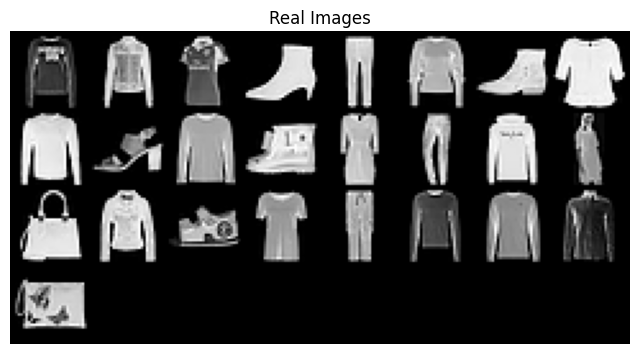

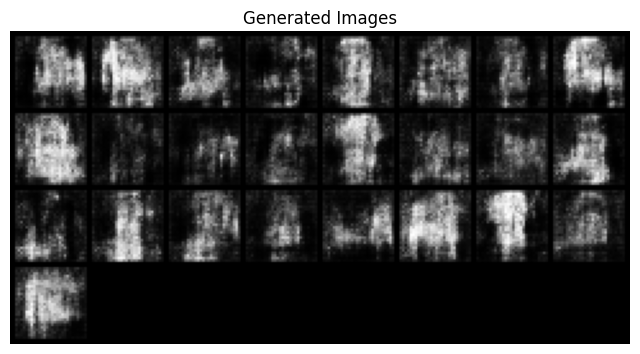

[Epoch 1/80] [Batch 0/469] [D loss: 1.5455896854400635] [G loss: 0.46881812810897827] [D Acc: 0.39453125]
[Epoch 1/80] [Batch 100/469] [D loss: 1.5259298086166382] [G loss: 0.4885838031768799] [D Acc: 0.69921875]
[Epoch 1/80] [Batch 200/469] [D loss: 1.443047285079956] [G loss: 0.5086839199066162] [D Acc: 0.82421875]
[Epoch 1/80] [Batch 300/469] [D loss: 1.3679333925247192] [G loss: 0.5425997972488403] [D Acc: 0.9296875]
[Epoch 1/80] [Batch 400/469] [D loss: 1.392838954925537] [G loss: 0.5519183874130249] [D Acc: 0.953125]


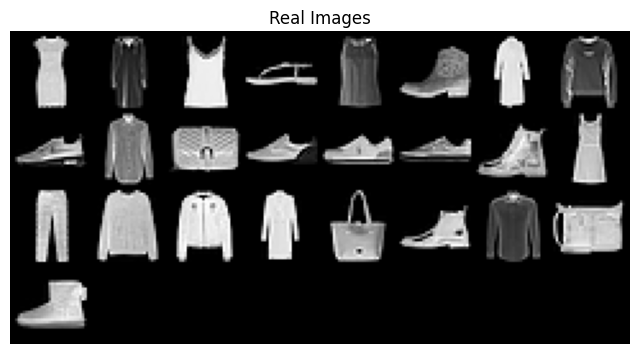

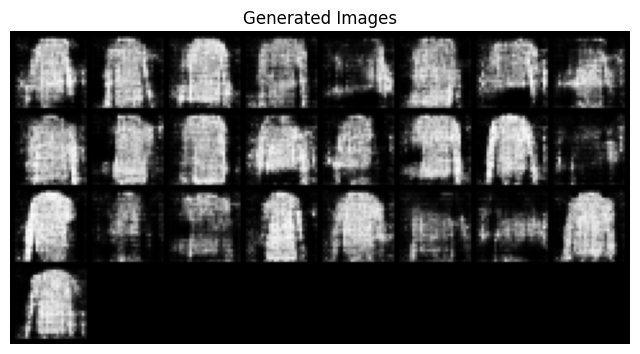

[Epoch 2/80] [Batch 0/469] [D loss: 1.3202065229415894] [G loss: 0.5854207277297974] [D Acc: 0.98828125]
[Epoch 2/80] [Batch 100/469] [D loss: 1.346104383468628] [G loss: 0.5658721923828125] [D Acc: 0.953125]
[Epoch 2/80] [Batch 200/469] [D loss: 1.3543782234191895] [G loss: 0.5135894417762756] [D Acc: 0.8515625]
[Epoch 2/80] [Batch 300/469] [D loss: 1.392942190170288] [G loss: 0.5210265517234802] [D Acc: 0.80078125]
[Epoch 2/80] [Batch 400/469] [D loss: 1.455845832824707] [G loss: 0.49864888191223145] [D Acc: 0.73828125]


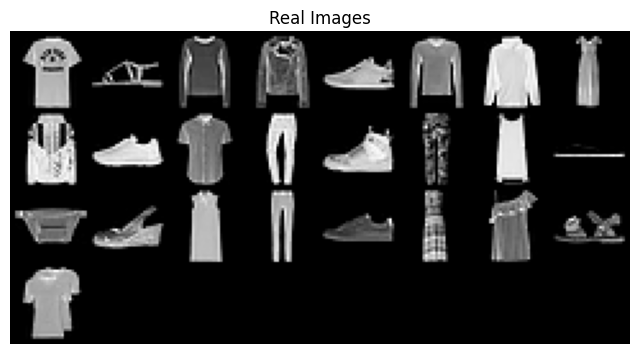

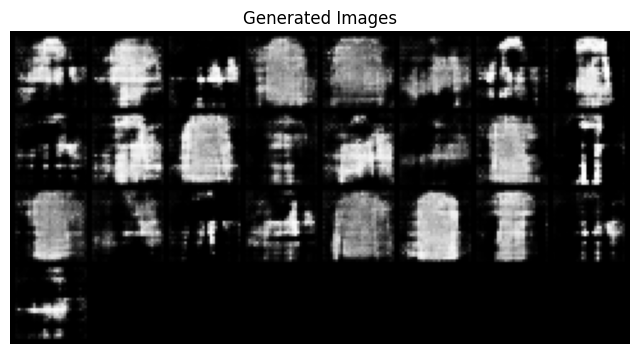

[Epoch 3/80] [Batch 0/469] [D loss: 1.3905189037322998] [G loss: 0.5920844078063965] [D Acc: 0.9375]
[Epoch 3/80] [Batch 100/469] [D loss: 1.5203297138214111] [G loss: 0.39972299337387085] [D Acc: 0.53515625]
[Epoch 3/80] [Batch 200/469] [D loss: 1.4096776247024536] [G loss: 0.5206258296966553] [D Acc: 0.71484375]
[Epoch 3/80] [Batch 300/469] [D loss: 1.4665377140045166] [G loss: 0.520363450050354] [D Acc: 0.85546875]
[Epoch 3/80] [Batch 400/469] [D loss: 1.4010788202285767] [G loss: 0.5518822073936462] [D Acc: 0.7578125]


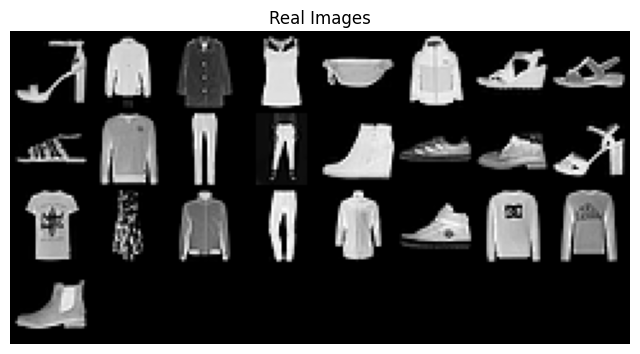

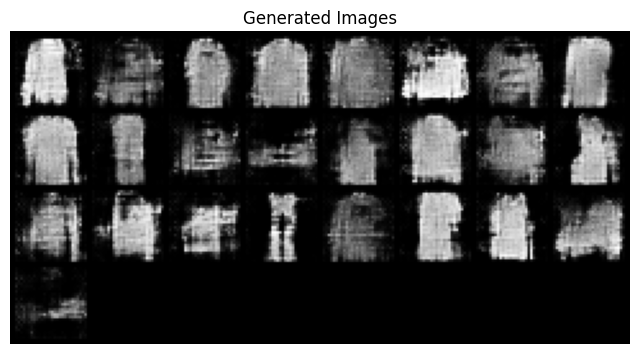

[Epoch 4/80] [Batch 0/469] [D loss: 1.3895888328552246] [G loss: 0.517535924911499] [D Acc: 0.80859375]
[Epoch 4/80] [Batch 100/469] [D loss: 1.3669592142105103] [G loss: 0.494887113571167] [D Acc: 0.7421875]
[Epoch 4/80] [Batch 200/469] [D loss: 1.4056587219238281] [G loss: 0.6185438632965088] [D Acc: 0.95703125]
[Epoch 4/80] [Batch 300/469] [D loss: 1.3702284097671509] [G loss: 0.5269993543624878] [D Acc: 0.86328125]
[Epoch 4/80] [Batch 400/469] [D loss: 1.3407803773880005] [G loss: 0.5374042391777039] [D Acc: 0.9140625]


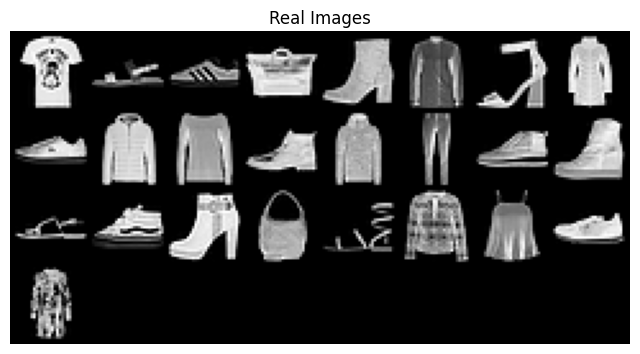

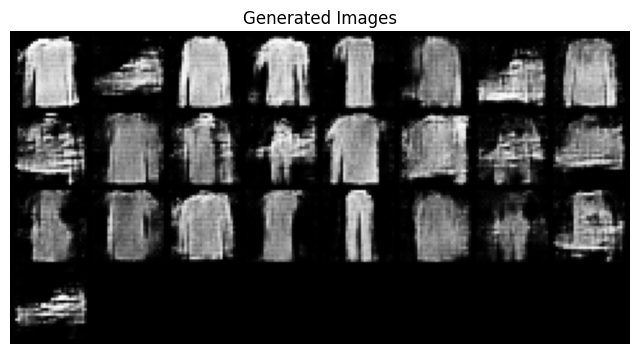

[Epoch 5/80] [Batch 0/469] [D loss: 1.53131103515625] [G loss: 0.45895522832870483] [D Acc: 0.54296875]
[Epoch 5/80] [Batch 100/469] [D loss: 1.3884869813919067] [G loss: 0.5230557918548584] [D Acc: 0.80859375]
[Epoch 5/80] [Batch 200/469] [D loss: 1.388685941696167] [G loss: 0.4806109666824341] [D Acc: 0.70703125]
[Epoch 5/80] [Batch 300/469] [D loss: 1.6582584381103516] [G loss: 0.4803318381309509] [D Acc: 0.3046875]
[Epoch 5/80] [Batch 400/469] [D loss: 1.4923490285873413] [G loss: 0.4422178864479065] [D Acc: 0.609375]


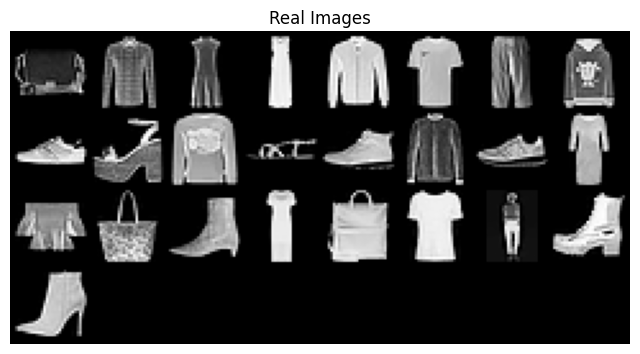

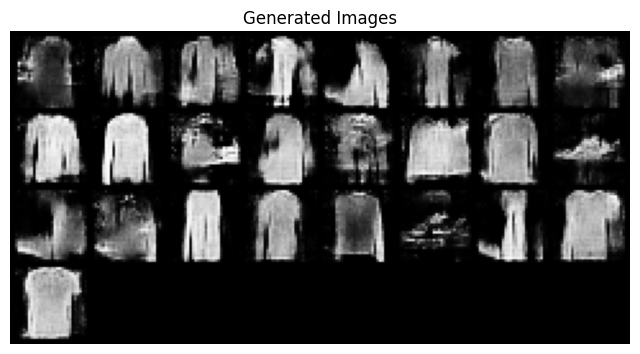

[Epoch 6/80] [Batch 0/469] [D loss: 1.3764641284942627] [G loss: 0.5139353275299072] [D Acc: 0.81640625]
[Epoch 6/80] [Batch 100/469] [D loss: 1.7093794345855713] [G loss: 0.39936327934265137] [D Acc: 0.2578125]
[Epoch 6/80] [Batch 200/469] [D loss: 1.5177416801452637] [G loss: 0.4480857849121094] [D Acc: 0.28515625]
[Epoch 6/80] [Batch 300/469] [D loss: 1.4116883277893066] [G loss: 0.4462885856628418] [D Acc: 0.5390625]
[Epoch 6/80] [Batch 400/469] [D loss: 1.4099847078323364] [G loss: 0.5288586616516113] [D Acc: 0.640625]


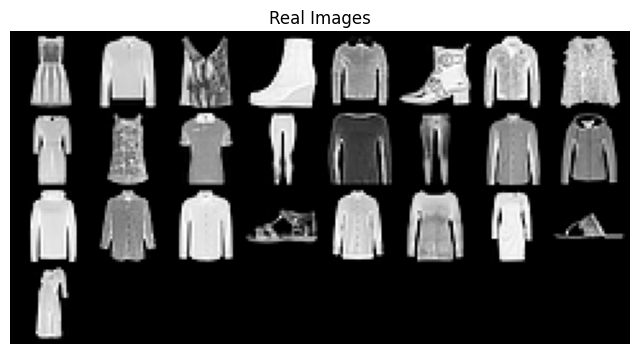

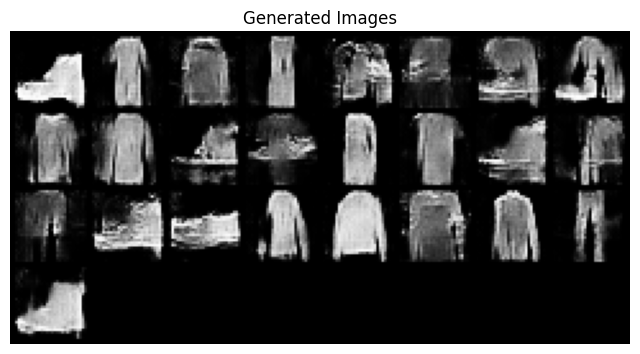

[Epoch 7/80] [Batch 0/469] [D loss: 1.3682234287261963] [G loss: 0.5328503847122192] [D Acc: 0.8203125]
[Epoch 7/80] [Batch 100/469] [D loss: 1.3792608976364136] [G loss: 0.5323941707611084] [D Acc: 0.76953125]
[Epoch 7/80] [Batch 200/469] [D loss: 1.4265321493148804] [G loss: 0.508274495601654] [D Acc: 0.78515625]
[Epoch 7/80] [Batch 300/469] [D loss: 1.341739296913147] [G loss: 0.5444234609603882] [D Acc: 0.87109375]
[Epoch 7/80] [Batch 400/469] [D loss: 1.4011812210083008] [G loss: 0.5469412207603455] [D Acc: 0.78515625]


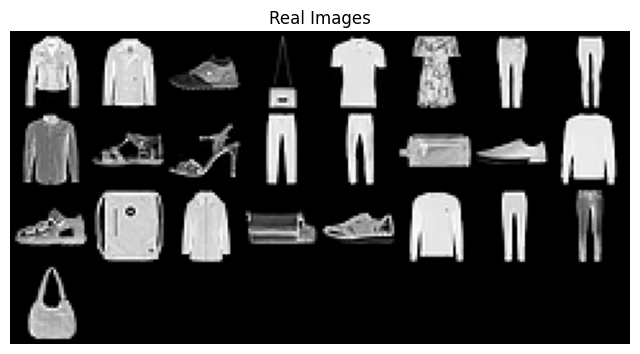

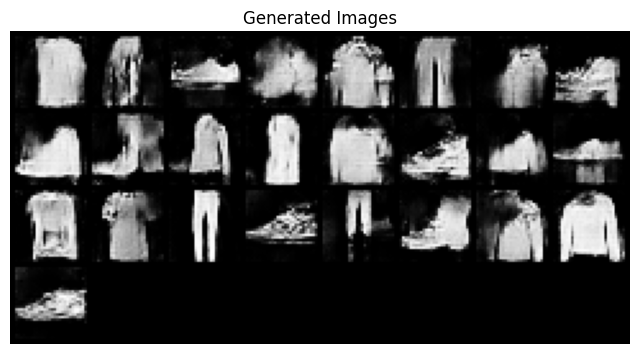

[Epoch 8/80] [Batch 0/469] [D loss: 1.3853015899658203] [G loss: 0.5448637008666992] [D Acc: 0.74609375]
[Epoch 8/80] [Batch 100/469] [D loss: 1.374900460243225] [G loss: 0.5485516786575317] [D Acc: 0.8125]
[Epoch 8/80] [Batch 200/469] [D loss: 1.3914331197738647] [G loss: 0.5638200640678406] [D Acc: 0.70703125]
[Epoch 8/80] [Batch 300/469] [D loss: 1.34507417678833] [G loss: 0.551825761795044] [D Acc: 0.88671875]
[Epoch 8/80] [Batch 400/469] [D loss: 1.5128507614135742] [G loss: 0.44720810651779175] [D Acc: 0.5859375]


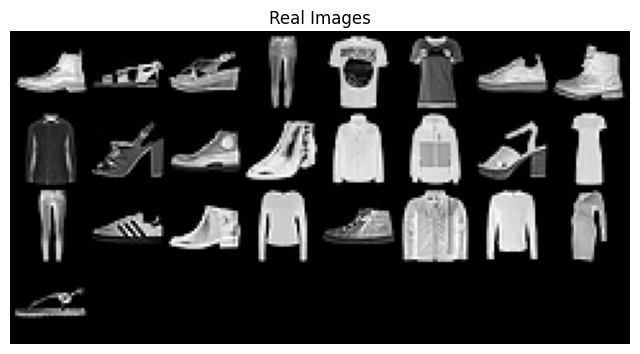

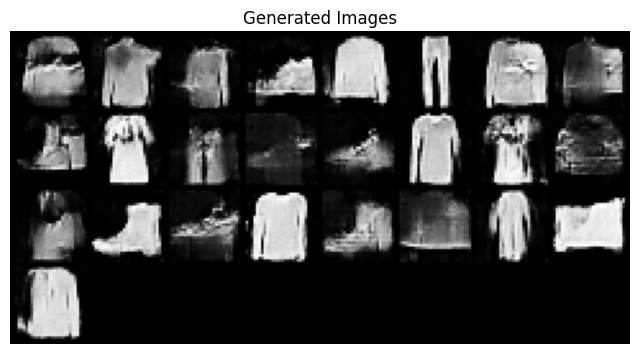

[Epoch 9/80] [Batch 0/469] [D loss: 1.486901879310608] [G loss: 0.4387098252773285] [D Acc: 0.6171875]
[Epoch 9/80] [Batch 100/469] [D loss: 1.3714358806610107] [G loss: 0.5461360216140747] [D Acc: 0.8125]
[Epoch 9/80] [Batch 200/469] [D loss: 1.36361825466156] [G loss: 0.507298469543457] [D Acc: 0.8125]
[Epoch 9/80] [Batch 300/469] [D loss: 1.3387478590011597] [G loss: 0.5627349019050598] [D Acc: 0.8671875]
[Epoch 9/80] [Batch 400/469] [D loss: 1.3809914588928223] [G loss: 0.5216987133026123] [D Acc: 0.875]


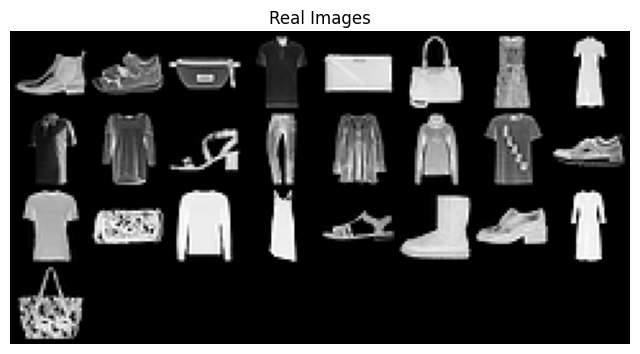

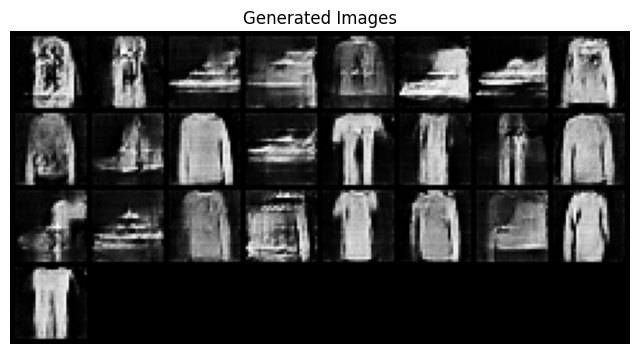

[Epoch 10/80] [Batch 0/469] [D loss: 1.4142125844955444] [G loss: 0.4919703006744385] [D Acc: 0.6875]
[Epoch 10/80] [Batch 100/469] [D loss: 1.45569908618927] [G loss: 0.5197806358337402] [D Acc: 0.54296875]
[Epoch 10/80] [Batch 200/469] [D loss: 2.2707533836364746] [G loss: 0.4698067605495453] [D Acc: 0.73046875]
[Epoch 10/80] [Batch 300/469] [D loss: 1.5867314338684082] [G loss: 0.4738057851791382] [D Acc: 0.703125]
[Epoch 10/80] [Batch 400/469] [D loss: 1.489961862564087] [G loss: 0.4788343012332916] [D Acc: 0.7265625]


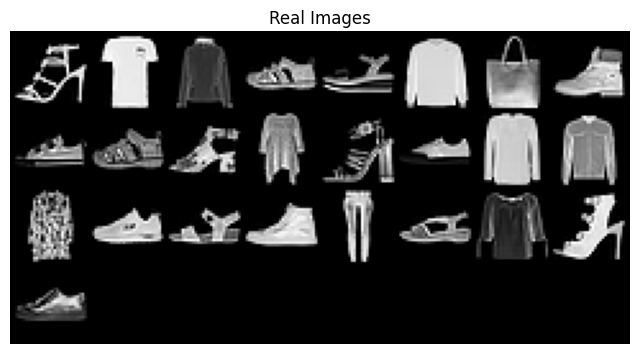

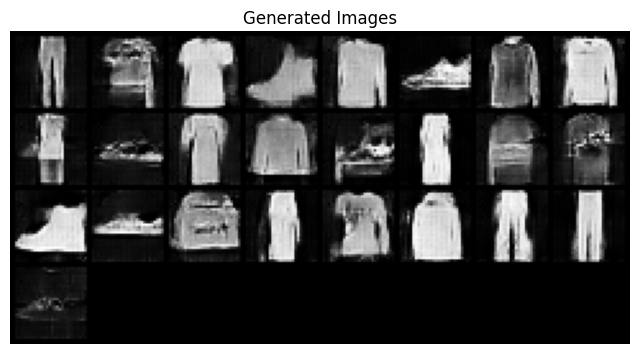

[Epoch 11/80] [Batch 0/469] [D loss: 1.4555737972259521] [G loss: 0.4882950782775879] [D Acc: 0.68359375]
[Epoch 11/80] [Batch 100/469] [D loss: 1.4135992527008057] [G loss: 0.5200068354606628] [D Acc: 0.69140625]
[Epoch 11/80] [Batch 200/469] [D loss: 1.3671998977661133] [G loss: 0.5477278828620911] [D Acc: 0.81640625]
[Epoch 11/80] [Batch 300/469] [D loss: 1.385200023651123] [G loss: 0.5340349674224854] [D Acc: 0.8671875]
[Epoch 11/80] [Batch 400/469] [D loss: 1.4578790664672852] [G loss: 0.4711705446243286] [D Acc: 0.73046875]


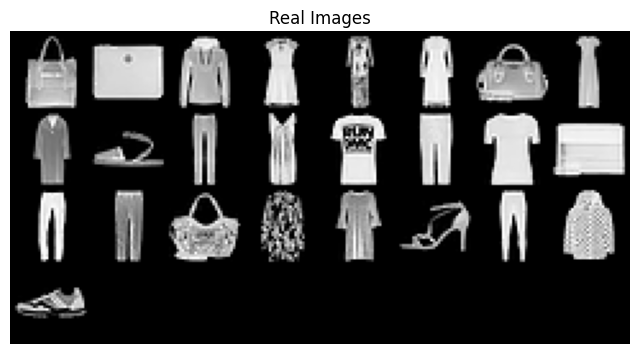

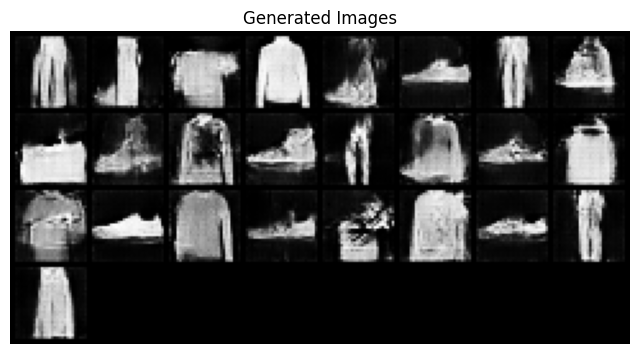

[Epoch 12/80] [Batch 0/469] [D loss: 1.4980612993240356] [G loss: 0.46327024698257446] [D Acc: 0.68359375]
[Epoch 12/80] [Batch 100/469] [D loss: 1.4191495180130005] [G loss: 0.4859614968299866] [D Acc: 0.6171875]
[Epoch 12/80] [Batch 200/469] [D loss: 1.4586471319198608] [G loss: 0.5125250816345215] [D Acc: 0.75390625]
[Epoch 12/80] [Batch 300/469] [D loss: 1.5465645790100098] [G loss: 0.4293301999568939] [D Acc: 0.57421875]
[Epoch 12/80] [Batch 400/469] [D loss: 1.4034837484359741] [G loss: 0.5153610706329346] [D Acc: 0.6171875]


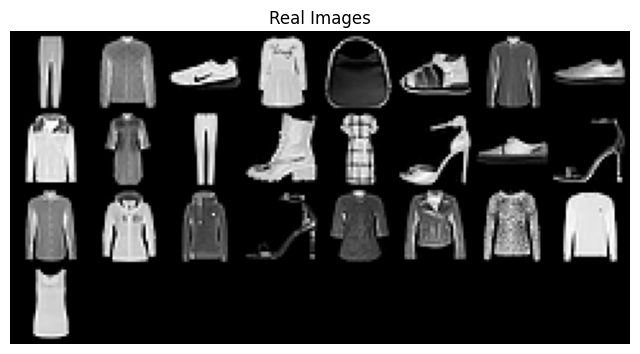

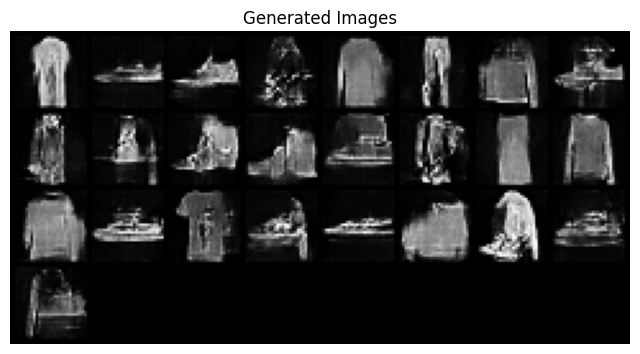

[Epoch 13/80] [Batch 0/469] [D loss: 1.6049091815948486] [G loss: 0.4839078485965729] [D Acc: 0.65234375]
[Epoch 13/80] [Batch 100/469] [D loss: 1.4519072771072388] [G loss: 0.5421638488769531] [D Acc: 0.58984375]
[Epoch 13/80] [Batch 200/469] [D loss: 1.4828630685806274] [G loss: 0.4315132200717926] [D Acc: 0.59765625]
[Epoch 13/80] [Batch 300/469] [D loss: 1.4807510375976562] [G loss: 0.529389500617981] [D Acc: 0.5859375]
[Epoch 13/80] [Batch 400/469] [D loss: 1.4026873111724854] [G loss: 0.5562372207641602] [D Acc: 0.7109375]


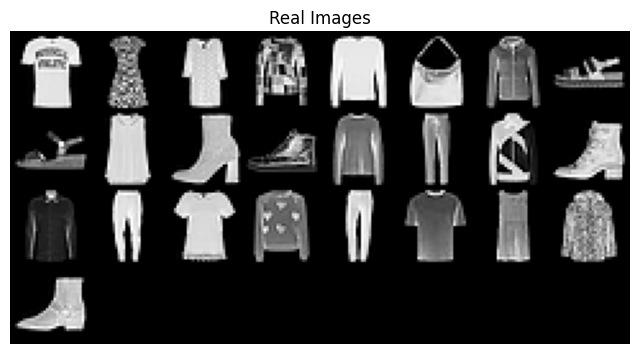

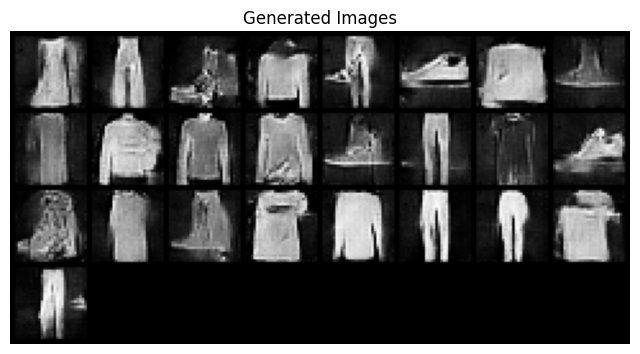

[Epoch 14/80] [Batch 0/469] [D loss: 1.3665401935577393] [G loss: 0.49993544816970825] [D Acc: 0.74609375]
[Epoch 14/80] [Batch 100/469] [D loss: 1.440845251083374] [G loss: 0.5411965847015381] [D Acc: 0.546875]
[Epoch 14/80] [Batch 200/469] [D loss: 1.5107395648956299] [G loss: 0.429449200630188] [D Acc: 0.57421875]
[Epoch 14/80] [Batch 300/469] [D loss: 1.529200553894043] [G loss: 0.45389947295188904] [D Acc: 0.54296875]
[Epoch 14/80] [Batch 400/469] [D loss: 1.3676223754882812] [G loss: 0.5378705859184265] [D Acc: 0.796875]


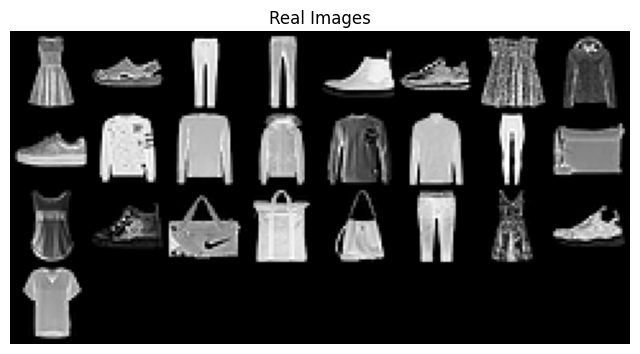

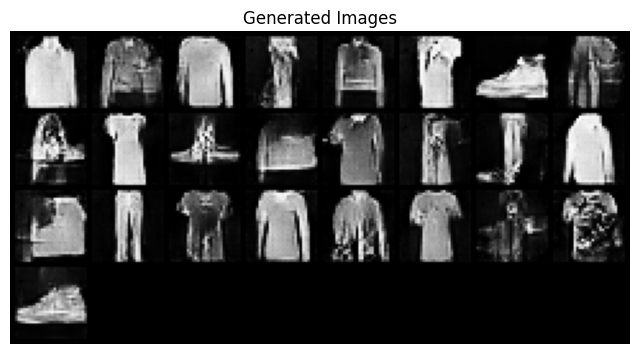

[Epoch 15/80] [Batch 0/469] [D loss: 1.460328221321106] [G loss: 0.5822713375091553] [D Acc: 0.640625]
[Epoch 15/80] [Batch 100/469] [D loss: 1.5077136754989624] [G loss: 0.5655326247215271] [D Acc: 0.87890625]
[Epoch 15/80] [Batch 200/469] [D loss: 1.3955684900283813] [G loss: 0.54961097240448] [D Acc: 0.625]
[Epoch 15/80] [Batch 300/469] [D loss: 1.2267193794250488] [G loss: 0.5152620673179626] [D Acc: 0.859375]
[Epoch 15/80] [Batch 400/469] [D loss: 1.4512933492660522] [G loss: 0.5076565742492676] [D Acc: 0.83984375]


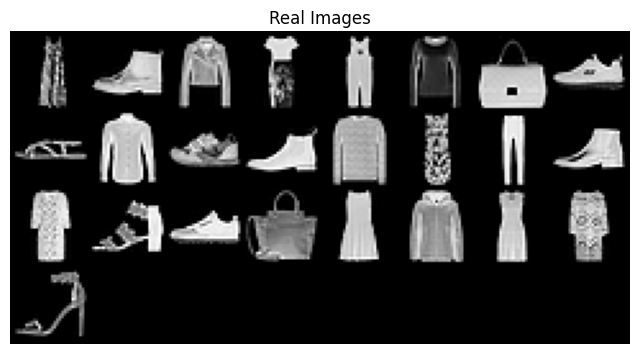

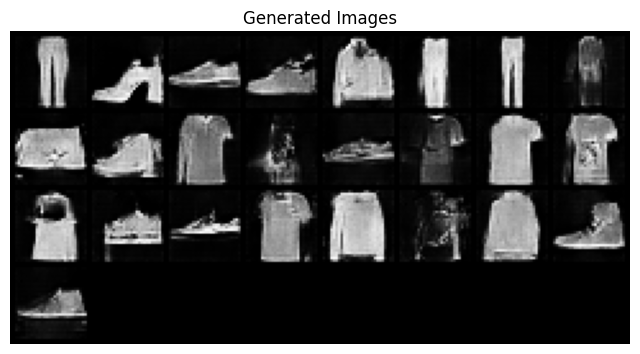

[Epoch 16/80] [Batch 0/469] [D loss: 1.4136559963226318] [G loss: 0.4925451874732971] [D Acc: 0.6015625]
[Epoch 16/80] [Batch 100/469] [D loss: 1.3970640897750854] [G loss: 0.5273211002349854] [D Acc: 0.796875]
[Epoch 16/80] [Batch 200/469] [D loss: 1.4267820119857788] [G loss: 0.570691704750061] [D Acc: 0.51171875]
[Epoch 16/80] [Batch 300/469] [D loss: 1.4301304817199707] [G loss: 0.5268503427505493] [D Acc: 0.85546875]
[Epoch 16/80] [Batch 400/469] [D loss: 1.4710609912872314] [G loss: 0.41388434171676636] [D Acc: 0.4296875]


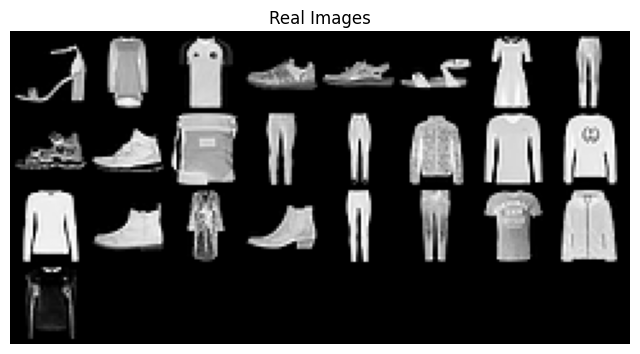

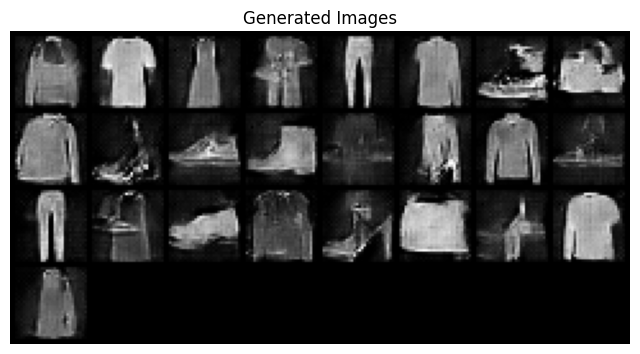

[Epoch 17/80] [Batch 0/469] [D loss: 1.3871192932128906] [G loss: 0.5442506074905396] [D Acc: 0.6640625]
[Epoch 17/80] [Batch 100/469] [D loss: 1.4018642902374268] [G loss: 0.5463735461235046] [D Acc: 0.921875]
[Epoch 17/80] [Batch 200/469] [D loss: 1.4148893356323242] [G loss: 0.5673103332519531] [D Acc: 0.65625]
[Epoch 17/80] [Batch 300/469] [D loss: 1.406109094619751] [G loss: 0.5631964802742004] [D Acc: 0.7578125]
[Epoch 17/80] [Batch 400/469] [D loss: 1.421221137046814] [G loss: 0.558916449546814] [D Acc: 0.64453125]


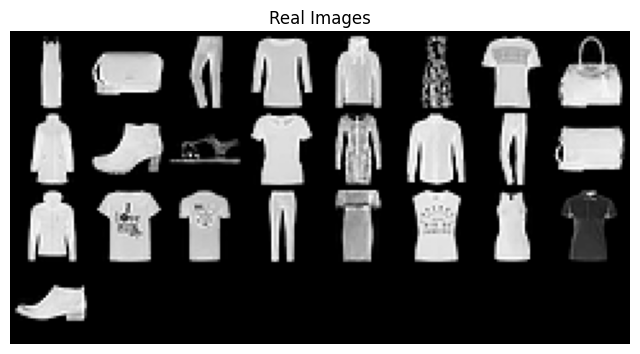

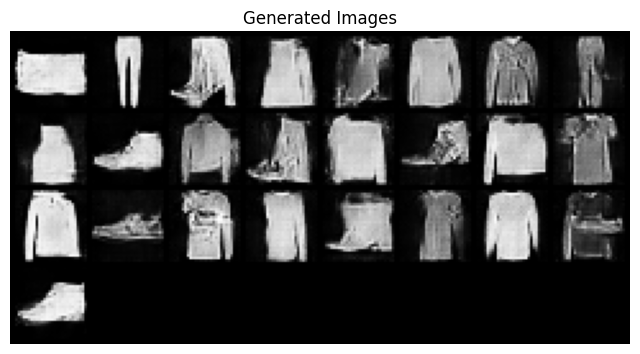

[Epoch 18/80] [Batch 0/469] [D loss: 1.4774625301361084] [G loss: 0.41854190826416016] [D Acc: 0.44921875]
[Epoch 18/80] [Batch 100/469] [D loss: 1.4098825454711914] [G loss: 0.5679159164428711] [D Acc: 0.625]
[Epoch 18/80] [Batch 200/469] [D loss: 1.4651999473571777] [G loss: 0.5173060894012451] [D Acc: 0.53125]
[Epoch 18/80] [Batch 300/469] [D loss: 1.4280204772949219] [G loss: 0.54196697473526] [D Acc: 0.5859375]
[Epoch 18/80] [Batch 400/469] [D loss: 1.418958067893982] [G loss: 0.4460446834564209] [D Acc: 0.59375]


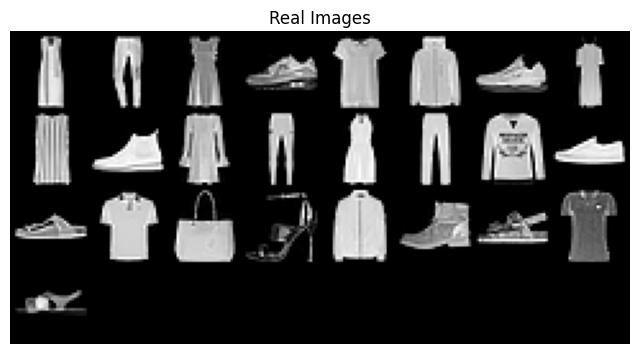

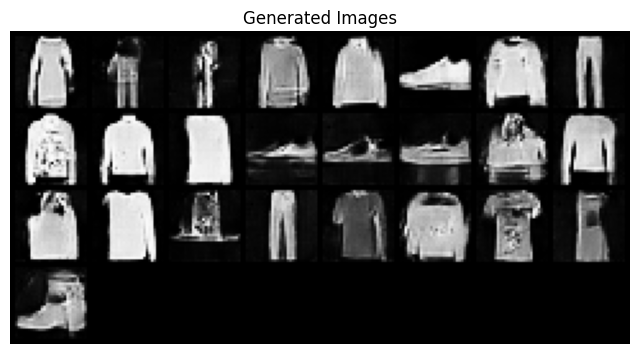

[Epoch 19/80] [Batch 0/469] [D loss: 1.5960745811462402] [G loss: 0.6041104197502136] [D Acc: 0.859375]
[Epoch 19/80] [Batch 100/469] [D loss: 1.4655349254608154] [G loss: 0.45195358991622925] [D Acc: 0.61328125]
[Epoch 19/80] [Batch 200/469] [D loss: 1.4974157810211182] [G loss: 0.47390252351760864] [D Acc: 0.60546875]
[Epoch 19/80] [Batch 300/469] [D loss: 1.4314427375793457] [G loss: 0.5437250733375549] [D Acc: 0.73046875]
[Epoch 19/80] [Batch 400/469] [D loss: 1.4185187816619873] [G loss: 0.47878697514533997] [D Acc: 0.65625]


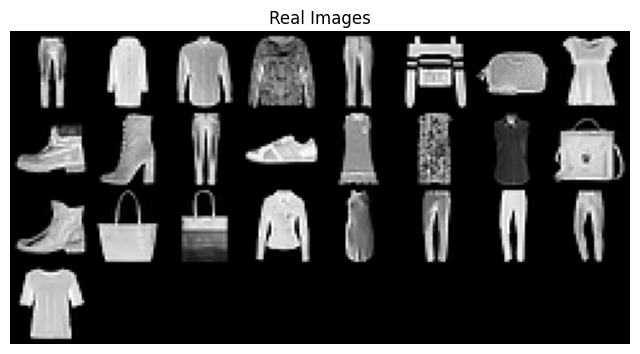

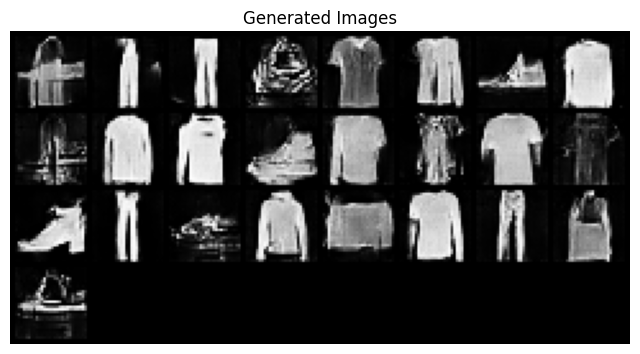

[Epoch 20/80] [Batch 0/469] [D loss: 1.4588991403579712] [G loss: 0.4704797565937042] [D Acc: 0.62109375]
[Epoch 20/80] [Batch 100/469] [D loss: 1.5454633235931396] [G loss: 0.5052536129951477] [D Acc: 0.78125]
[Epoch 20/80] [Batch 200/469] [D loss: 1.4692002534866333] [G loss: 0.5031816363334656] [D Acc: 0.55859375]
[Epoch 20/80] [Batch 300/469] [D loss: 1.3913277387619019] [G loss: 0.5856204032897949] [D Acc: 0.8125]
[Epoch 20/80] [Batch 400/469] [D loss: 1.393066644668579] [G loss: 0.5393085479736328] [D Acc: 0.66015625]


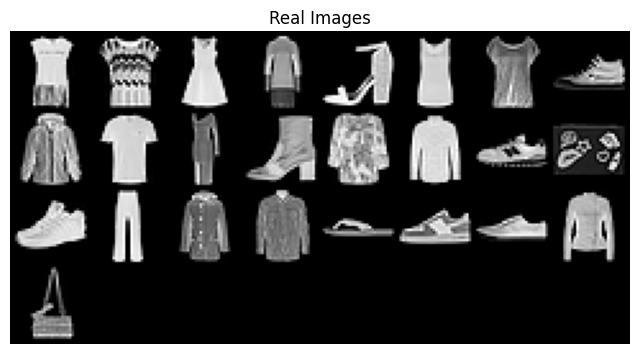

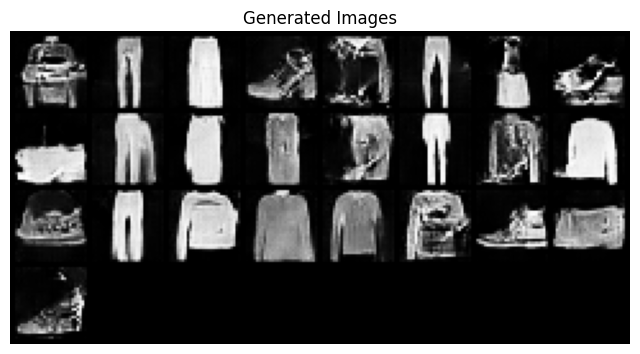

[Epoch 21/80] [Batch 0/469] [D loss: 1.4225709438323975] [G loss: 0.46463191509246826] [D Acc: 0.46484375]
[Epoch 21/80] [Batch 100/469] [D loss: 1.4274961948394775] [G loss: 0.5293636918067932] [D Acc: 0.7578125]
[Epoch 21/80] [Batch 200/469] [D loss: 1.467912197113037] [G loss: 0.5034008622169495] [D Acc: 0.50390625]
[Epoch 21/80] [Batch 300/469] [D loss: 1.457156777381897] [G loss: 0.4832143485546112] [D Acc: 0.75390625]
[Epoch 21/80] [Batch 400/469] [D loss: 1.4620091915130615] [G loss: 0.5446905493736267] [D Acc: 0.67578125]


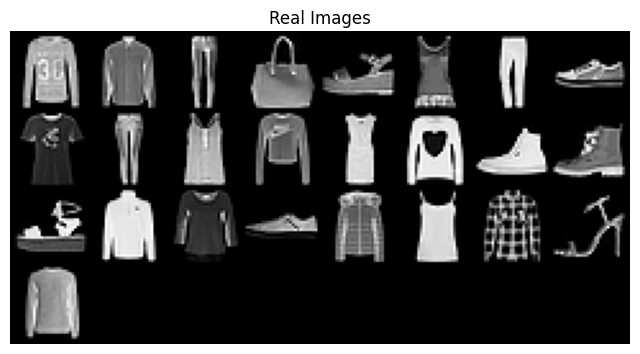

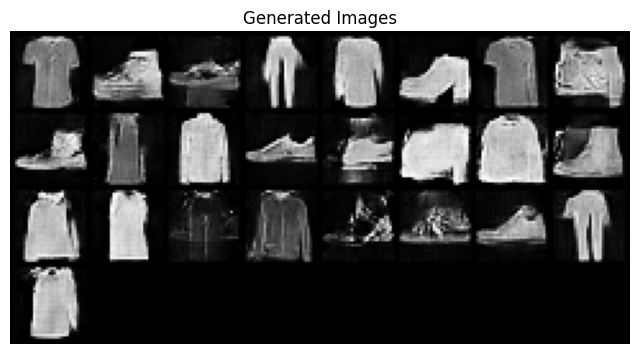

[Epoch 22/80] [Batch 0/469] [D loss: 1.4420864582061768] [G loss: 0.5282674431800842] [D Acc: 0.6875]
[Epoch 22/80] [Batch 100/469] [D loss: 1.4039572477340698] [G loss: 0.5832757949829102] [D Acc: 0.5859375]
[Epoch 22/80] [Batch 200/469] [D loss: 1.423154592514038] [G loss: 0.5091724395751953] [D Acc: 0.765625]
[Epoch 22/80] [Batch 300/469] [D loss: 1.5138002634048462] [G loss: 0.42142775654792786] [D Acc: 0.609375]
[Epoch 22/80] [Batch 400/469] [D loss: 1.3846683502197266] [G loss: 0.5195358991622925] [D Acc: 0.734375]


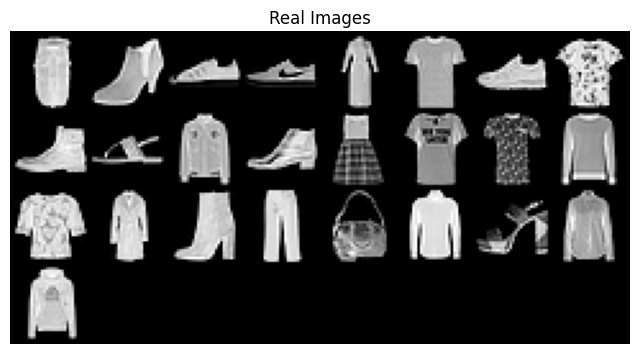

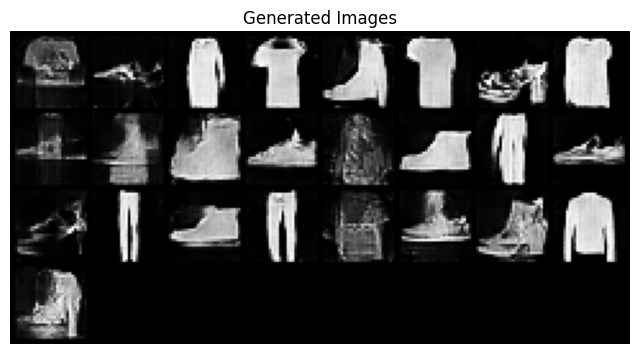

[Epoch 23/80] [Batch 0/469] [D loss: 1.4327571392059326] [G loss: 0.5664987564086914] [D Acc: 0.54296875]
[Epoch 23/80] [Batch 100/469] [D loss: 1.3954429626464844] [G loss: 0.5775172710418701] [D Acc: 0.5390625]
[Epoch 23/80] [Batch 200/469] [D loss: 1.3934669494628906] [G loss: 0.5528703927993774] [D Acc: 0.70703125]
[Epoch 23/80] [Batch 300/469] [D loss: 1.4073251485824585] [G loss: 0.5406619310379028] [D Acc: 0.66796875]
[Epoch 23/80] [Batch 400/469] [D loss: 1.4066145420074463] [G loss: 0.5378801226615906] [D Acc: 0.640625]


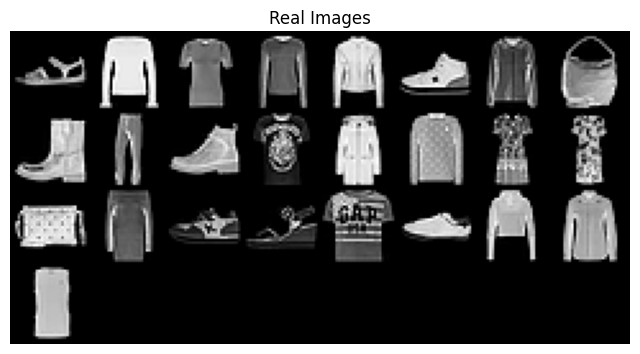

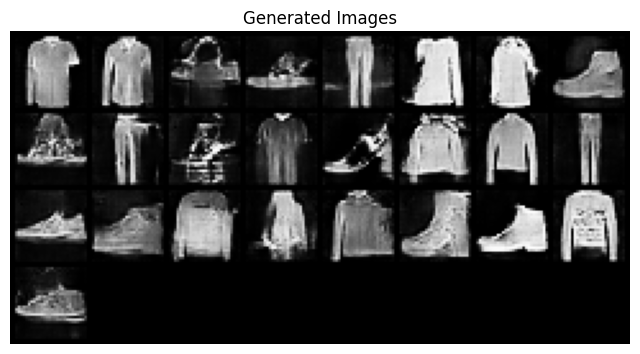

[Epoch 24/80] [Batch 0/469] [D loss: 1.4292352199554443] [G loss: 0.4878923296928406] [D Acc: 0.76953125]
[Epoch 24/80] [Batch 100/469] [D loss: 1.41444993019104] [G loss: 0.6152770519256592] [D Acc: 0.61328125]
[Epoch 24/80] [Batch 200/469] [D loss: 1.3997693061828613] [G loss: 0.5340408086776733] [D Acc: 0.73828125]
[Epoch 24/80] [Batch 300/469] [D loss: 1.4509819746017456] [G loss: 0.5755364894866943] [D Acc: 0.515625]
[Epoch 24/80] [Batch 400/469] [D loss: 1.405121088027954] [G loss: 0.5047795176506042] [D Acc: 0.81640625]


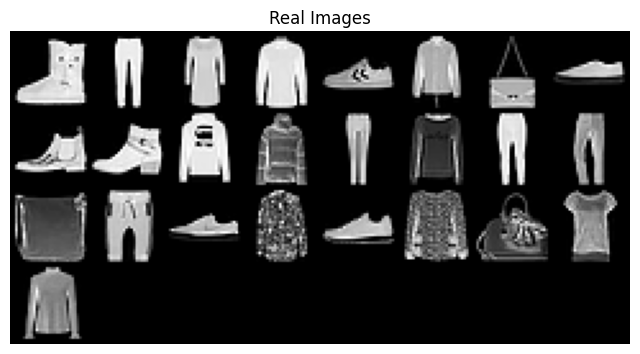

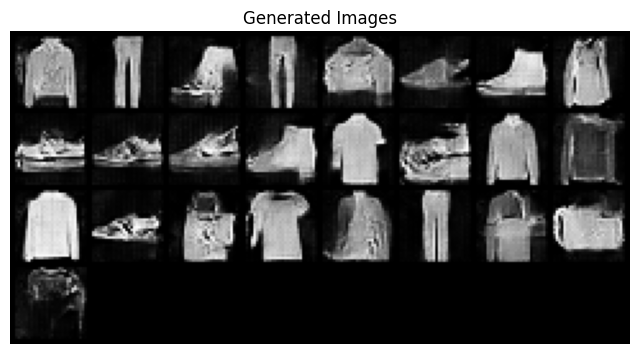

[Epoch 25/80] [Batch 0/469] [D loss: 1.472646951675415] [G loss: 0.5257018804550171] [D Acc: 0.45703125]
[Epoch 25/80] [Batch 100/469] [D loss: 1.471309781074524] [G loss: 0.535742998123169] [D Acc: 0.89453125]
[Epoch 25/80] [Batch 200/469] [D loss: 1.500519871711731] [G loss: 0.4842713475227356] [D Acc: 0.6796875]
[Epoch 25/80] [Batch 300/469] [D loss: 1.4382232427597046] [G loss: 0.5397850871086121] [D Acc: 0.48046875]
[Epoch 25/80] [Batch 400/469] [D loss: 1.3921468257904053] [G loss: 0.567021369934082] [D Acc: 0.68359375]


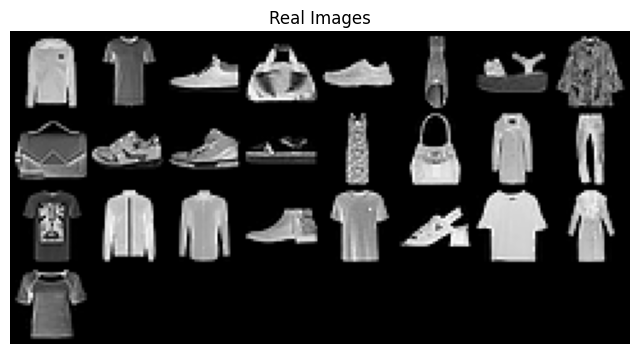

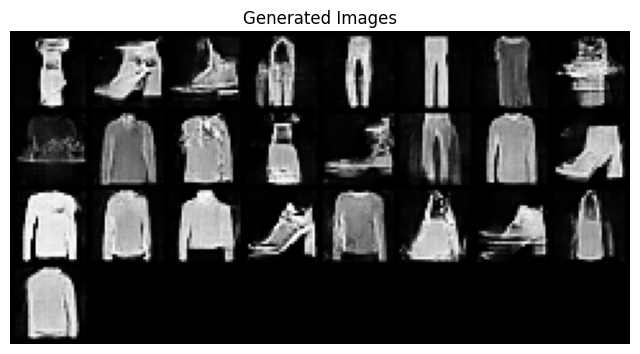

[Epoch 26/80] [Batch 0/469] [D loss: 1.5084376335144043] [G loss: 0.46583256125450134] [D Acc: 0.35546875]
[Epoch 26/80] [Batch 100/469] [D loss: 1.414280891418457] [G loss: 0.5542442798614502] [D Acc: 0.8203125]
[Epoch 26/80] [Batch 200/469] [D loss: 1.4049512147903442] [G loss: 0.6206480860710144] [D Acc: 0.5234375]
[Epoch 26/80] [Batch 300/469] [D loss: 1.3911638259887695] [G loss: 0.621293306350708] [D Acc: 0.53515625]
[Epoch 26/80] [Batch 400/469] [D loss: 1.3835346698760986] [G loss: 0.42824268341064453] [D Acc: 0.625]


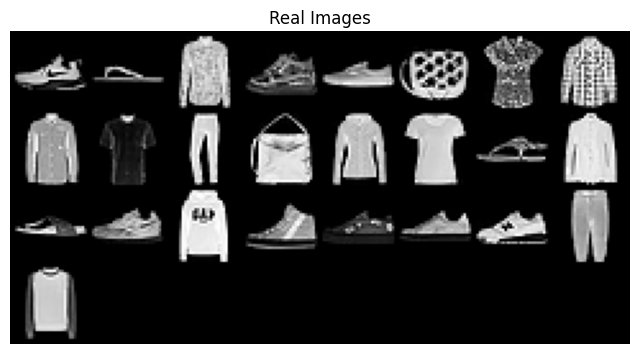

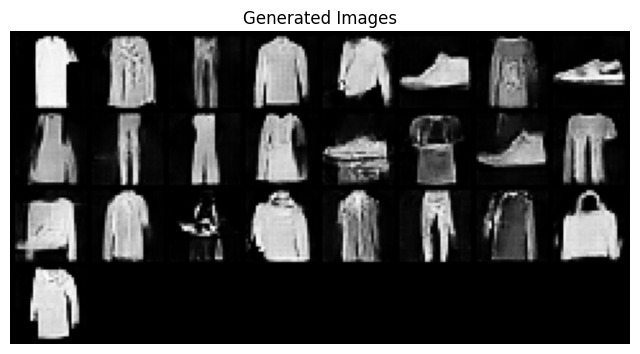

[Epoch 27/80] [Batch 0/469] [D loss: 1.3711751699447632] [G loss: 0.5541529059410095] [D Acc: 0.67578125]
[Epoch 27/80] [Batch 100/469] [D loss: 1.3905774354934692] [G loss: 0.554378867149353] [D Acc: 0.66015625]
[Epoch 27/80] [Batch 200/469] [D loss: 1.4499694108963013] [G loss: 0.47842520475387573] [D Acc: 0.7734375]
[Epoch 27/80] [Batch 300/469] [D loss: 1.4125707149505615] [G loss: 0.5874517560005188] [D Acc: 0.87890625]
[Epoch 27/80] [Batch 400/469] [D loss: 1.4010848999023438] [G loss: 0.5312317609786987] [D Acc: 0.73828125]


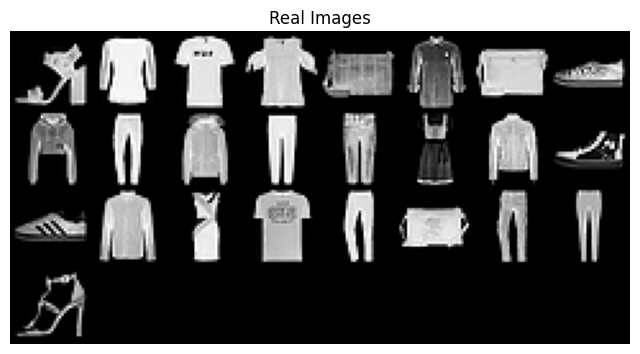

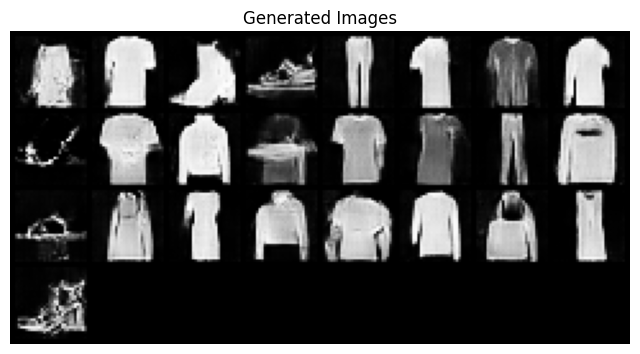

[Epoch 28/80] [Batch 0/469] [D loss: 1.4603207111358643] [G loss: 0.48938488960266113] [D Acc: 0.37109375]
[Epoch 28/80] [Batch 100/469] [D loss: 1.4266784191131592] [G loss: 0.5741853713989258] [D Acc: 0.5546875]
[Epoch 28/80] [Batch 200/469] [D loss: 1.4090328216552734] [G loss: 0.4914019703865051] [D Acc: 0.73828125]
[Epoch 28/80] [Batch 300/469] [D loss: 1.3562977313995361] [G loss: 0.5529497861862183] [D Acc: 0.6171875]
[Epoch 28/80] [Batch 400/469] [D loss: 1.3693959712982178] [G loss: 0.6055682301521301] [D Acc: 0.6640625]


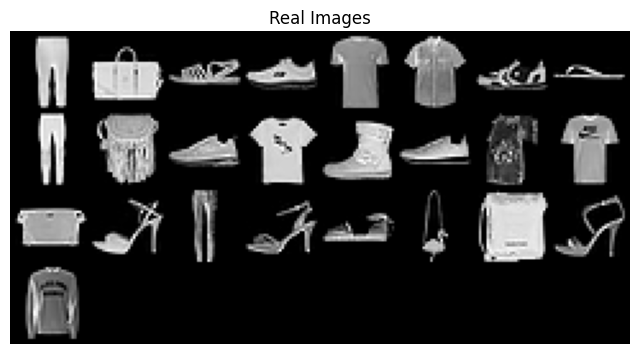

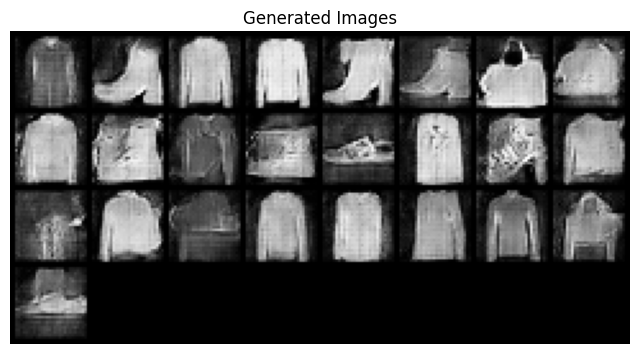

[Epoch 29/80] [Batch 0/469] [D loss: 1.3187650442123413] [G loss: 0.5693338513374329] [D Acc: 0.953125]
[Epoch 29/80] [Batch 100/469] [D loss: 1.453673243522644] [G loss: 0.45116034150123596] [D Acc: 0.6640625]
[Epoch 29/80] [Batch 200/469] [D loss: 1.3133183717727661] [G loss: 0.5491188764572144] [D Acc: 0.953125]
[Epoch 29/80] [Batch 300/469] [D loss: 1.314269781112671] [G loss: 0.56122887134552] [D Acc: 0.9375]
[Epoch 29/80] [Batch 400/469] [D loss: 1.424797773361206] [G loss: 0.5038222074508667] [D Acc: 0.4453125]


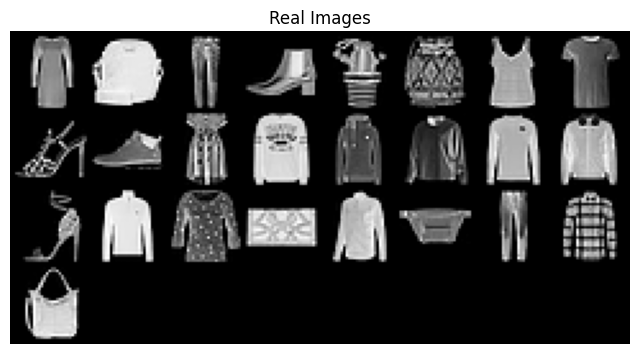

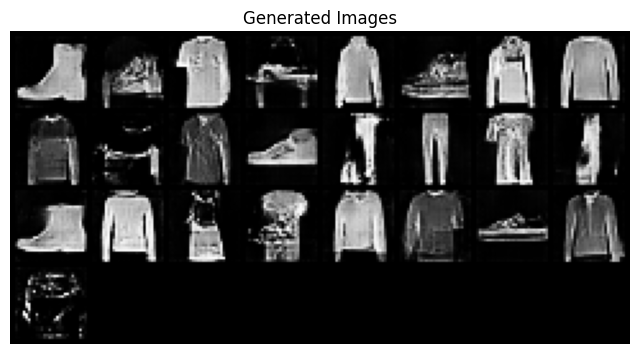

[Epoch 30/80] [Batch 0/469] [D loss: 1.5090117454528809] [G loss: 0.4387609660625458] [D Acc: 0.5390625]
[Epoch 30/80] [Batch 100/469] [D loss: 1.3740450143814087] [G loss: 0.552773118019104] [D Acc: 0.6640625]
[Epoch 30/80] [Batch 200/469] [D loss: 1.3953086137771606] [G loss: 0.5804034471511841] [D Acc: 0.5546875]
[Epoch 30/80] [Batch 300/469] [D loss: 1.4814317226409912] [G loss: 0.518862247467041] [D Acc: 0.46875]
[Epoch 30/80] [Batch 400/469] [D loss: 1.4446251392364502] [G loss: 0.5212199687957764] [D Acc: 0.7265625]


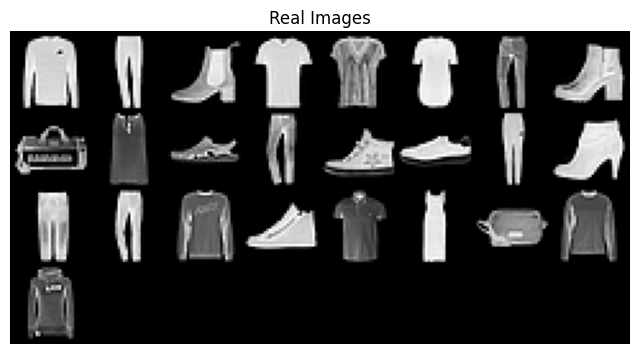

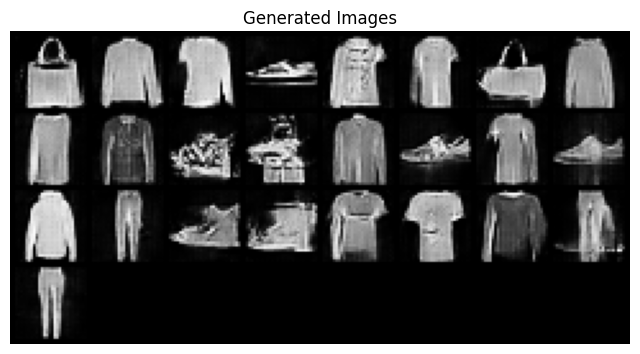

[Epoch 31/80] [Batch 0/469] [D loss: 1.4419206380844116] [G loss: 0.5705592632293701] [D Acc: 0.55078125]
[Epoch 31/80] [Batch 100/469] [D loss: 1.3104393482208252] [G loss: 0.5636264085769653] [D Acc: 0.9375]
[Epoch 31/80] [Batch 200/469] [D loss: 1.6740367412567139] [G loss: 0.5557467937469482] [D Acc: 0.828125]
[Epoch 31/80] [Batch 300/469] [D loss: 1.4009543657302856] [G loss: 0.5898019075393677] [D Acc: 0.578125]
[Epoch 31/80] [Batch 400/469] [D loss: 1.5257346630096436] [G loss: 0.5502398014068604] [D Acc: 0.80078125]


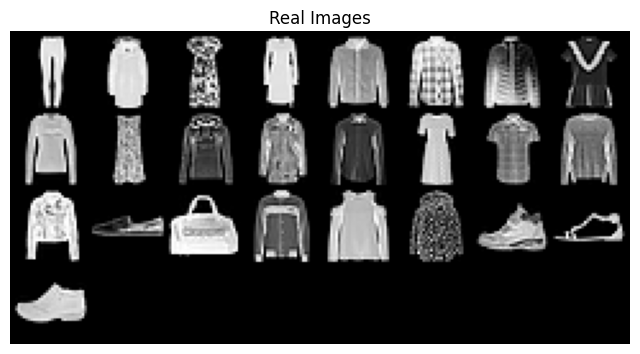

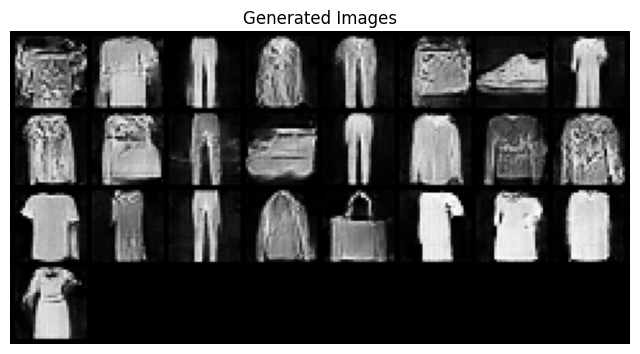

[Epoch 32/80] [Batch 0/469] [D loss: 1.4152553081512451] [G loss: 0.5156424045562744] [D Acc: 0.8515625]
[Epoch 32/80] [Batch 100/469] [D loss: 1.336355447769165] [G loss: 0.6163160800933838] [D Acc: 0.8984375]
[Epoch 32/80] [Batch 200/469] [D loss: 1.4074162244796753] [G loss: 0.6052631139755249] [D Acc: 0.67578125]
[Epoch 32/80] [Batch 300/469] [D loss: 1.4079593420028687] [G loss: 0.5887743830680847] [D Acc: 0.5625]
[Epoch 32/80] [Batch 400/469] [D loss: 1.3640352487564087] [G loss: 0.5551563501358032] [D Acc: 0.78125]


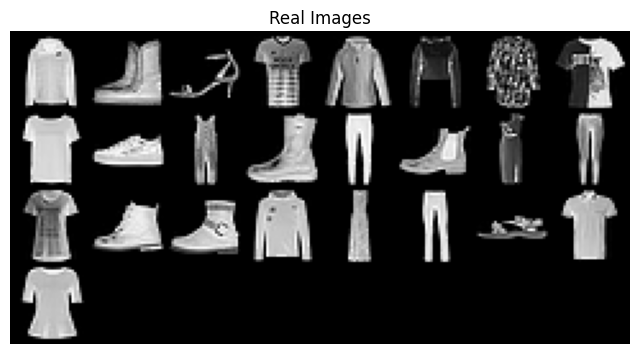

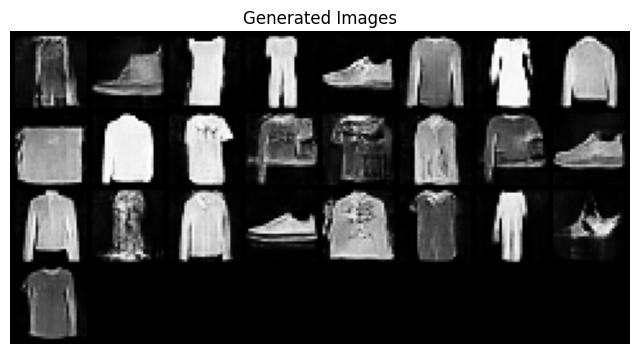

[Epoch 33/80] [Batch 0/469] [D loss: 1.437635898590088] [G loss: 0.617630660533905] [D Acc: 0.5078125]
[Epoch 33/80] [Batch 100/469] [D loss: 1.5132418870925903] [G loss: 0.5381722450256348] [D Acc: 0.44140625]
[Epoch 33/80] [Batch 200/469] [D loss: 1.3826524019241333] [G loss: 0.46263739466667175] [D Acc: 0.69140625]
[Epoch 33/80] [Batch 300/469] [D loss: 1.4800182580947876] [G loss: 0.4248635172843933] [D Acc: 0.546875]
[Epoch 33/80] [Batch 400/469] [D loss: 1.5000284910202026] [G loss: 0.4726470708847046] [D Acc: 0.62109375]


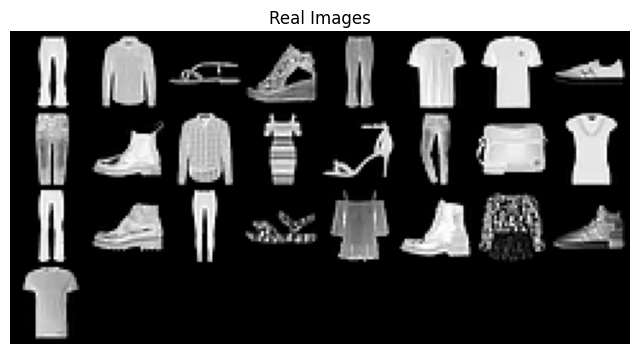

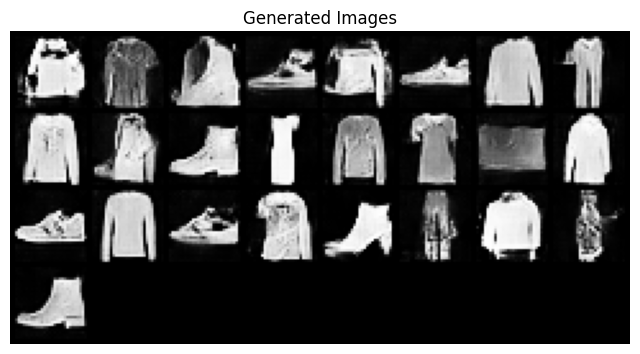

[Epoch 34/80] [Batch 0/469] [D loss: 1.3945878744125366] [G loss: 0.5878188610076904] [D Acc: 0.5703125]
[Epoch 34/80] [Batch 100/469] [D loss: 1.4027618169784546] [G loss: 0.5746487379074097] [D Acc: 0.58203125]
[Epoch 34/80] [Batch 200/469] [D loss: 1.4399603605270386] [G loss: 0.472431480884552] [D Acc: 0.6875]
[Epoch 34/80] [Batch 300/469] [D loss: 1.4193992614746094] [G loss: 0.5175406336784363] [D Acc: 0.78515625]
[Epoch 34/80] [Batch 400/469] [D loss: 1.6052844524383545] [G loss: 0.47791141271591187] [D Acc: 0.6640625]


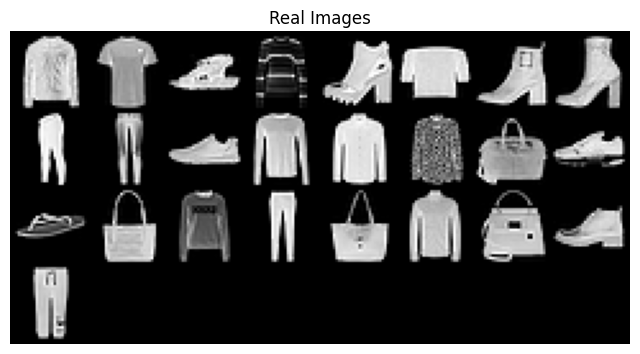

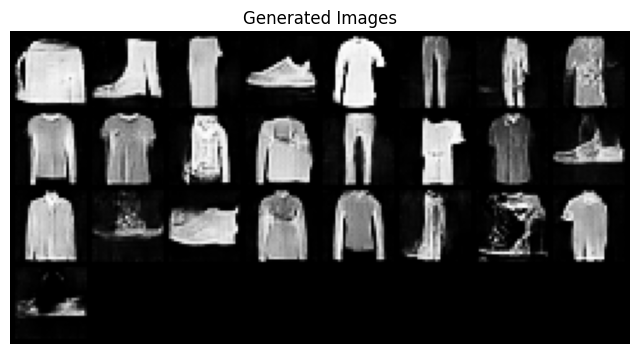

[Epoch 35/80] [Batch 0/469] [D loss: 1.3953324556350708] [G loss: 0.557231068611145] [D Acc: 0.6484375]
[Epoch 35/80] [Batch 100/469] [D loss: 1.3723965883255005] [G loss: 0.5871634483337402] [D Acc: 0.59765625]
[Epoch 35/80] [Batch 200/469] [D loss: 1.400124192237854] [G loss: 0.43823903799057007] [D Acc: 0.6171875]
[Epoch 35/80] [Batch 300/469] [D loss: 1.4043092727661133] [G loss: 0.59212327003479] [D Acc: 0.55859375]
[Epoch 35/80] [Batch 400/469] [D loss: 1.3954285383224487] [G loss: 0.6249097585678101] [D Acc: 0.5546875]


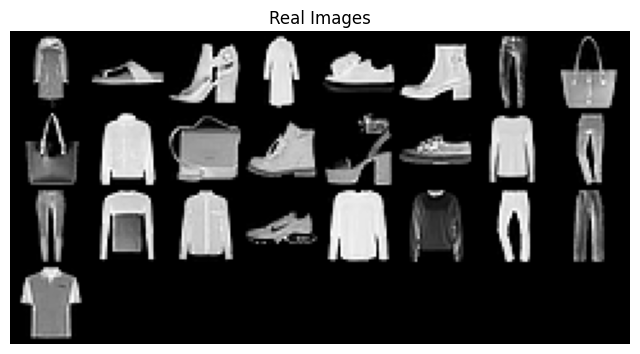

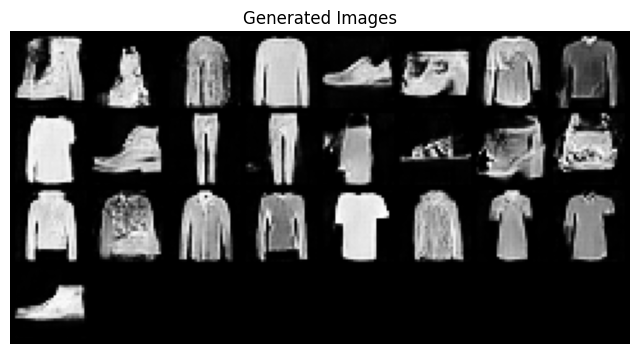

[Epoch 36/80] [Batch 0/469] [D loss: 1.3869006633758545] [G loss: 0.6127092838287354] [D Acc: 0.5234375]
[Epoch 36/80] [Batch 100/469] [D loss: 1.3460021018981934] [G loss: 0.5545471906661987] [D Acc: 0.8125]
[Epoch 36/80] [Batch 200/469] [D loss: 1.3917664289474487] [G loss: 0.521516740322113] [D Acc: 0.8203125]
[Epoch 36/80] [Batch 300/469] [D loss: 1.3967310190200806] [G loss: 0.5503472685813904] [D Acc: 0.55078125]
[Epoch 36/80] [Batch 400/469] [D loss: 1.603846549987793] [G loss: 0.38814449310302734] [D Acc: 0.51953125]


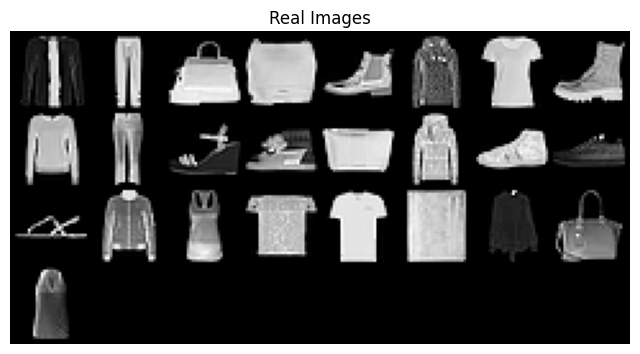

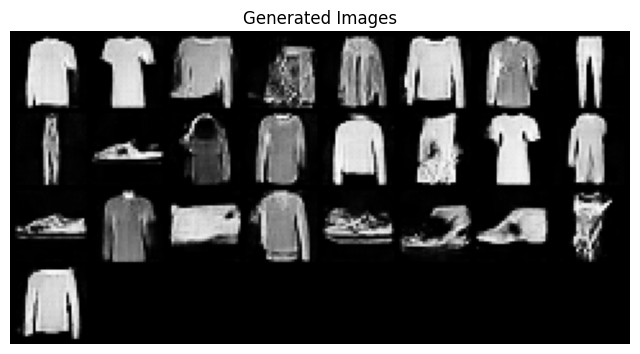

[Epoch 37/80] [Batch 0/469] [D loss: 1.3878355026245117] [G loss: 0.576030433177948] [D Acc: 0.62890625]
[Epoch 37/80] [Batch 100/469] [D loss: 1.2681517601013184] [G loss: 0.5499446392059326] [D Acc: 0.95703125]
[Epoch 37/80] [Batch 200/469] [D loss: 1.5214930772781372] [G loss: 0.5836821794509888] [D Acc: 0.58984375]
[Epoch 37/80] [Batch 300/469] [D loss: 1.4697977304458618] [G loss: 0.47499334812164307] [D Acc: 0.64453125]
[Epoch 37/80] [Batch 400/469] [D loss: 1.4157135486602783] [G loss: 0.5916669368743896] [D Acc: 0.54296875]


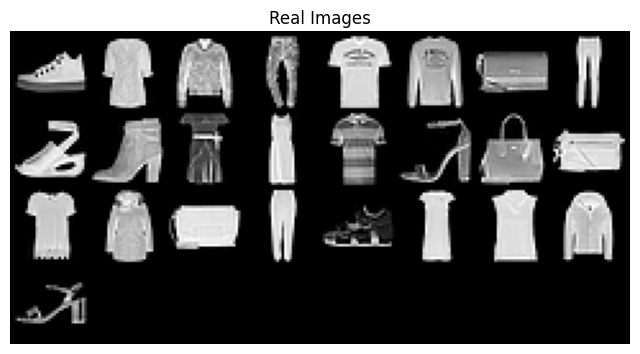

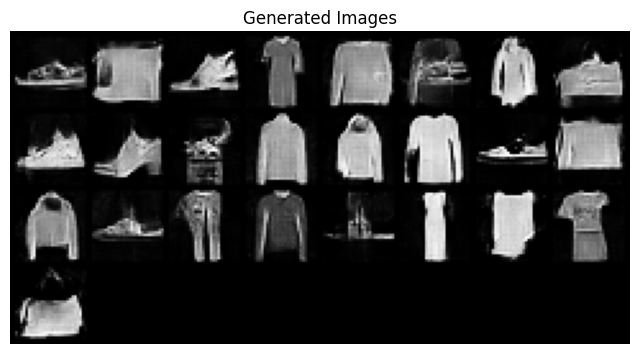

[Epoch 38/80] [Batch 0/469] [D loss: 1.3788713216781616] [G loss: 0.5262649059295654] [D Acc: 0.65234375]
[Epoch 38/80] [Batch 100/469] [D loss: 1.3662654161453247] [G loss: 0.6261630654335022] [D Acc: 0.56640625]
[Epoch 38/80] [Batch 200/469] [D loss: 1.4474622011184692] [G loss: 0.4799252152442932] [D Acc: 0.66015625]
[Epoch 38/80] [Batch 300/469] [D loss: 1.4057161808013916] [G loss: 0.6208858489990234] [D Acc: 0.50390625]
[Epoch 38/80] [Batch 400/469] [D loss: 1.283569097518921] [G loss: 0.5485579967498779] [D Acc: 0.9140625]


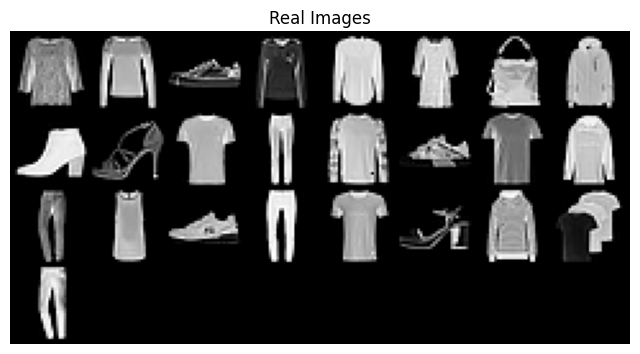

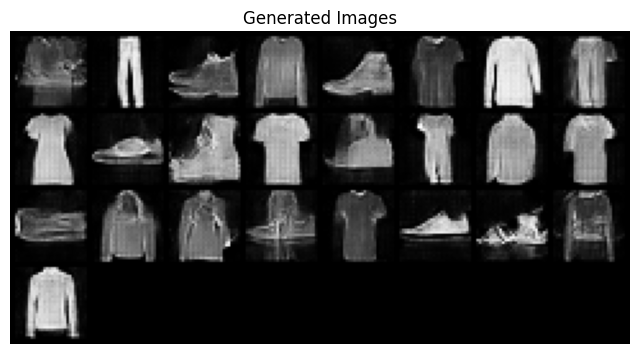

[Epoch 39/80] [Batch 0/469] [D loss: 1.4220914840698242] [G loss: 0.5463461875915527] [D Acc: 0.6796875]
[Epoch 39/80] [Batch 100/469] [D loss: 1.3566255569458008] [G loss: 0.5352187156677246] [D Acc: 0.6796875]
[Epoch 39/80] [Batch 200/469] [D loss: 1.3939937353134155] [G loss: 0.5956246852874756] [D Acc: 0.5625]
[Epoch 39/80] [Batch 300/469] [D loss: 1.4158101081848145] [G loss: 0.6112221479415894] [D Acc: 0.51171875]
[Epoch 39/80] [Batch 400/469] [D loss: 1.3679139614105225] [G loss: 0.6059644222259521] [D Acc: 0.6015625]


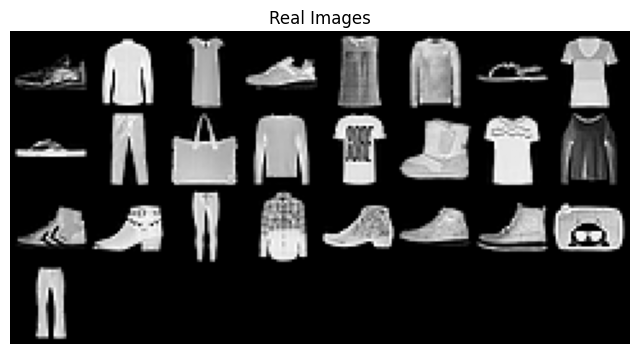

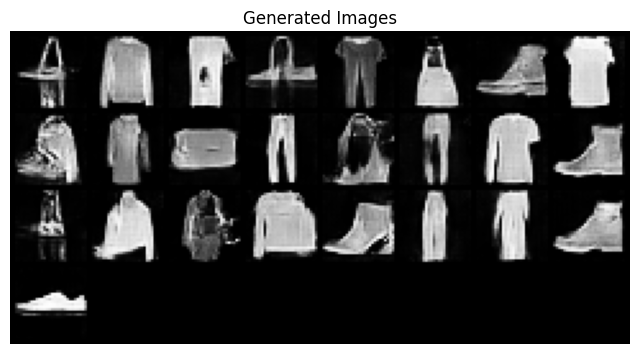

[Epoch 40/80] [Batch 0/469] [D loss: 1.394970178604126] [G loss: 0.5971026420593262] [D Acc: 0.6015625]
[Epoch 40/80] [Batch 100/469] [D loss: 1.4051299095153809] [G loss: 0.5395111441612244] [D Acc: 0.609375]
[Epoch 40/80] [Batch 200/469] [D loss: 1.412922978401184] [G loss: 0.6159487366676331] [D Acc: 0.53125]
[Epoch 40/80] [Batch 300/469] [D loss: 1.4012258052825928] [G loss: 0.5955758094787598] [D Acc: 0.5234375]
[Epoch 40/80] [Batch 400/469] [D loss: 1.421980619430542] [G loss: 0.5076016187667847] [D Acc: 0.80859375]


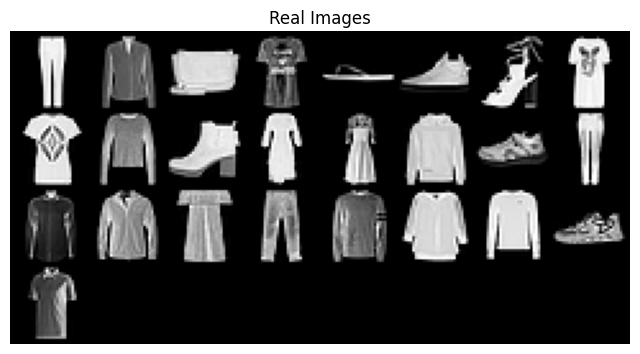

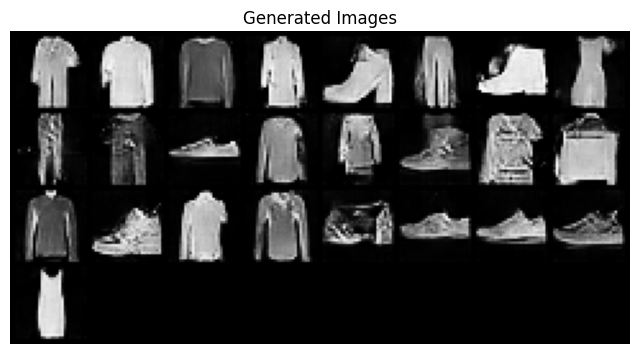

[Epoch 41/80] [Batch 0/469] [D loss: 1.4388445615768433] [G loss: 0.47806668281555176] [D Acc: 0.5546875]
[Epoch 41/80] [Batch 100/469] [D loss: 1.369196891784668] [G loss: 0.6287788152694702] [D Acc: 0.5546875]
[Epoch 41/80] [Batch 200/469] [D loss: 1.3818455934524536] [G loss: 0.6085069179534912] [D Acc: 0.625]
[Epoch 41/80] [Batch 300/469] [D loss: 1.402678370475769] [G loss: 0.622256875038147] [D Acc: 0.53515625]
[Epoch 41/80] [Batch 400/469] [D loss: 1.3900556564331055] [G loss: 0.651729941368103] [D Acc: 0.5078125]


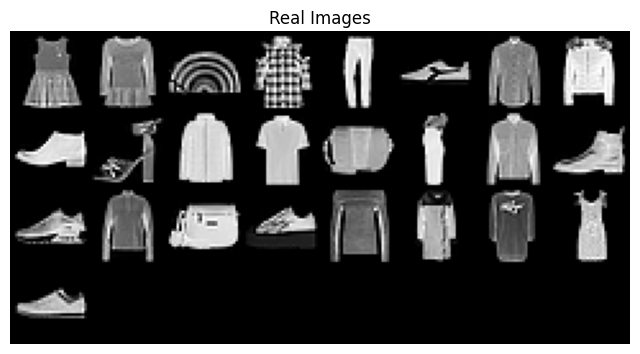

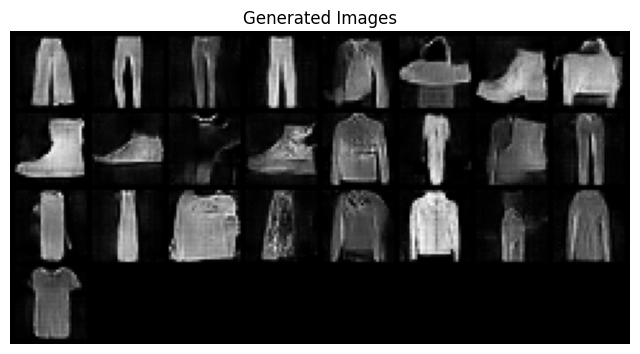

[Epoch 42/80] [Batch 0/469] [D loss: 1.4775999784469604] [G loss: 0.5443006157875061] [D Acc: 0.5]
[Epoch 42/80] [Batch 100/469] [D loss: 1.3948084115982056] [G loss: 0.621151864528656] [D Acc: 0.51171875]
[Epoch 42/80] [Batch 200/469] [D loss: 1.3956011533737183] [G loss: 0.5746703147888184] [D Acc: 0.6328125]
[Epoch 42/80] [Batch 300/469] [D loss: 1.3667287826538086] [G loss: 0.4642874598503113] [D Acc: 0.69921875]
[Epoch 42/80] [Batch 400/469] [D loss: 1.3982442617416382] [G loss: 0.5209088325500488] [D Acc: 0.5078125]


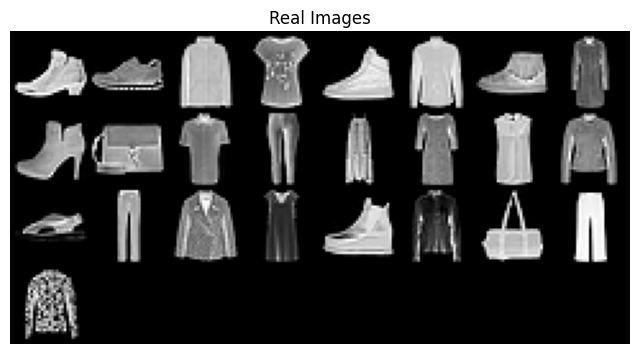

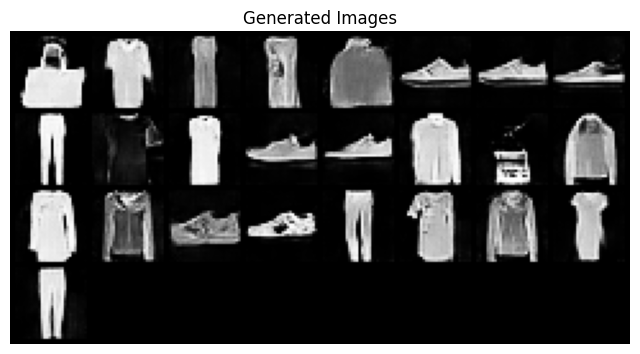

[Epoch 43/80] [Batch 0/469] [D loss: 1.375889778137207] [G loss: 0.5698436498641968] [D Acc: 0.65234375]
[Epoch 43/80] [Batch 100/469] [D loss: 1.7885682582855225] [G loss: 0.5759189128875732] [D Acc: 0.46484375]
[Epoch 43/80] [Batch 200/469] [D loss: 1.3786771297454834] [G loss: 0.5995396375656128] [D Acc: 0.5625]
[Epoch 43/80] [Batch 300/469] [D loss: 1.3739537000656128] [G loss: 0.6373943090438843] [D Acc: 0.53125]
[Epoch 43/80] [Batch 400/469] [D loss: 1.3748186826705933] [G loss: 0.5884831547737122] [D Acc: 0.57421875]


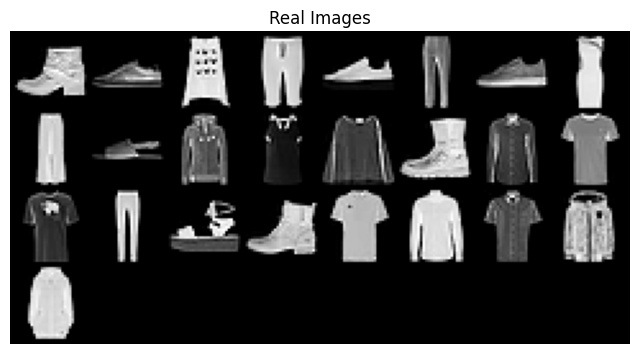

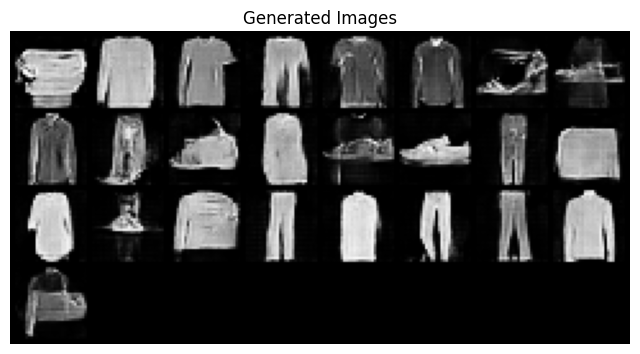

[Epoch 44/80] [Batch 0/469] [D loss: 1.470544457435608] [G loss: 0.5712592601776123] [D Acc: 0.70703125]
[Epoch 44/80] [Batch 100/469] [D loss: 1.451521396636963] [G loss: 0.5437643527984619] [D Acc: 0.46875]
[Epoch 44/80] [Batch 200/469] [D loss: 1.4393315315246582] [G loss: 0.505962610244751] [D Acc: 0.4453125]
[Epoch 44/80] [Batch 300/469] [D loss: 1.5913230180740356] [G loss: 0.39977437257766724] [D Acc: 0.5078125]
[Epoch 44/80] [Batch 400/469] [D loss: 1.3994001150131226] [G loss: 0.5910564661026001] [D Acc: 0.51171875]


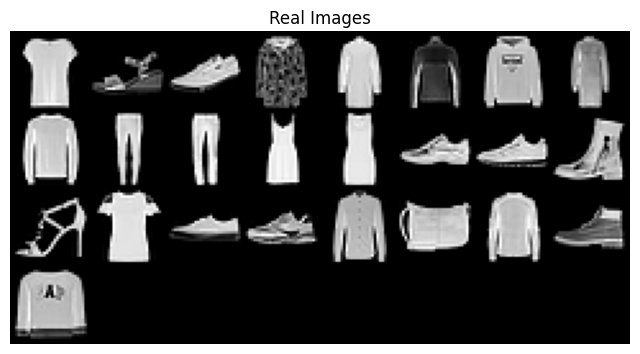

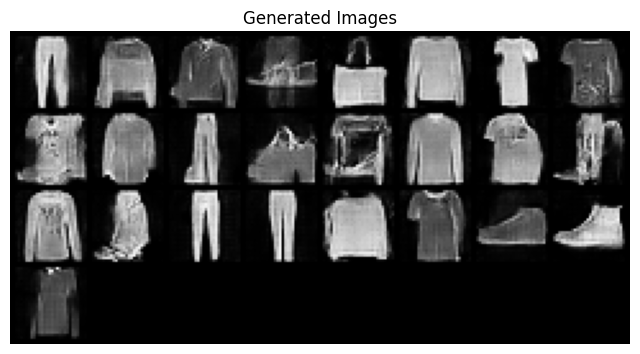

[Epoch 45/80] [Batch 0/469] [D loss: 1.4402601718902588] [G loss: 0.5227025747299194] [D Acc: 0.57421875]
[Epoch 45/80] [Batch 100/469] [D loss: 1.3683291673660278] [G loss: 0.5905637741088867] [D Acc: 0.625]
[Epoch 45/80] [Batch 200/469] [D loss: 1.302559494972229] [G loss: 0.5561599731445312] [D Acc: 0.8828125]
[Epoch 45/80] [Batch 300/469] [D loss: 1.3610656261444092] [G loss: 0.5340669751167297] [D Acc: 0.6171875]
[Epoch 45/80] [Batch 400/469] [D loss: 1.417597770690918] [G loss: 0.5132488012313843] [D Acc: 0.50390625]


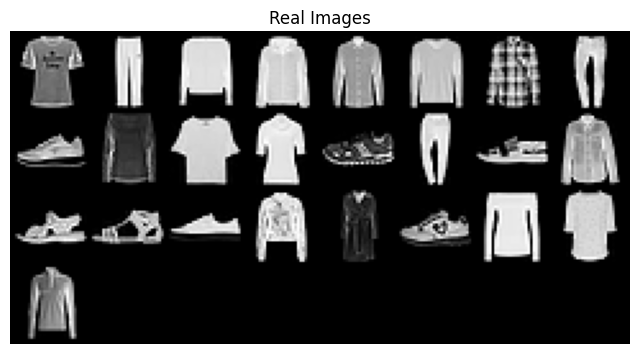

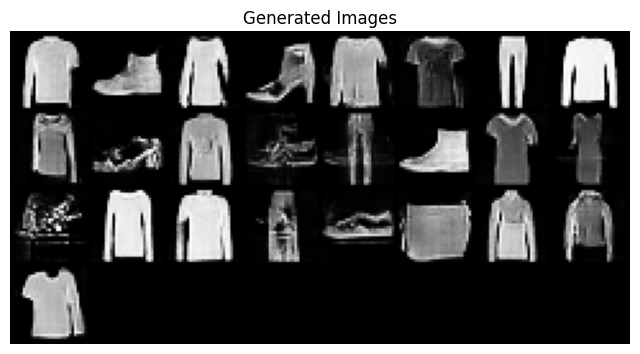

[Epoch 46/80] [Batch 0/469] [D loss: 1.3920966386795044] [G loss: 0.6375945806503296] [D Acc: 0.50390625]
[Epoch 46/80] [Batch 100/469] [D loss: 1.4649852514266968] [G loss: 0.5253773331642151] [D Acc: 0.63671875]
[Epoch 46/80] [Batch 200/469] [D loss: 1.3390244245529175] [G loss: 0.5908699035644531] [D Acc: 0.93359375]
[Epoch 46/80] [Batch 300/469] [D loss: 1.3833653926849365] [G loss: 0.598014235496521] [D Acc: 0.51171875]
[Epoch 46/80] [Batch 400/469] [D loss: 1.4107563495635986] [G loss: 0.6072672605514526] [D Acc: 0.54296875]


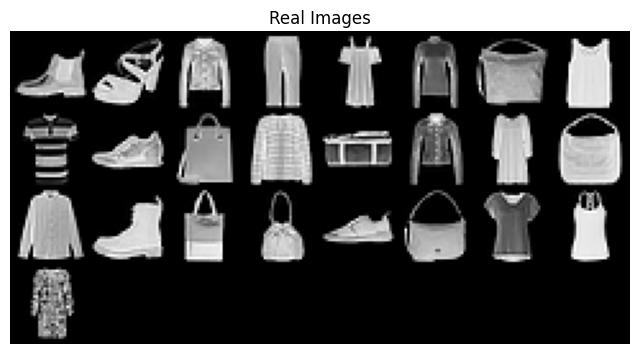

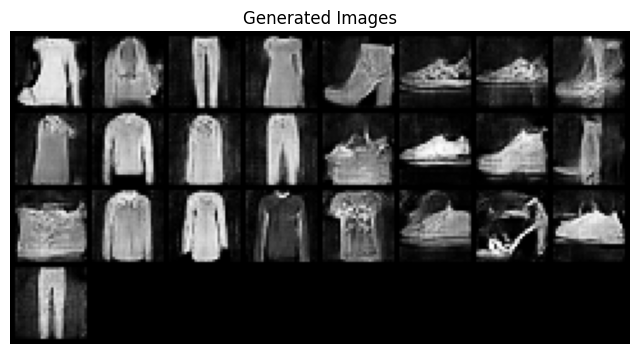

[Epoch 47/80] [Batch 0/469] [D loss: 1.8311841487884521] [G loss: 0.47949138283729553] [D Acc: 0.76171875]
[Epoch 47/80] [Batch 100/469] [D loss: 1.356490135192871] [G loss: 0.5946832299232483] [D Acc: 0.5859375]
[Epoch 47/80] [Batch 200/469] [D loss: 1.4223331212997437] [G loss: 0.5209237933158875] [D Acc: 0.81640625]
[Epoch 47/80] [Batch 300/469] [D loss: 1.3589283227920532] [G loss: 0.5780222415924072] [D Acc: 0.73046875]
[Epoch 47/80] [Batch 400/469] [D loss: 1.4360082149505615] [G loss: 0.5728827714920044] [D Acc: 0.55078125]


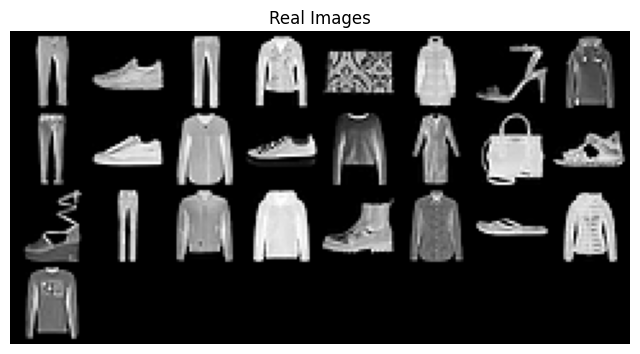

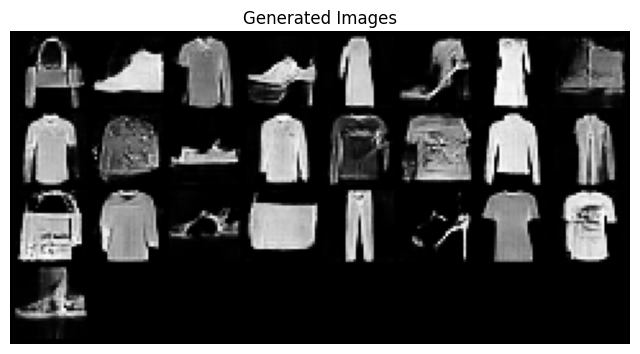

[Epoch 48/80] [Batch 0/469] [D loss: 1.3588870763778687] [G loss: 0.633513331413269] [D Acc: 0.59375]
[Epoch 48/80] [Batch 100/469] [D loss: 1.3886204957962036] [G loss: 0.5813009738922119] [D Acc: 0.81640625]
[Epoch 48/80] [Batch 200/469] [D loss: 1.4239892959594727] [G loss: 0.5199722051620483] [D Acc: 0.796875]
[Epoch 48/80] [Batch 300/469] [D loss: 1.360695242881775] [G loss: 0.6171138286590576] [D Acc: 0.52734375]
[Epoch 48/80] [Batch 400/469] [D loss: 1.380038857460022] [G loss: 0.6124839782714844] [D Acc: 0.515625]


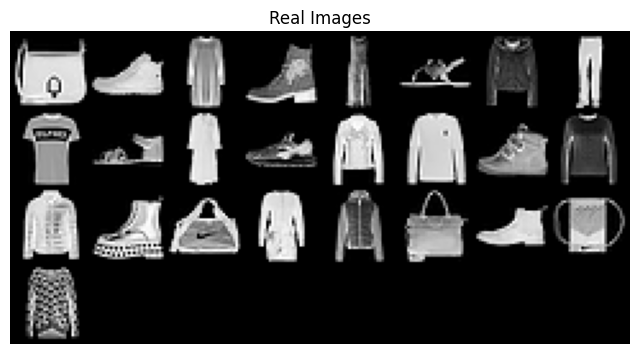

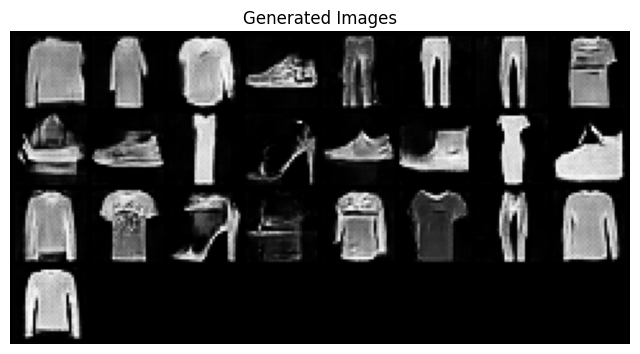

[Epoch 49/80] [Batch 0/469] [D loss: 1.4436250925064087] [G loss: 0.4789658188819885] [D Acc: 0.5]
[Epoch 49/80] [Batch 100/469] [D loss: 1.396005392074585] [G loss: 0.6235181093215942] [D Acc: 0.5]
[Epoch 49/80] [Batch 200/469] [D loss: 1.3219492435455322] [G loss: 0.5241036415100098] [D Acc: 0.85546875]
[Epoch 49/80] [Batch 300/469] [D loss: 1.3279920816421509] [G loss: 0.5707463026046753] [D Acc: 0.9609375]
[Epoch 49/80] [Batch 400/469] [D loss: 1.3896658420562744] [G loss: 0.5918991565704346] [D Acc: 0.5390625]


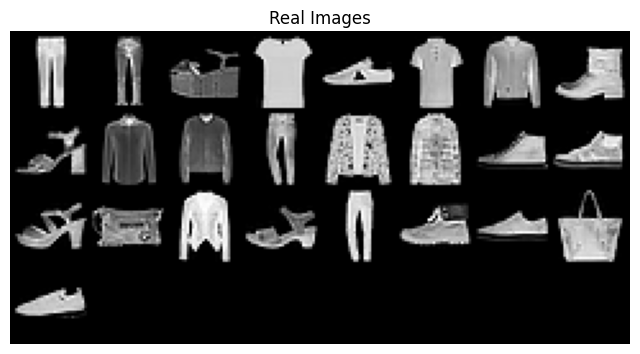

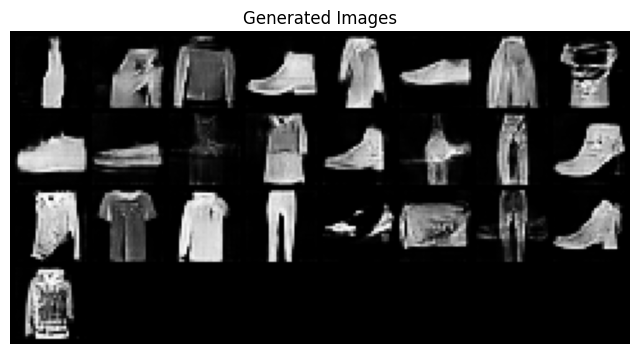

[Epoch 50/80] [Batch 0/469] [D loss: 1.3640586137771606] [G loss: 0.6101402640342712] [D Acc: 0.58984375]
[Epoch 50/80] [Batch 100/469] [D loss: 1.3811795711517334] [G loss: 0.6195185780525208] [D Acc: 0.53125]
[Epoch 50/80] [Batch 200/469] [D loss: 1.3923771381378174] [G loss: 0.5869176387786865] [D Acc: 0.6484375]
[Epoch 50/80] [Batch 300/469] [D loss: 1.565816044807434] [G loss: 0.4157394766807556] [D Acc: 0.53125]
[Epoch 50/80] [Batch 400/469] [D loss: 1.4103020429611206] [G loss: 0.5841137170791626] [D Acc: 0.53515625]


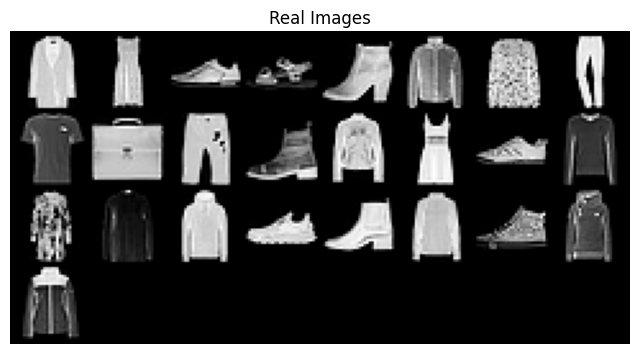

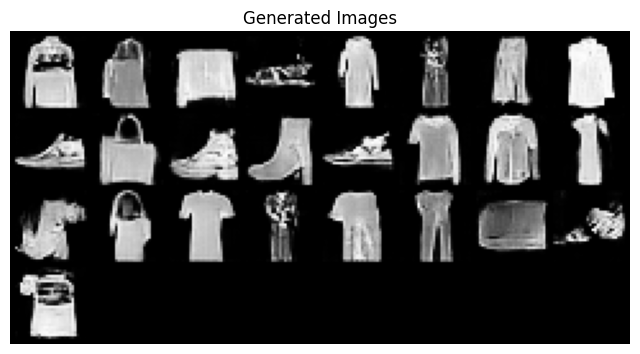

[Epoch 51/80] [Batch 0/469] [D loss: 1.3750191926956177] [G loss: 0.6389811038970947] [D Acc: 0.5546875]
[Epoch 51/80] [Batch 100/469] [D loss: 1.3971083164215088] [G loss: 0.5549935698509216] [D Acc: 0.8359375]
[Epoch 51/80] [Batch 200/469] [D loss: 1.4104435443878174] [G loss: 0.5634711980819702] [D Acc: 0.60546875]
[Epoch 51/80] [Batch 300/469] [D loss: 1.2937934398651123] [G loss: 0.5635329484939575] [D Acc: 0.9375]
[Epoch 51/80] [Batch 400/469] [D loss: 1.3563295602798462] [G loss: 0.5490059852600098] [D Acc: 0.76953125]


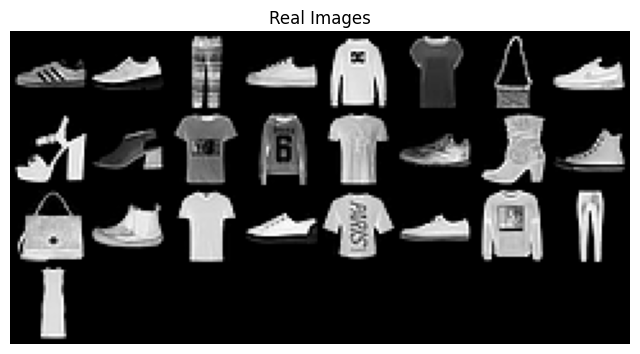

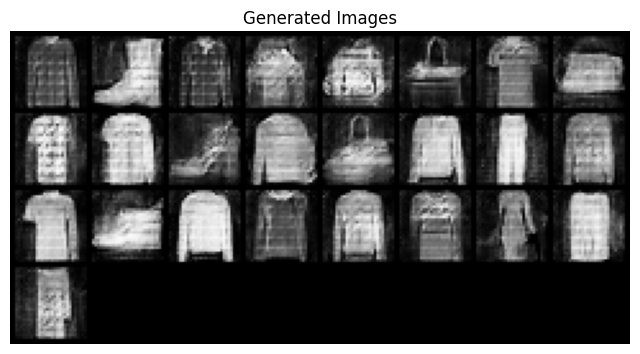

[Epoch 52/80] [Batch 0/469] [D loss: 1.268211007118225] [G loss: 0.596878170967102] [D Acc: 0.98046875]
[Epoch 52/80] [Batch 100/469] [D loss: 1.4204232692718506] [G loss: 0.5822245478630066] [D Acc: 0.5625]
[Epoch 52/80] [Batch 200/469] [D loss: 1.4148122072219849] [G loss: 0.6115784049034119] [D Acc: 0.5234375]
[Epoch 52/80] [Batch 300/469] [D loss: 1.395613670349121] [G loss: 0.6160456538200378] [D Acc: 0.53125]
[Epoch 52/80] [Batch 400/469] [D loss: 1.3918561935424805] [G loss: 0.6207888126373291] [D Acc: 0.515625]


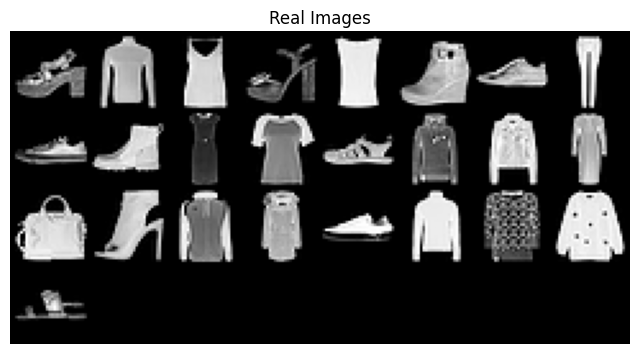

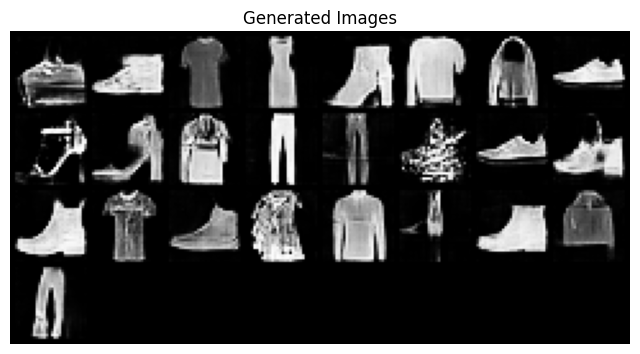

[Epoch 53/80] [Batch 0/469] [D loss: 1.377066731452942] [G loss: 0.5943245887756348] [D Acc: 0.5546875]
[Epoch 53/80] [Batch 100/469] [D loss: 1.3695173263549805] [G loss: 0.5986616015434265] [D Acc: 0.59765625]
[Epoch 53/80] [Batch 200/469] [D loss: 1.4326980113983154] [G loss: 0.5866737365722656] [D Acc: 0.671875]
[Epoch 53/80] [Batch 300/469] [D loss: 1.3967554569244385] [G loss: 0.5862375497817993] [D Acc: 0.78515625]
[Epoch 53/80] [Batch 400/469] [D loss: 1.3975889682769775] [G loss: 0.5650227069854736] [D Acc: 0.625]


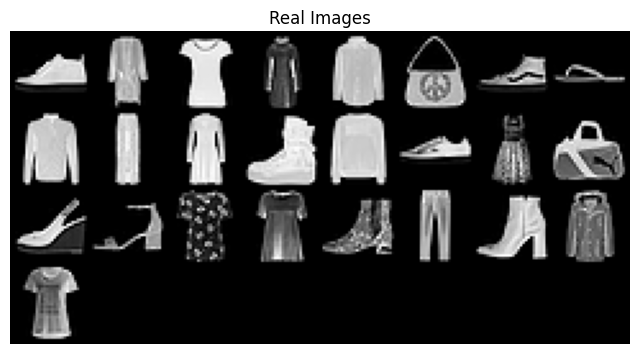

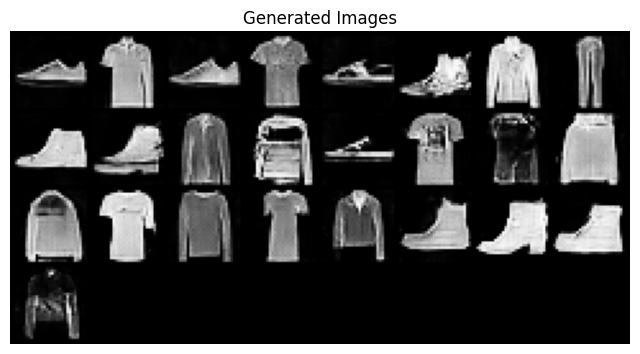

[Epoch 54/80] [Batch 0/469] [D loss: 1.3808895349502563] [G loss: 0.5958195924758911] [D Acc: 0.578125]
[Epoch 54/80] [Batch 100/469] [D loss: 1.3859643936157227] [G loss: 0.51915442943573] [D Acc: 0.49609375]
[Epoch 54/80] [Batch 200/469] [D loss: 1.4035815000534058] [G loss: 0.6262211203575134] [D Acc: 0.5390625]
[Epoch 54/80] [Batch 300/469] [D loss: 1.3906546831130981] [G loss: 0.5149054527282715] [D Acc: 0.8515625]
[Epoch 54/80] [Batch 400/469] [D loss: 1.3685221672058105] [G loss: 0.6152149438858032] [D Acc: 0.54296875]


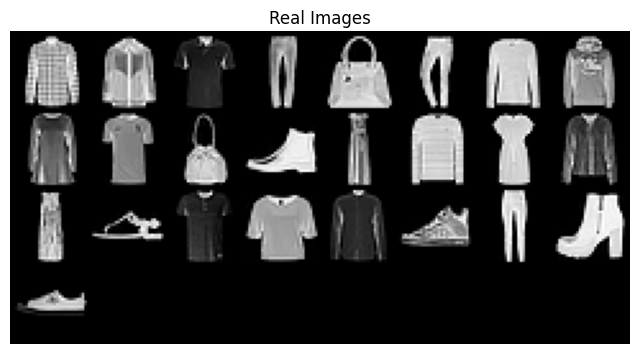

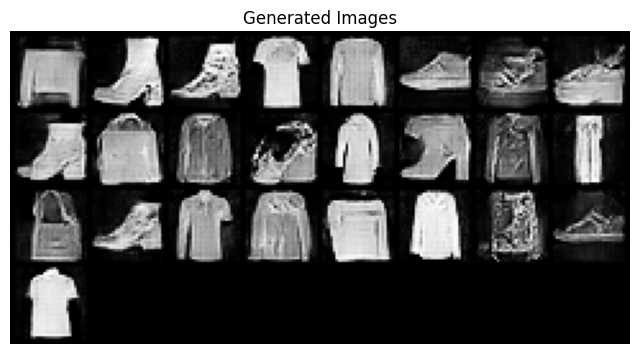

[Epoch 55/80] [Batch 0/469] [D loss: 1.3807597160339355] [G loss: 0.4936431646347046] [D Acc: 0.73046875]
[Epoch 55/80] [Batch 100/469] [D loss: 1.3666508197784424] [G loss: 0.6203761100769043] [D Acc: 0.53125]
[Epoch 55/80] [Batch 200/469] [D loss: 1.495452642440796] [G loss: 0.5497995615005493] [D Acc: 0.71875]
[Epoch 55/80] [Batch 300/469] [D loss: 1.3855111598968506] [G loss: 0.5453557968139648] [D Acc: 0.578125]
[Epoch 55/80] [Batch 400/469] [D loss: 1.4177651405334473] [G loss: 0.6368521451950073] [D Acc: 0.58203125]


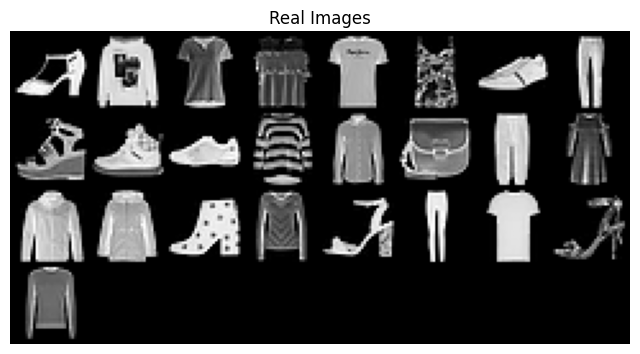

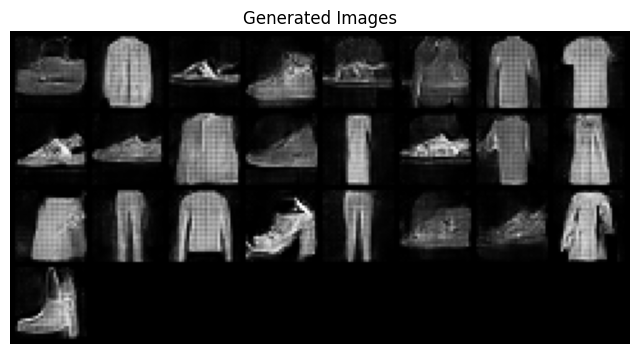

[Epoch 56/80] [Batch 0/469] [D loss: 1.4410533905029297] [G loss: 0.47540974617004395] [D Acc: 0.671875]
[Epoch 56/80] [Batch 100/469] [D loss: 1.4183247089385986] [G loss: 0.5621683597564697] [D Acc: 0.51171875]
[Epoch 56/80] [Batch 200/469] [D loss: 1.3547078371047974] [G loss: 0.6121699810028076] [D Acc: 0.5546875]
[Epoch 56/80] [Batch 300/469] [D loss: 1.3725178241729736] [G loss: 0.6035561561584473] [D Acc: 0.51953125]
[Epoch 56/80] [Batch 400/469] [D loss: 1.4590868949890137] [G loss: 0.628926694393158] [D Acc: 0.609375]


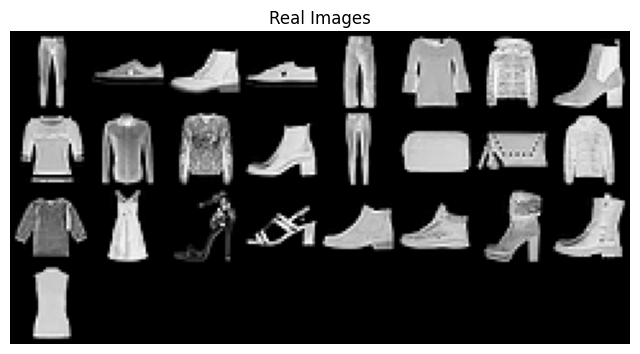

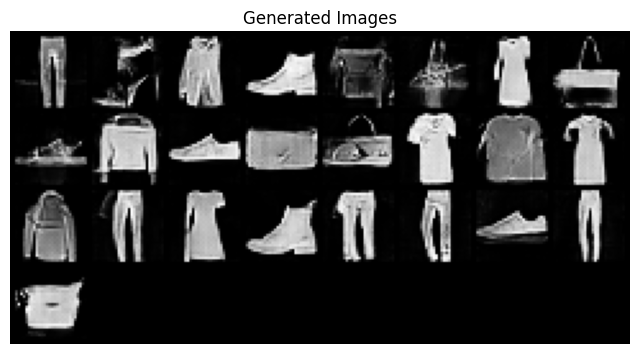

[Epoch 57/80] [Batch 0/469] [D loss: 1.5259133577346802] [G loss: 0.6193121075630188] [D Acc: 0.52734375]
[Epoch 57/80] [Batch 100/469] [D loss: 1.3867008686065674] [G loss: 0.651359498500824] [D Acc: 0.51171875]
[Epoch 57/80] [Batch 200/469] [D loss: 1.459993839263916] [G loss: 0.5454598665237427] [D Acc: 0.4765625]
[Epoch 57/80] [Batch 300/469] [D loss: 1.374551773071289] [G loss: 0.585008442401886] [D Acc: 0.55859375]
[Epoch 57/80] [Batch 400/469] [D loss: 1.3718812465667725] [G loss: 0.606192946434021] [D Acc: 0.58203125]


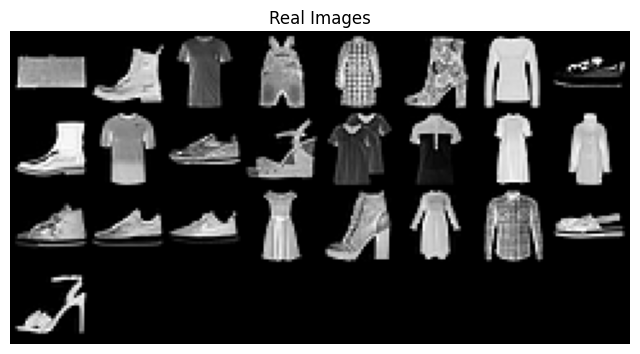

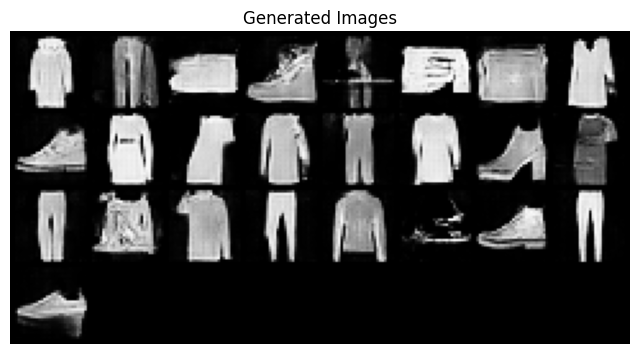

[Epoch 58/80] [Batch 0/469] [D loss: 1.3768752813339233] [G loss: 0.6054298877716064] [D Acc: 0.57421875]
[Epoch 58/80] [Batch 100/469] [D loss: 1.3008729219436646] [G loss: 0.5423578023910522] [D Acc: 0.91015625]
[Epoch 58/80] [Batch 200/469] [D loss: 1.3572700023651123] [G loss: 0.5910570621490479] [D Acc: 0.5625]
[Epoch 58/80] [Batch 300/469] [D loss: 1.384412169456482] [G loss: 0.6025247573852539] [D Acc: 0.546875]
[Epoch 58/80] [Batch 400/469] [D loss: 1.3933199644088745] [G loss: 0.6112059354782104] [D Acc: 0.5390625]


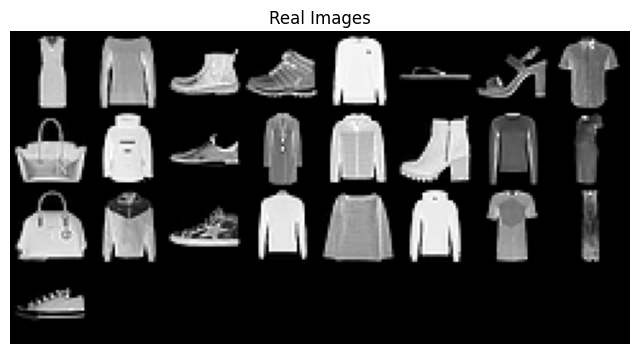

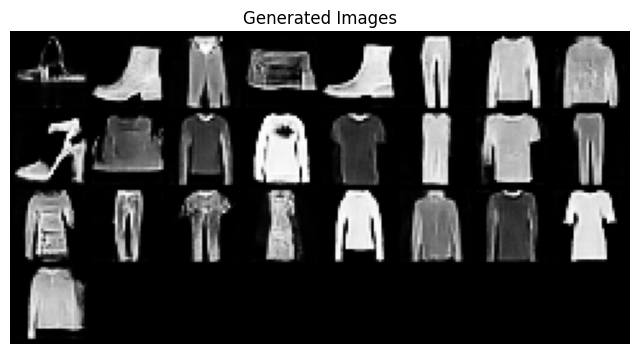

[Epoch 59/80] [Batch 0/469] [D loss: 1.3799376487731934] [G loss: 0.5204600095748901] [D Acc: 0.6953125]
[Epoch 59/80] [Batch 100/469] [D loss: 1.4417695999145508] [G loss: 0.5162222385406494] [D Acc: 0.67578125]
[Epoch 59/80] [Batch 200/469] [D loss: 1.4532477855682373] [G loss: 0.5003577470779419] [D Acc: 0.7109375]
[Epoch 59/80] [Batch 300/469] [D loss: 1.3771307468414307] [G loss: 0.5324841141700745] [D Acc: 0.921875]
[Epoch 59/80] [Batch 400/469] [D loss: 1.3626775741577148] [G loss: 0.5655089020729065] [D Acc: 0.67578125]


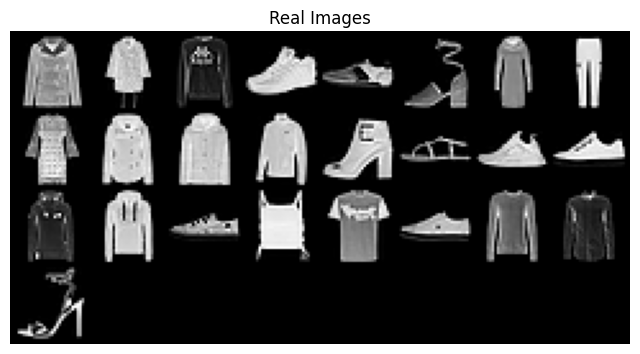

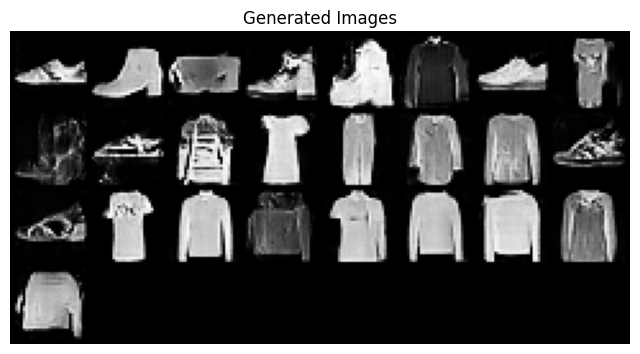

[Epoch 60/80] [Batch 0/469] [D loss: 1.352105975151062] [G loss: 0.5910346508026123] [D Acc: 0.55859375]
[Epoch 60/80] [Batch 100/469] [D loss: 1.3999730348587036] [G loss: 0.6086947917938232] [D Acc: 0.52734375]
[Epoch 60/80] [Batch 200/469] [D loss: 1.3906705379486084] [G loss: 0.6097742915153503] [D Acc: 0.53125]
[Epoch 60/80] [Batch 300/469] [D loss: 1.3823431730270386] [G loss: 0.6024978160858154] [D Acc: 0.546875]
[Epoch 60/80] [Batch 400/469] [D loss: 1.3497605323791504] [G loss: 0.5982996821403503] [D Acc: 0.625]


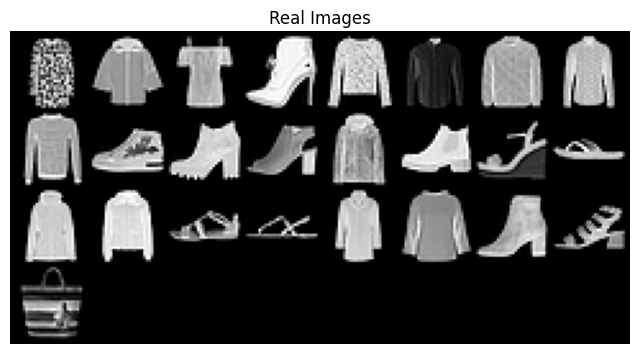

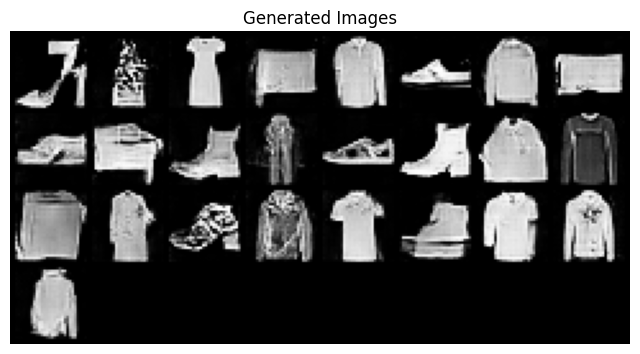

[Epoch 61/80] [Batch 0/469] [D loss: 1.3779184818267822] [G loss: 0.6088231801986694] [D Acc: 0.609375]
[Epoch 61/80] [Batch 100/469] [D loss: 1.3797118663787842] [G loss: 0.5579500198364258] [D Acc: 0.52734375]
[Epoch 61/80] [Batch 200/469] [D loss: 1.3885961771011353] [G loss: 0.5952503681182861] [D Acc: 0.5859375]
[Epoch 61/80] [Batch 300/469] [D loss: 1.3829491138458252] [G loss: 0.5851802825927734] [D Acc: 0.68359375]
[Epoch 61/80] [Batch 400/469] [D loss: 1.4402287006378174] [G loss: 0.4652599096298218] [D Acc: 0.53515625]


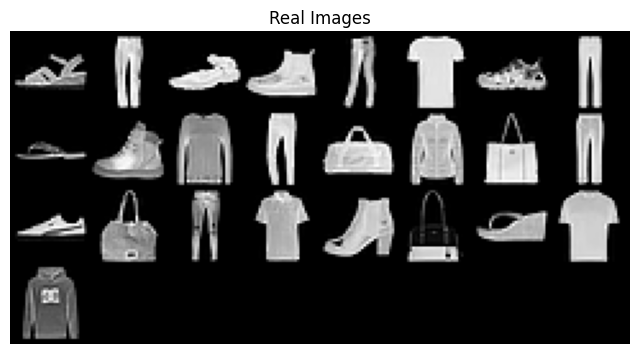

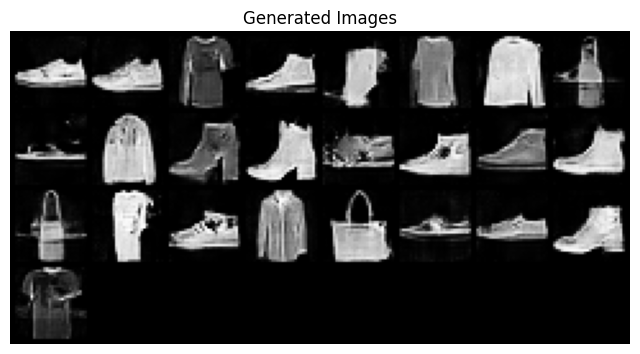

[Epoch 62/80] [Batch 0/469] [D loss: 1.3763248920440674] [G loss: 0.5874661207199097] [D Acc: 0.5625]
[Epoch 62/80] [Batch 100/469] [D loss: 1.3864699602127075] [G loss: 0.6364867687225342] [D Acc: 0.51171875]
[Epoch 62/80] [Batch 200/469] [D loss: 1.4307161569595337] [G loss: 0.5613107085227966] [D Acc: 0.59375]
[Epoch 62/80] [Batch 300/469] [D loss: 1.3714276552200317] [G loss: 0.6084716320037842] [D Acc: 0.57421875]
[Epoch 62/80] [Batch 400/469] [D loss: 1.3913823366165161] [G loss: 0.5867031812667847] [D Acc: 0.5546875]


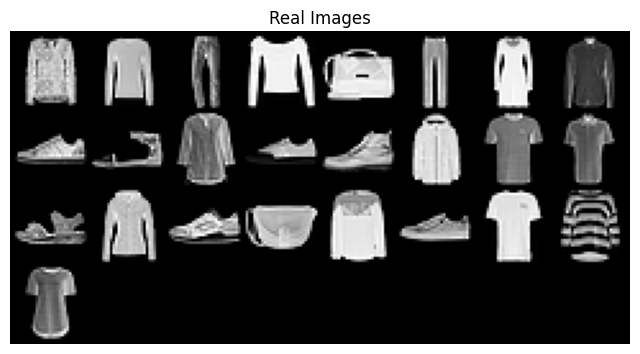

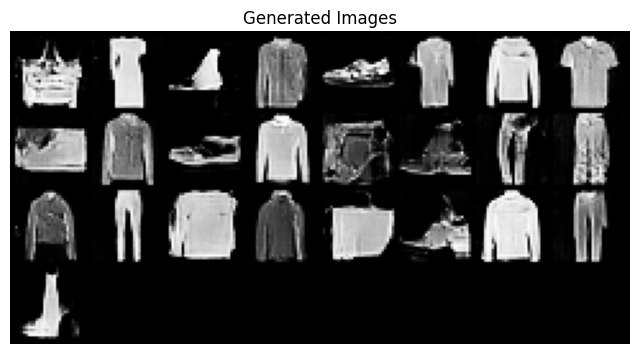

[Epoch 63/80] [Batch 0/469] [D loss: 1.3572628498077393] [G loss: 0.5742605924606323] [D Acc: 0.55859375]
[Epoch 63/80] [Batch 100/469] [D loss: 1.2896811962127686] [G loss: 0.5693715810775757] [D Acc: 0.93359375]
[Epoch 63/80] [Batch 200/469] [D loss: 1.3643040657043457] [G loss: 0.5221014022827148] [D Acc: 0.8046875]
[Epoch 63/80] [Batch 300/469] [D loss: 1.404480218887329] [G loss: 0.610049843788147] [D Acc: 0.60546875]
[Epoch 63/80] [Batch 400/469] [D loss: 1.4387290477752686] [G loss: 0.5084488391876221] [D Acc: 0.69921875]


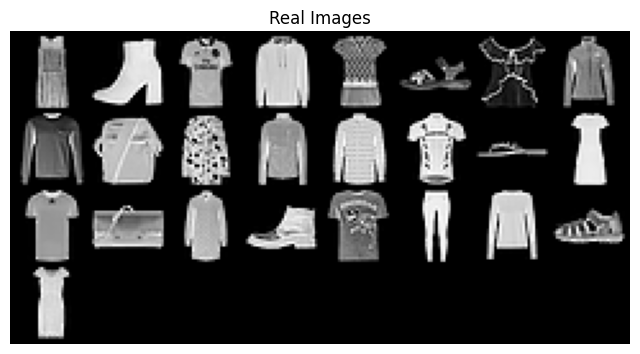

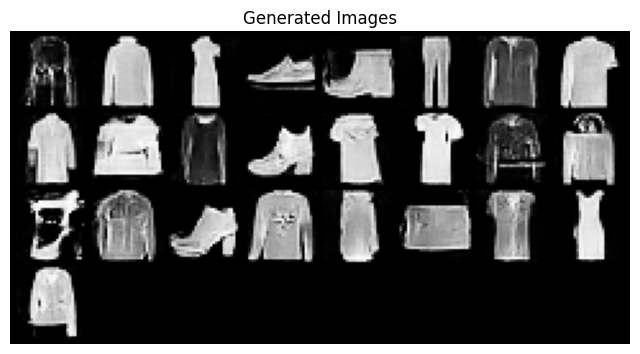

[Epoch 64/80] [Batch 0/469] [D loss: 1.4360588788986206] [G loss: 0.5495469570159912] [D Acc: 0.50390625]
[Epoch 64/80] [Batch 100/469] [D loss: 1.3874006271362305] [G loss: 0.6076022386550903] [D Acc: 0.546875]
[Epoch 64/80] [Batch 200/469] [D loss: 1.4119223356246948] [G loss: 0.5911990404129028] [D Acc: 0.55078125]
[Epoch 64/80] [Batch 300/469] [D loss: 1.3729950189590454] [G loss: 0.6340829133987427] [D Acc: 0.55859375]
[Epoch 64/80] [Batch 400/469] [D loss: 1.3735744953155518] [G loss: 0.6126708984375] [D Acc: 0.56640625]


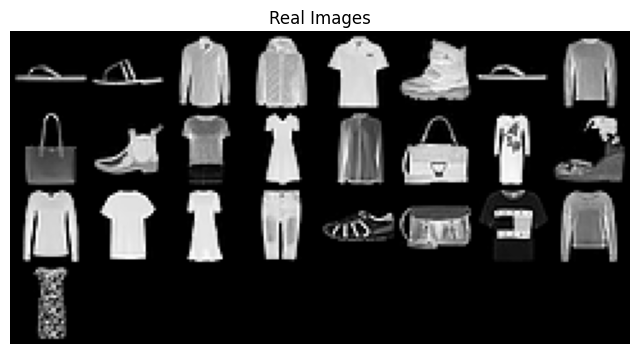

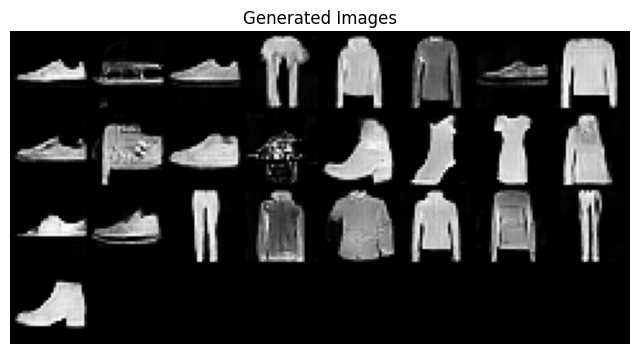

[Epoch 65/80] [Batch 0/469] [D loss: 1.3832916021347046] [G loss: 0.6038080453872681] [D Acc: 0.5625]
[Epoch 65/80] [Batch 100/469] [D loss: 1.4026148319244385] [G loss: 0.6385211944580078] [D Acc: 0.55078125]
[Epoch 65/80] [Batch 200/469] [D loss: 1.3797295093536377] [G loss: 0.5519413352012634] [D Acc: 0.5]
[Epoch 65/80] [Batch 300/469] [D loss: 1.415156364440918] [G loss: 0.6237114667892456] [D Acc: 0.67578125]
[Epoch 65/80] [Batch 400/469] [D loss: 1.3486534357070923] [G loss: 0.5832032561302185] [D Acc: 0.65625]


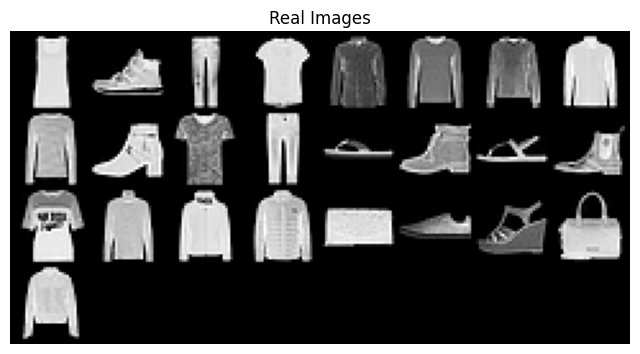

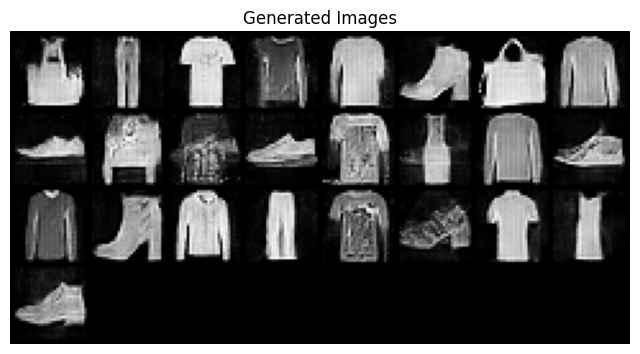

[Epoch 66/80] [Batch 0/469] [D loss: 1.3370678424835205] [G loss: 0.5567732453346252] [D Acc: 0.72265625]
[Epoch 66/80] [Batch 100/469] [D loss: 1.3639799356460571] [G loss: 0.6305710673332214] [D Acc: 0.546875]
[Epoch 66/80] [Batch 200/469] [D loss: 1.3578276634216309] [G loss: 0.6178396940231323] [D Acc: 0.5390625]
[Epoch 66/80] [Batch 300/469] [D loss: 1.4021192789077759] [G loss: 0.5470890402793884] [D Acc: 0.7890625]
[Epoch 66/80] [Batch 400/469] [D loss: 1.383213996887207] [G loss: 0.5820721387863159] [D Acc: 0.57421875]


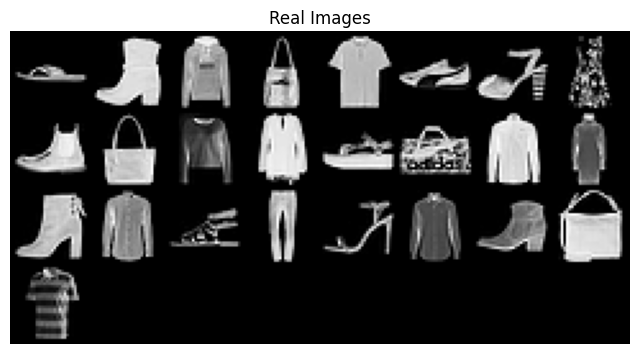

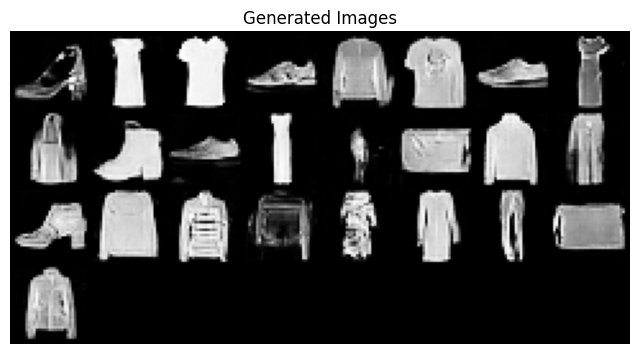

[Epoch 67/80] [Batch 0/469] [D loss: 1.357331395149231] [G loss: 0.6054909229278564] [D Acc: 0.546875]
[Epoch 67/80] [Batch 100/469] [D loss: 1.44049072265625] [G loss: 0.41387128829956055] [D Acc: 0.56640625]
[Epoch 67/80] [Batch 200/469] [D loss: 1.4056355953216553] [G loss: 0.5940861701965332] [D Acc: 0.51171875]
[Epoch 67/80] [Batch 300/469] [D loss: 1.3968864679336548] [G loss: 0.6404280066490173] [D Acc: 0.52734375]
[Epoch 67/80] [Batch 400/469] [D loss: 1.354069471359253] [G loss: 0.5143668055534363] [D Acc: 0.83203125]


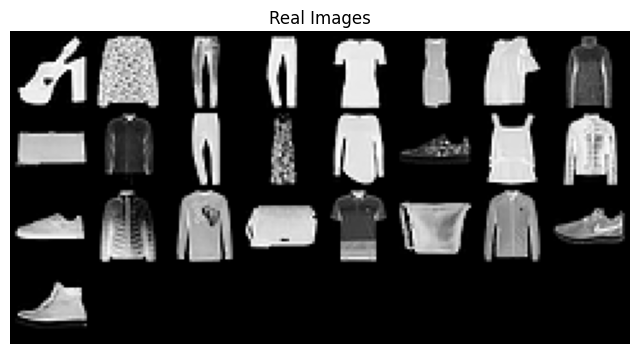

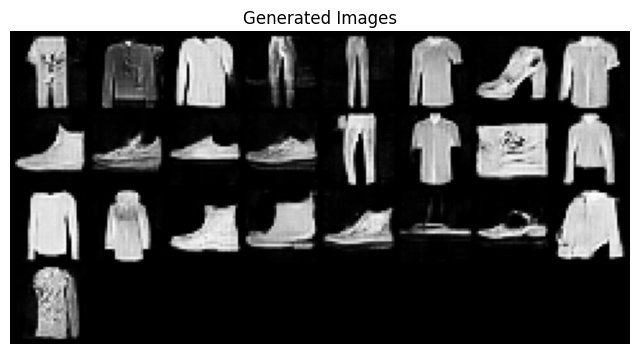

[Epoch 68/80] [Batch 0/469] [D loss: 1.392941951751709] [G loss: 0.5533560514450073] [D Acc: 0.515625]
[Epoch 68/80] [Batch 100/469] [D loss: 1.4862821102142334] [G loss: 0.46360641717910767] [D Acc: 0.58203125]
[Epoch 68/80] [Batch 200/469] [D loss: 1.3740203380584717] [G loss: 0.6463978290557861] [D Acc: 0.53125]
[Epoch 68/80] [Batch 300/469] [D loss: 1.3879791498184204] [G loss: 0.6026143431663513] [D Acc: 0.546875]
[Epoch 68/80] [Batch 400/469] [D loss: 1.339571237564087] [G loss: 0.48593205213546753] [D Acc: 0.7578125]


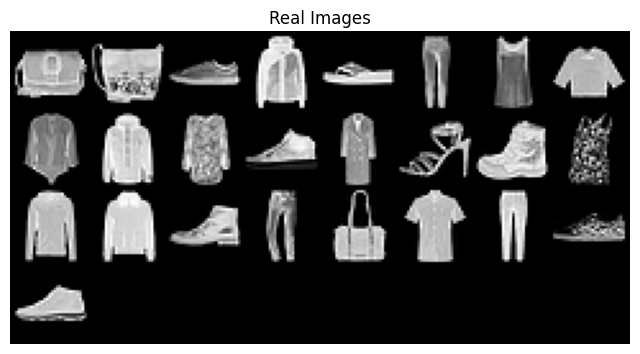

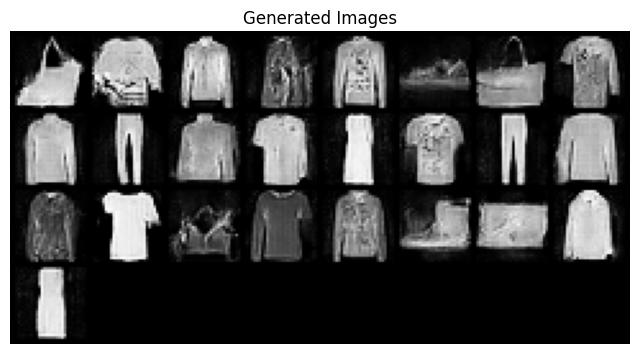

[Epoch 69/80] [Batch 0/469] [D loss: 1.3438061475753784] [G loss: 0.541756272315979] [D Acc: 0.734375]
[Epoch 69/80] [Batch 100/469] [D loss: 1.36479914188385] [G loss: 0.6698534488677979] [D Acc: 0.5078125]
[Epoch 69/80] [Batch 200/469] [D loss: 1.3432512283325195] [G loss: 0.5798723697662354] [D Acc: 0.74609375]
[Epoch 69/80] [Batch 300/469] [D loss: 1.3919711112976074] [G loss: 0.5735373497009277] [D Acc: 0.6796875]
[Epoch 69/80] [Batch 400/469] [D loss: 1.389668583869934] [G loss: 0.5988814830780029] [D Acc: 0.546875]


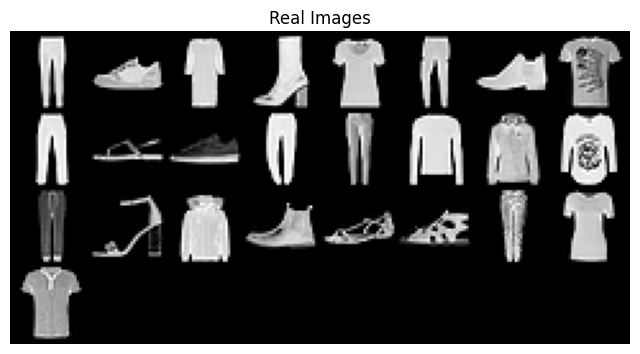

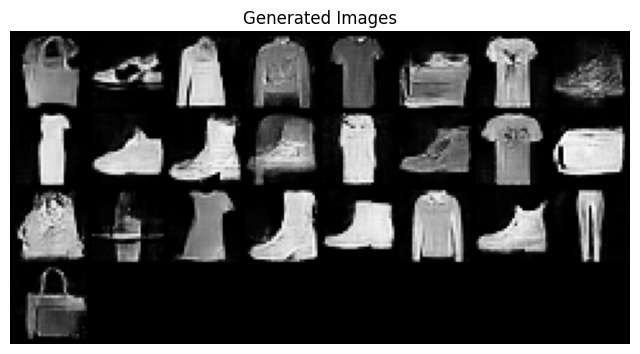

[Epoch 70/80] [Batch 0/469] [D loss: 1.3315918445587158] [G loss: 0.5983875393867493] [D Acc: 0.73828125]
[Epoch 70/80] [Batch 100/469] [D loss: 1.3419241905212402] [G loss: 0.5956924557685852] [D Acc: 0.56640625]
[Epoch 70/80] [Batch 200/469] [D loss: 1.3790655136108398] [G loss: 0.6027315855026245] [D Acc: 0.578125]
[Epoch 70/80] [Batch 300/469] [D loss: 1.3923951387405396] [G loss: 0.5883709788322449] [D Acc: 0.53515625]
[Epoch 70/80] [Batch 400/469] [D loss: 1.3660043478012085] [G loss: 0.5736808776855469] [D Acc: 0.65625]


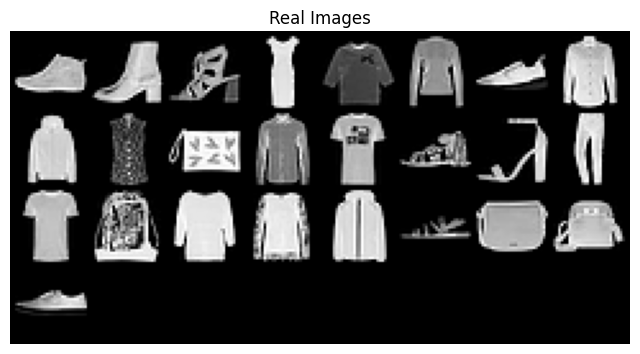

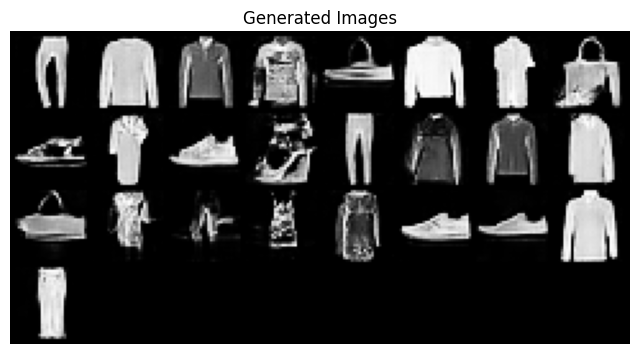

[Epoch 71/80] [Batch 0/469] [D loss: 1.3935083150863647] [G loss: 0.6179533004760742] [D Acc: 0.51953125]
[Epoch 71/80] [Batch 100/469] [D loss: 1.3983882665634155] [G loss: 0.5031566619873047] [D Acc: 0.8203125]
[Epoch 71/80] [Batch 200/469] [D loss: 1.331416368484497] [G loss: 0.5737348794937134] [D Acc: 0.94140625]
[Epoch 71/80] [Batch 300/469] [D loss: 1.3173285722732544] [G loss: 0.5834568738937378] [D Acc: 0.87890625]
[Epoch 71/80] [Batch 400/469] [D loss: 1.3573867082595825] [G loss: 0.6012474894523621] [D Acc: 0.58203125]


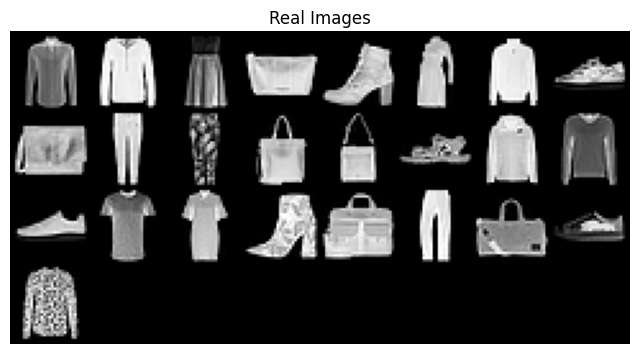

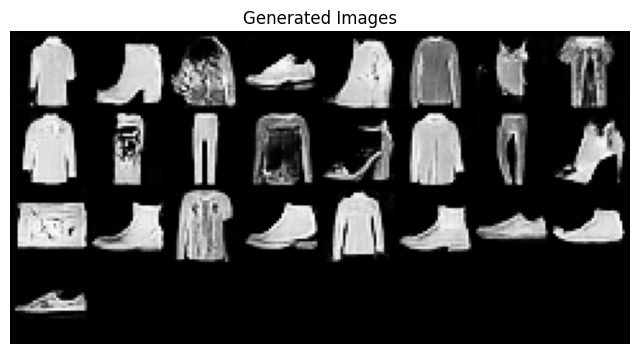

[Epoch 72/80] [Batch 0/469] [D loss: 1.353764533996582] [G loss: 0.6158215403556824] [D Acc: 0.55078125]
[Epoch 72/80] [Batch 100/469] [D loss: 1.4225692749023438] [G loss: 0.6237185597419739] [D Acc: 0.546875]
[Epoch 72/80] [Batch 200/469] [D loss: 1.3504208326339722] [G loss: 0.600005030632019] [D Acc: 0.609375]
[Epoch 72/80] [Batch 300/469] [D loss: 1.3813235759735107] [G loss: 0.6240153312683105] [D Acc: 0.5546875]
[Epoch 72/80] [Batch 400/469] [D loss: 1.4169408082962036] [G loss: 0.6125956773757935] [D Acc: 0.51953125]


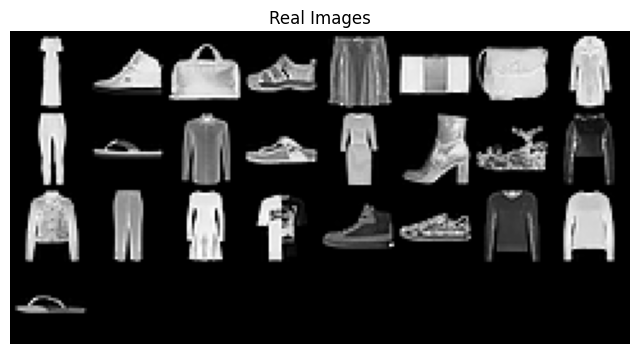

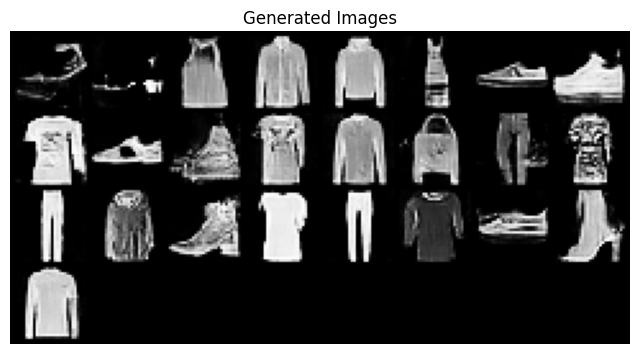

[Epoch 73/80] [Batch 0/469] [D loss: 1.3648531436920166] [G loss: 0.5930912494659424] [D Acc: 0.578125]
[Epoch 73/80] [Batch 100/469] [D loss: 1.378072738647461] [G loss: 0.5788043737411499] [D Acc: 0.54296875]
[Epoch 73/80] [Batch 200/469] [D loss: 1.5054715871810913] [G loss: 0.6265665888786316] [D Acc: 0.50390625]
[Epoch 73/80] [Batch 300/469] [D loss: 1.5386693477630615] [G loss: 0.5554730892181396] [D Acc: 0.6640625]
[Epoch 73/80] [Batch 400/469] [D loss: 1.3843084573745728] [G loss: 0.6309113502502441] [D Acc: 0.53515625]


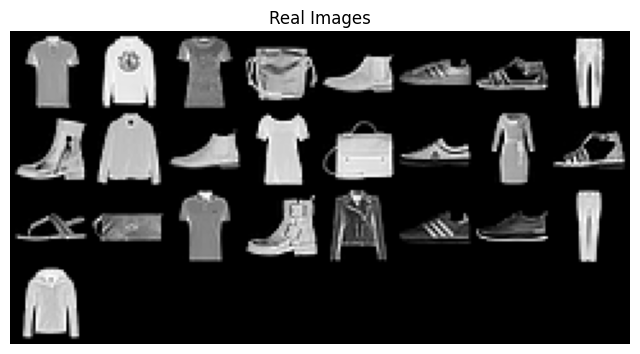

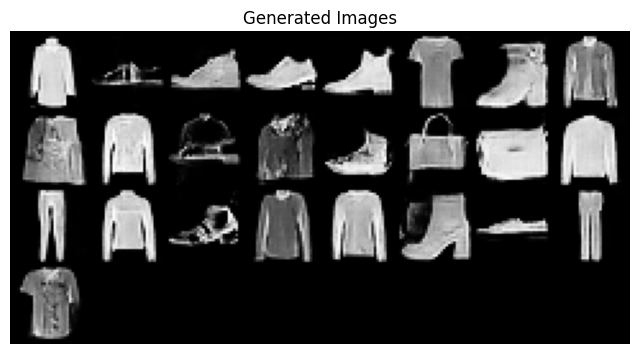

[Epoch 74/80] [Batch 0/469] [D loss: 1.3627777099609375] [G loss: 0.6185976266860962] [D Acc: 0.51953125]
[Epoch 74/80] [Batch 100/469] [D loss: 1.270858883857727] [G loss: 0.5675921440124512] [D Acc: 0.91015625]
[Epoch 74/80] [Batch 200/469] [D loss: 1.3695521354675293] [G loss: 0.5952517986297607] [D Acc: 0.70703125]
[Epoch 74/80] [Batch 300/469] [D loss: 1.3614161014556885] [G loss: 0.6096269488334656] [D Acc: 0.60546875]
[Epoch 74/80] [Batch 400/469] [D loss: 1.365849494934082] [G loss: 0.6315982341766357] [D Acc: 0.57421875]


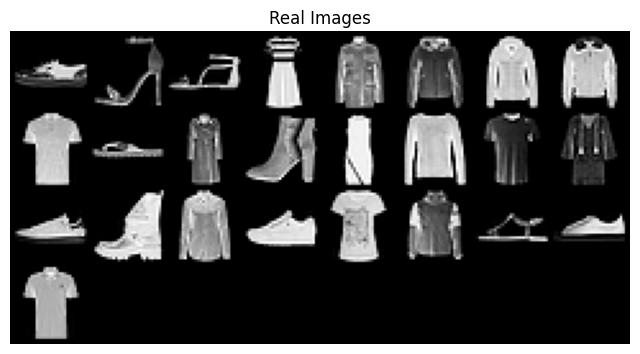

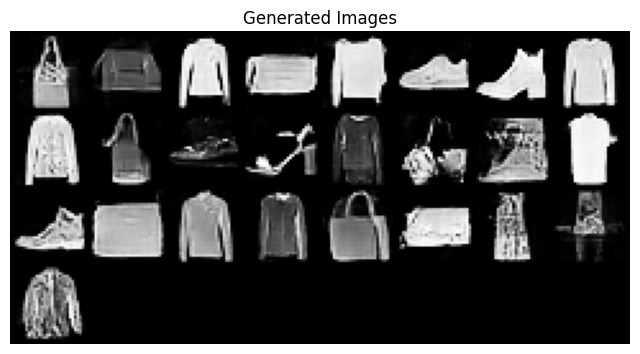

[Epoch 75/80] [Batch 0/469] [D loss: 1.3983628749847412] [G loss: 0.5823258757591248] [D Acc: 0.546875]
[Epoch 75/80] [Batch 100/469] [D loss: 1.3629294633865356] [G loss: 0.6289539337158203] [D Acc: 0.63671875]
[Epoch 75/80] [Batch 200/469] [D loss: 1.3696633577346802] [G loss: 0.6006050109863281] [D Acc: 0.5703125]
[Epoch 75/80] [Batch 300/469] [D loss: 1.3632831573486328] [G loss: 0.6187039017677307] [D Acc: 0.57421875]
[Epoch 75/80] [Batch 400/469] [D loss: 1.4135459661483765] [G loss: 0.5246720314025879] [D Acc: 0.62890625]


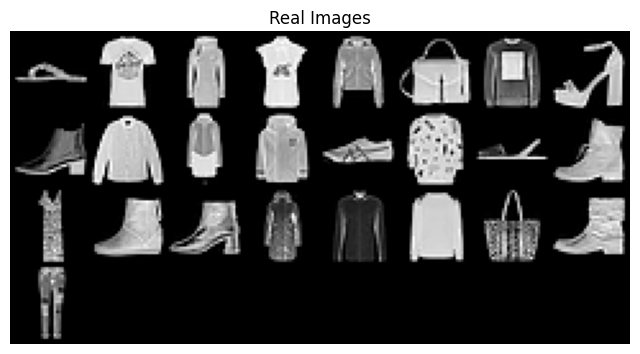

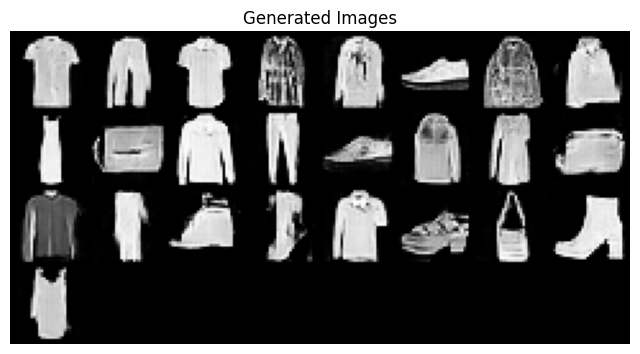

[Epoch 76/80] [Batch 0/469] [D loss: 1.3740919828414917] [G loss: 0.6421229243278503] [D Acc: 0.52734375]
[Epoch 76/80] [Batch 100/469] [D loss: 1.4128371477127075] [G loss: 0.6049154996871948] [D Acc: 0.62890625]
[Epoch 76/80] [Batch 200/469] [D loss: 1.4679081439971924] [G loss: 0.5106837749481201] [D Acc: 0.45703125]
[Epoch 76/80] [Batch 300/469] [D loss: 1.3992955684661865] [G loss: 0.553822934627533] [D Acc: 0.48046875]
[Epoch 76/80] [Batch 400/469] [D loss: 1.3633592128753662] [G loss: 0.632463812828064] [D Acc: 0.52734375]


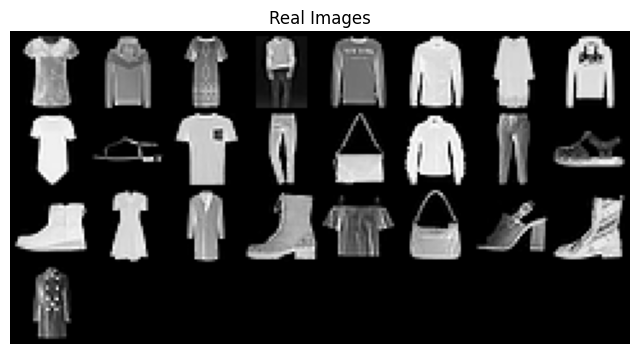

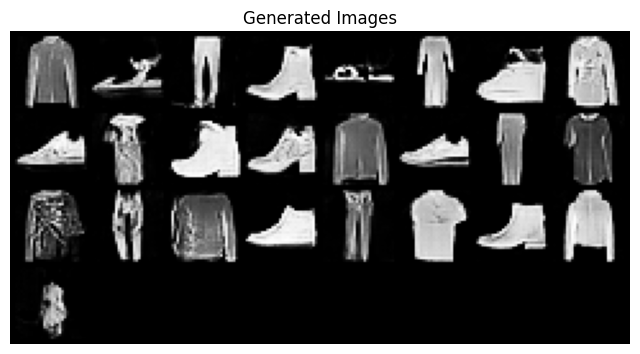

[Epoch 77/80] [Batch 0/469] [D loss: 1.365808367729187] [G loss: 0.5860941410064697] [D Acc: 0.7109375]
[Epoch 77/80] [Batch 100/469] [D loss: 1.3501567840576172] [G loss: 0.6236950159072876] [D Acc: 0.59375]
[Epoch 77/80] [Batch 200/469] [D loss: 1.3598511219024658] [G loss: 0.6371490955352783] [D Acc: 0.5234375]
[Epoch 77/80] [Batch 300/469] [D loss: 1.367139220237732] [G loss: 0.5790053009986877] [D Acc: 0.68359375]
[Epoch 77/80] [Batch 400/469] [D loss: 1.3635122776031494] [G loss: 0.5665633678436279] [D Acc: 0.6171875]


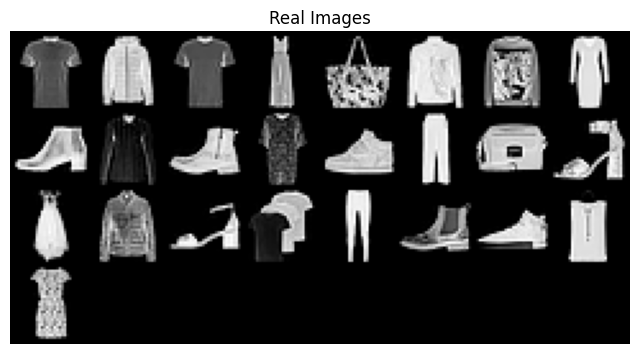

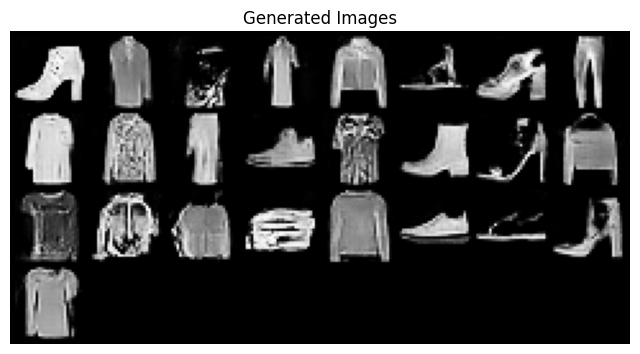

[Epoch 78/80] [Batch 0/469] [D loss: 1.3421906232833862] [G loss: 0.6329160928726196] [D Acc: 0.55859375]
[Epoch 78/80] [Batch 100/469] [D loss: 1.3421945571899414] [G loss: 0.5947374105453491] [D Acc: 0.69921875]
[Epoch 78/80] [Batch 200/469] [D loss: 1.3671207427978516] [G loss: 0.6095802783966064] [D Acc: 0.58984375]
[Epoch 78/80] [Batch 300/469] [D loss: 1.3789278268814087] [G loss: 0.6240192651748657] [D Acc: 0.515625]
[Epoch 78/80] [Batch 400/469] [D loss: 1.3689672946929932] [G loss: 0.5963005423545837] [D Acc: 0.56640625]


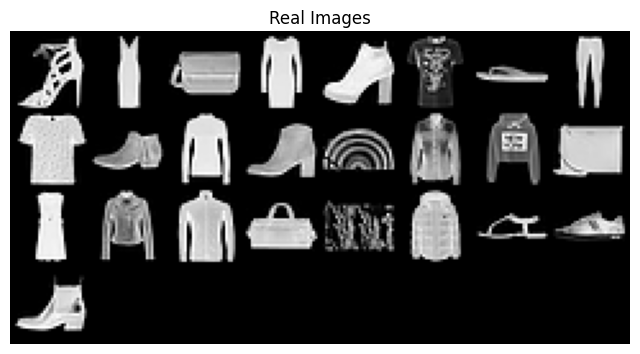

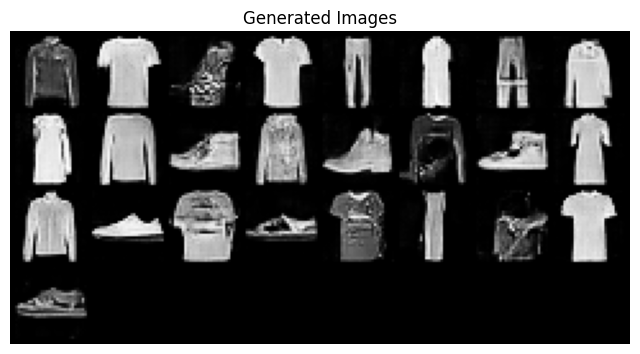

[Epoch 79/80] [Batch 0/469] [D loss: 1.3933954238891602] [G loss: 0.5885035991668701] [D Acc: 0.53515625]
[Epoch 79/80] [Batch 100/469] [D loss: 1.4126205444335938] [G loss: 0.556563138961792] [D Acc: 0.64453125]
[Epoch 79/80] [Batch 200/469] [D loss: 1.3660557270050049] [G loss: 0.6095949411392212] [D Acc: 0.5703125]
[Epoch 79/80] [Batch 300/469] [D loss: 1.356937050819397] [G loss: 0.597797691822052] [D Acc: 0.5625]
[Epoch 79/80] [Batch 400/469] [D loss: 1.394374132156372] [G loss: 0.5132308006286621] [D Acc: 0.80078125]


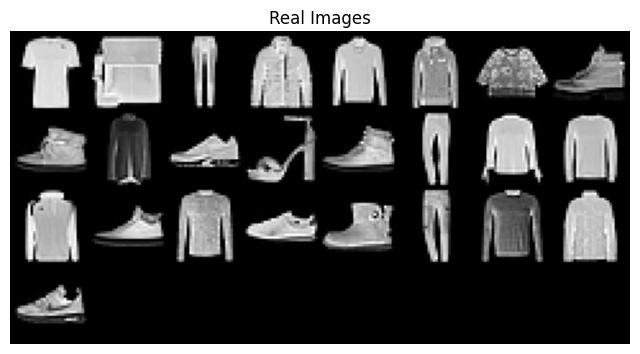

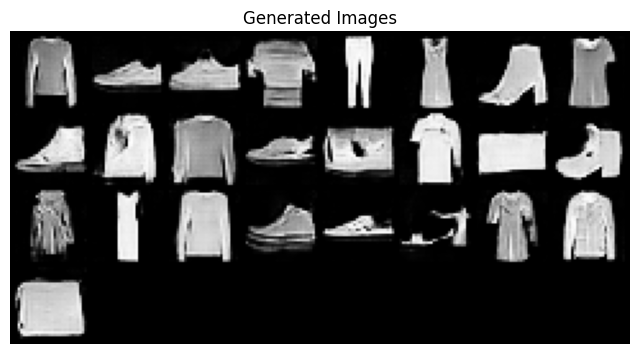

In [48]:
dcgan_generator.apply(weights_init)
dcgan_discriminator.apply(weights_init)
train_dcgan_gp(device, train_loader, dcgan_generator, dcgan_discriminator, epochs=80, lr=0.0001, lambda_gp=10)

[Epoch 0/80] [Batch 0/469] [D loss: 0.15557439625263214] [G loss: 1.678166389465332] [D Acc: 0.6328125]
[Epoch 0/80] [Batch 100/469] [D loss: -14.311671257019043] [G loss: 14.509719848632812] [D Acc: 0.98828125]
[Epoch 0/80] [Batch 200/469] [D loss: -173.53529357910156] [G loss: 166.82461547851562] [D Acc: 1.0]
[Epoch 0/80] [Batch 300/469] [D loss: -387.8735046386719] [G loss: 376.8294372558594] [D Acc: 1.0]
[Epoch 0/80] [Batch 400/469] [D loss: -204.08541870117188] [G loss: 341.6053161621094] [D Acc: 1.0]


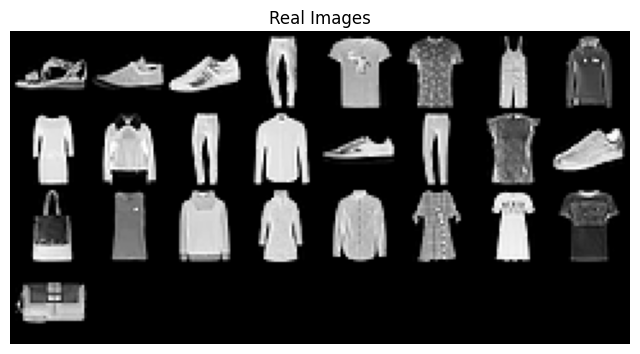

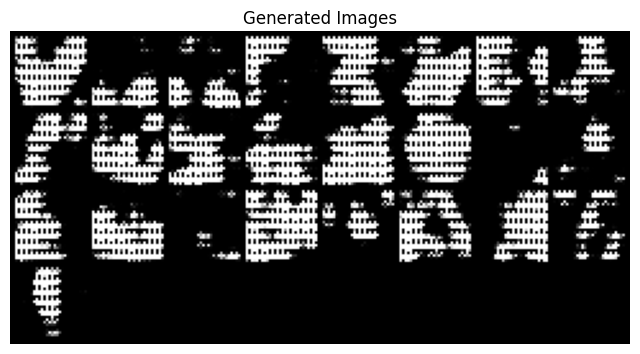

[Epoch 1/80] [Batch 0/469] [D loss: -777.04248046875] [G loss: 767.1884155273438] [D Acc: 1.0]
[Epoch 1/80] [Batch 100/469] [D loss: -926.7520141601562] [G loss: 918.8756103515625] [D Acc: 0.99609375]
[Epoch 1/80] [Batch 200/469] [D loss: -9.040216445922852] [G loss: -42.87561798095703] [D Acc: 0.515625]
[Epoch 1/80] [Batch 300/469] [D loss: -7.759444236755371] [G loss: -32.2894287109375] [D Acc: 0.546875]
[Epoch 1/80] [Batch 400/469] [D loss: -7.535271167755127] [G loss: -38.35193634033203] [D Acc: 0.5234375]


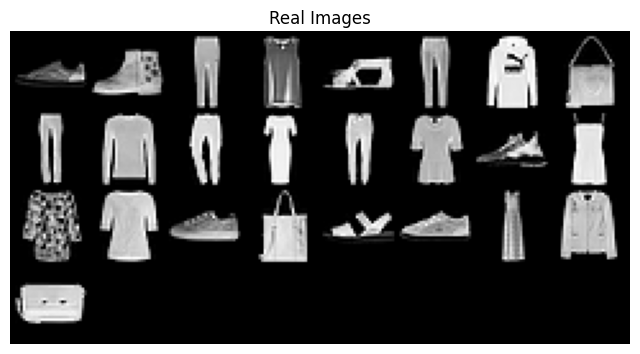

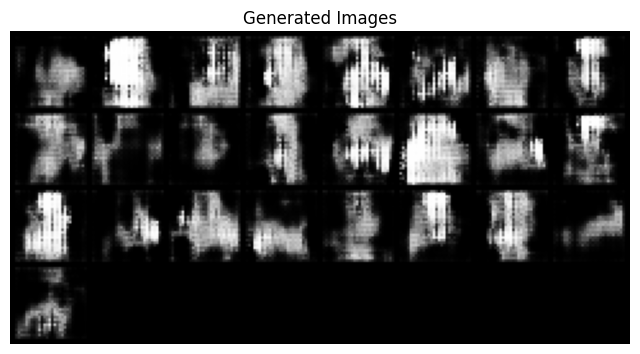

[Epoch 2/80] [Batch 0/469] [D loss: -5.636054992675781] [G loss: -34.42399597167969] [D Acc: 0.53125]
[Epoch 2/80] [Batch 100/469] [D loss: -5.929649353027344] [G loss: -27.36142349243164] [D Acc: 0.49609375]
[Epoch 2/80] [Batch 200/469] [D loss: -9.954316139221191] [G loss: -14.424549102783203] [D Acc: 0.5546875]
[Epoch 2/80] [Batch 300/469] [D loss: -6.314029693603516] [G loss: -10.900243759155273] [D Acc: 0.54296875]
[Epoch 2/80] [Batch 400/469] [D loss: -6.845569133758545] [G loss: -6.724673271179199] [D Acc: 0.59375]


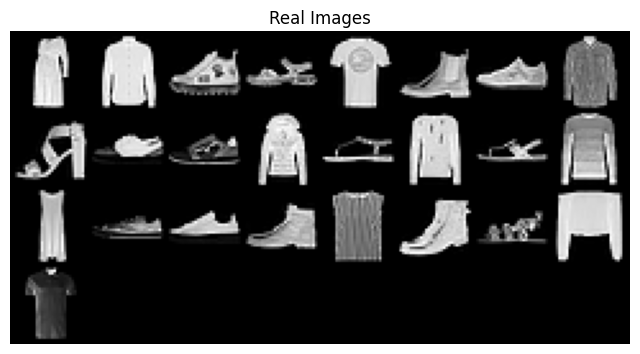

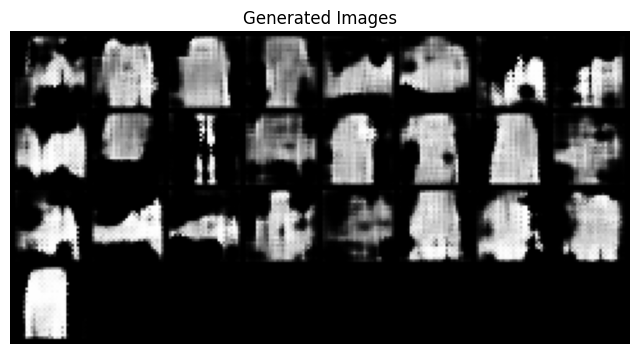

[Epoch 3/80] [Batch 0/469] [D loss: -5.512021064758301] [G loss: 2.4615135192871094] [D Acc: 0.55859375]
[Epoch 3/80] [Batch 100/469] [D loss: -3.313687324523926] [G loss: -1.1285710334777832] [D Acc: 0.5]
[Epoch 3/80] [Batch 200/469] [D loss: -3.764230251312256] [G loss: -0.35362523794174194] [D Acc: 0.54296875]
[Epoch 3/80] [Batch 300/469] [D loss: -2.4353532791137695] [G loss: 5.8958234786987305] [D Acc: 0.6484375]
[Epoch 3/80] [Batch 400/469] [D loss: -4.409853935241699] [G loss: 2.3295698165893555] [D Acc: 0.5625]


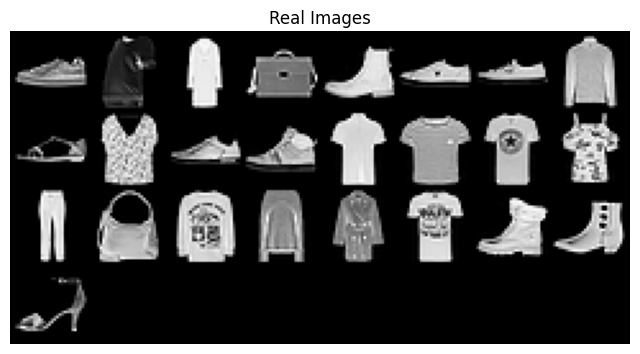

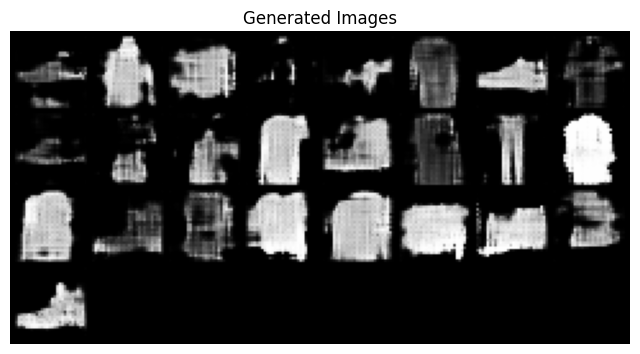

[Epoch 4/80] [Batch 0/469] [D loss: -5.284075736999512] [G loss: 2.02939510345459] [D Acc: 0.609375]
[Epoch 4/80] [Batch 100/469] [D loss: -3.9629640579223633] [G loss: 8.663047790527344] [D Acc: 0.5390625]
[Epoch 4/80] [Batch 200/469] [D loss: -4.584878444671631] [G loss: 6.087077617645264] [D Acc: 0.6015625]
[Epoch 4/80] [Batch 300/469] [D loss: -4.085149765014648] [G loss: 4.037415027618408] [D Acc: 0.515625]
[Epoch 4/80] [Batch 400/469] [D loss: -5.456718921661377] [G loss: 8.457518577575684] [D Acc: 0.546875]


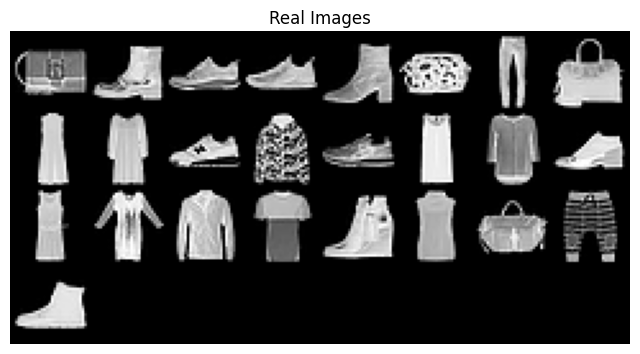

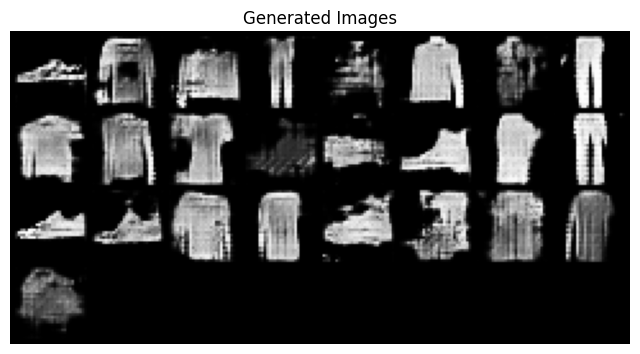

[Epoch 5/80] [Batch 0/469] [D loss: -3.587894916534424] [G loss: 9.620388984680176] [D Acc: 0.515625]
[Epoch 5/80] [Batch 100/469] [D loss: -5.186775207519531] [G loss: 11.097719192504883] [D Acc: 0.66796875]
[Epoch 5/80] [Batch 200/469] [D loss: -4.003211498260498] [G loss: 6.924196243286133] [D Acc: 0.57421875]
[Epoch 5/80] [Batch 300/469] [D loss: -2.7540059089660645] [G loss: 7.139957904815674] [D Acc: 0.515625]
[Epoch 5/80] [Batch 400/469] [D loss: -4.486769199371338] [G loss: 9.29565715789795] [D Acc: 0.5234375]


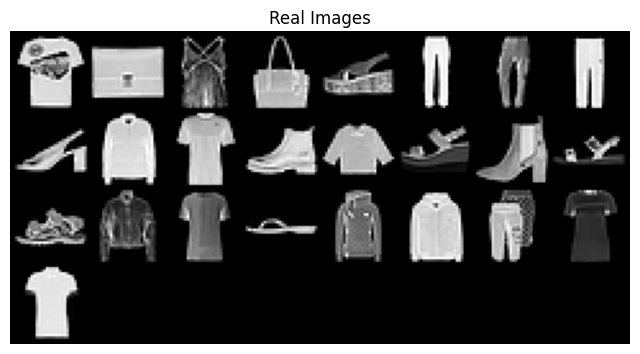

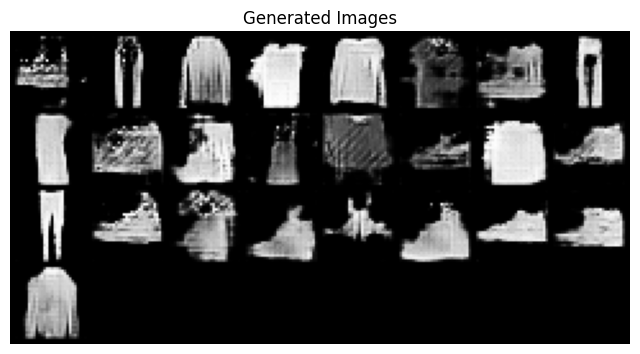

[Epoch 6/80] [Batch 0/469] [D loss: -4.584168434143066] [G loss: 11.756497383117676] [D Acc: 0.59765625]
[Epoch 6/80] [Batch 100/469] [D loss: -3.4306492805480957] [G loss: 14.023666381835938] [D Acc: 0.5390625]
[Epoch 6/80] [Batch 200/469] [D loss: -3.748669385910034] [G loss: 10.602132797241211] [D Acc: 0.55859375]
[Epoch 6/80] [Batch 300/469] [D loss: -6.139583587646484] [G loss: 9.096742630004883] [D Acc: 0.5859375]
[Epoch 6/80] [Batch 400/469] [D loss: -3.8802638053894043] [G loss: 11.711037635803223] [D Acc: 0.64453125]


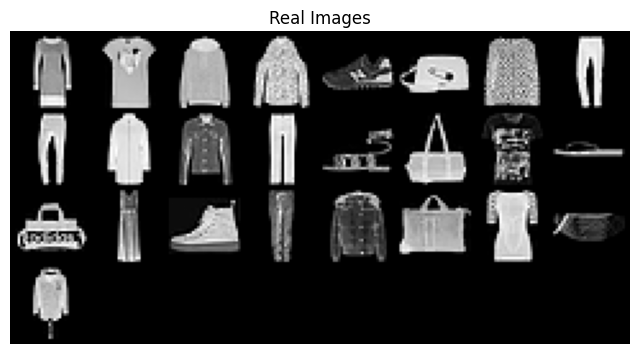

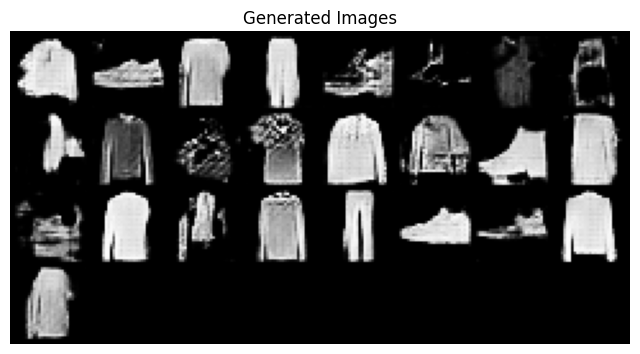

[Epoch 7/80] [Batch 0/469] [D loss: -3.2212767601013184] [G loss: 12.692425727844238] [D Acc: 0.53515625]
[Epoch 7/80] [Batch 100/469] [D loss: -3.379908561706543] [G loss: 10.329625129699707] [D Acc: 0.52734375]
[Epoch 7/80] [Batch 200/469] [D loss: -2.482210636138916] [G loss: 14.836931228637695] [D Acc: 0.51171875]
[Epoch 7/80] [Batch 300/469] [D loss: -3.0961201190948486] [G loss: 11.350777626037598] [D Acc: 0.54296875]
[Epoch 7/80] [Batch 400/469] [D loss: -3.455857276916504] [G loss: 15.945770263671875] [D Acc: 0.54296875]


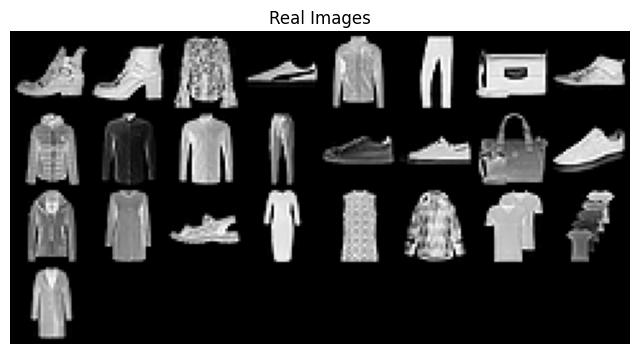

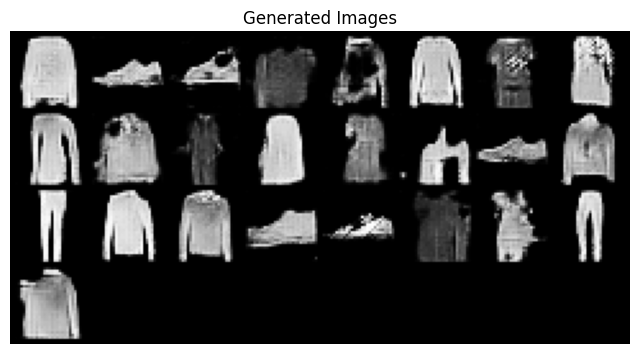

[Epoch 8/80] [Batch 0/469] [D loss: -2.2289624214172363] [G loss: 12.533536911010742] [D Acc: 0.51953125]
[Epoch 8/80] [Batch 100/469] [D loss: -3.6593010425567627] [G loss: 13.558700561523438] [D Acc: 0.5546875]
[Epoch 8/80] [Batch 200/469] [D loss: -2.447699546813965] [G loss: 13.536712646484375] [D Acc: 0.5234375]
[Epoch 8/80] [Batch 300/469] [D loss: -2.392443895339966] [G loss: 12.827653884887695] [D Acc: 0.54296875]
[Epoch 8/80] [Batch 400/469] [D loss: -3.6093506813049316] [G loss: 10.993753433227539] [D Acc: 0.6171875]


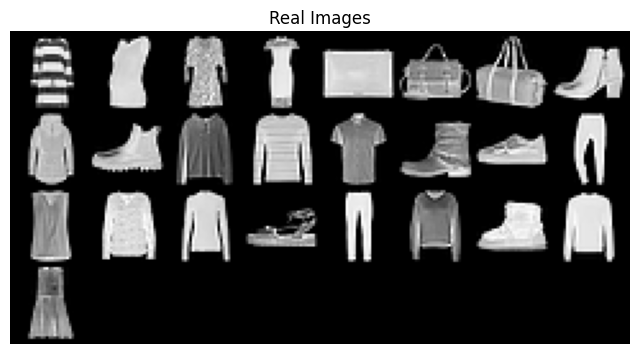

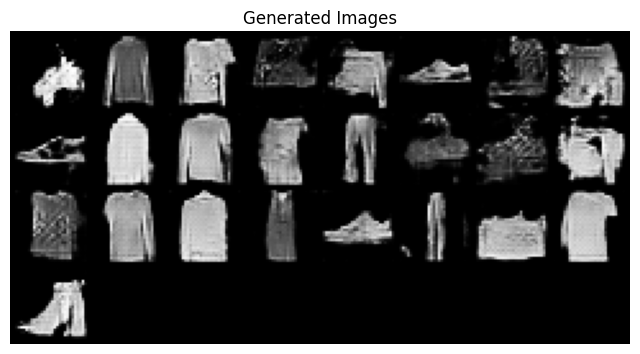

[Epoch 9/80] [Batch 0/469] [D loss: -2.640772581100464] [G loss: 12.22164535522461] [D Acc: 0.5390625]
[Epoch 9/80] [Batch 100/469] [D loss: -4.156182765960693] [G loss: 10.548120498657227] [D Acc: 0.58203125]
[Epoch 9/80] [Batch 200/469] [D loss: -4.977790355682373] [G loss: 12.871380805969238] [D Acc: 0.55859375]
[Epoch 9/80] [Batch 300/469] [D loss: -3.457266330718994] [G loss: 10.860034942626953] [D Acc: 0.53515625]
[Epoch 9/80] [Batch 400/469] [D loss: -6.983700752258301] [G loss: 7.982992172241211] [D Acc: 0.58203125]


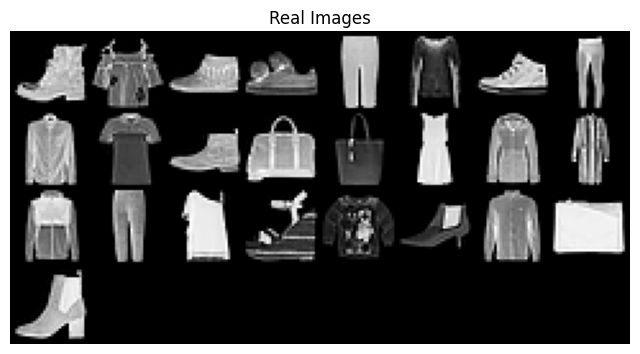

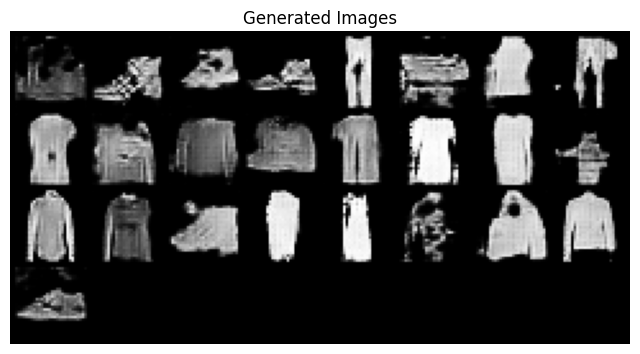

[Epoch 10/80] [Batch 0/469] [D loss: -1.961751103401184] [G loss: 16.08568000793457] [D Acc: 0.51953125]
[Epoch 10/80] [Batch 100/469] [D loss: -4.268257141113281] [G loss: 18.820941925048828] [D Acc: 0.55859375]
[Epoch 10/80] [Batch 200/469] [D loss: -2.1653003692626953] [G loss: 11.769774436950684] [D Acc: 0.6015625]
[Epoch 10/80] [Batch 300/469] [D loss: -4.239550590515137] [G loss: 13.763032913208008] [D Acc: 0.56640625]
[Epoch 10/80] [Batch 400/469] [D loss: -3.659855842590332] [G loss: 12.850975036621094] [D Acc: 0.5546875]


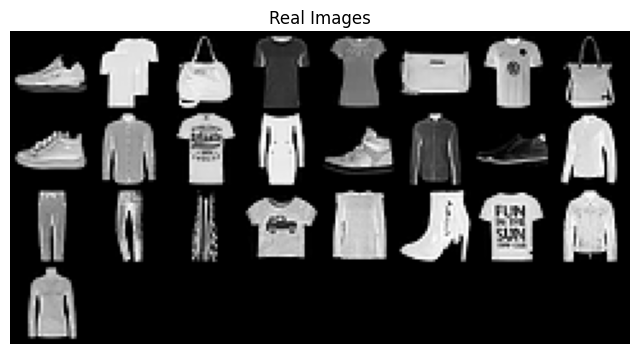

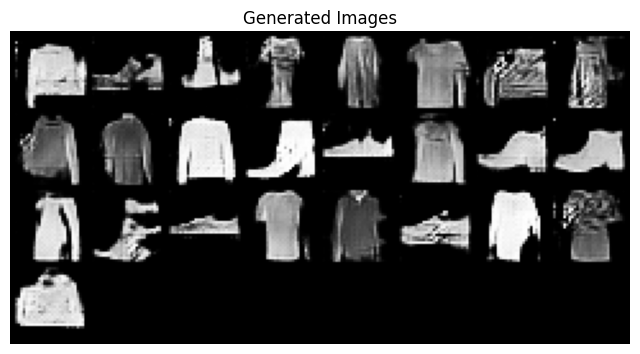

[Epoch 11/80] [Batch 0/469] [D loss: -2.510054111480713] [G loss: 12.681541442871094] [D Acc: 0.546875]
[Epoch 11/80] [Batch 100/469] [D loss: -3.3453333377838135] [G loss: 14.92828369140625] [D Acc: 0.5390625]
[Epoch 11/80] [Batch 200/469] [D loss: -2.898418426513672] [G loss: 16.401981353759766] [D Acc: 0.51171875]
[Epoch 11/80] [Batch 300/469] [D loss: -2.0926196575164795] [G loss: 15.990299224853516] [D Acc: 0.50390625]
[Epoch 11/80] [Batch 400/469] [D loss: -5.316748142242432] [G loss: 25.272796630859375] [D Acc: 0.5625]


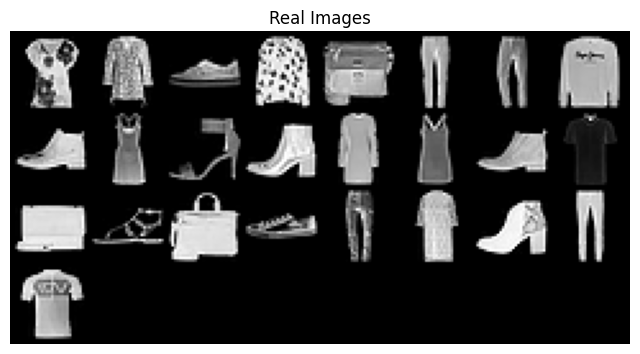

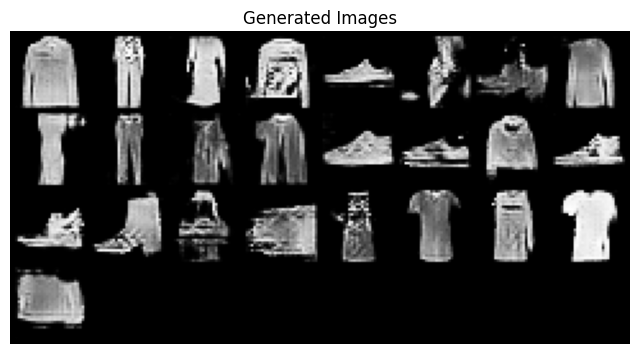

[Epoch 12/80] [Batch 0/469] [D loss: -3.8596935272216797] [G loss: 8.44844913482666] [D Acc: 0.53125]
[Epoch 12/80] [Batch 100/469] [D loss: -2.637542247772217] [G loss: 17.010494232177734] [D Acc: 0.51171875]
[Epoch 12/80] [Batch 200/469] [D loss: -2.9010043144226074] [G loss: 13.783147811889648] [D Acc: 0.6015625]
[Epoch 12/80] [Batch 300/469] [D loss: -3.394815683364868] [G loss: 16.40693473815918] [D Acc: 0.51171875]
[Epoch 12/80] [Batch 400/469] [D loss: -3.9706954956054688] [G loss: 10.522050857543945] [D Acc: 0.52734375]


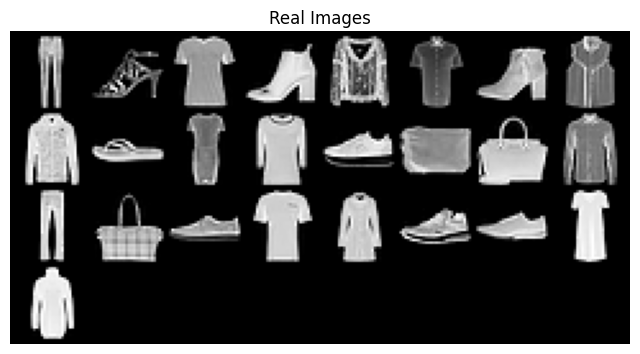

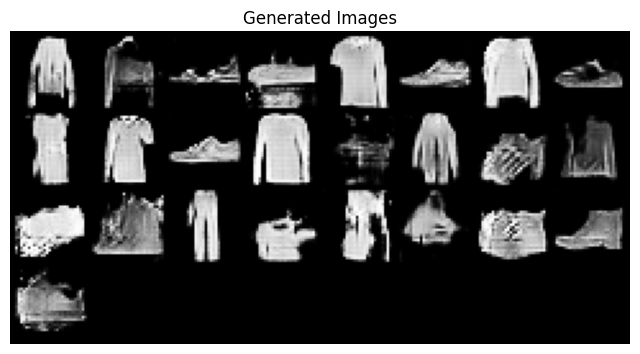

[Epoch 13/80] [Batch 0/469] [D loss: -5.520543098449707] [G loss: 10.548738479614258] [D Acc: 0.58203125]
[Epoch 13/80] [Batch 100/469] [D loss: -2.0071163177490234] [G loss: 12.694698333740234] [D Acc: 0.49609375]
[Epoch 13/80] [Batch 200/469] [D loss: -1.6073575019836426] [G loss: 14.531936645507812] [D Acc: 0.50390625]
[Epoch 13/80] [Batch 300/469] [D loss: -2.6930692195892334] [G loss: 13.738306045532227] [D Acc: 0.515625]
[Epoch 13/80] [Batch 400/469] [D loss: -4.008584976196289] [G loss: 9.917994499206543] [D Acc: 0.52734375]


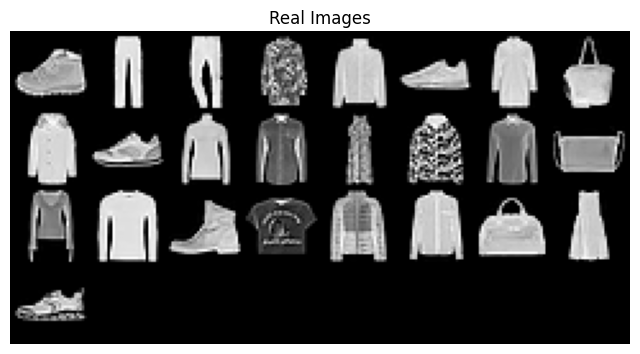

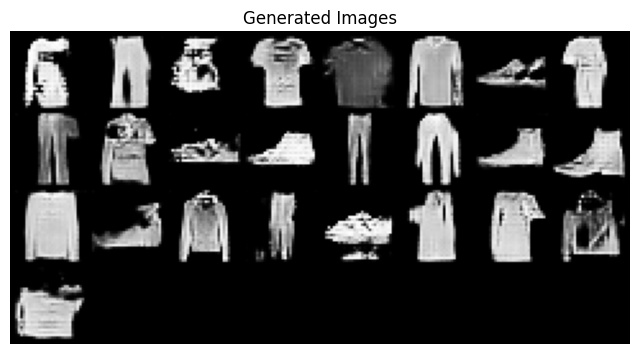

[Epoch 14/80] [Batch 0/469] [D loss: -3.5311272144317627] [G loss: 14.64672565460205] [D Acc: 0.546875]
[Epoch 14/80] [Batch 100/469] [D loss: -3.325228691101074] [G loss: 16.42204475402832] [D Acc: 0.55859375]
[Epoch 14/80] [Batch 200/469] [D loss: -2.5336062908172607] [G loss: 12.247844696044922] [D Acc: 0.5]
[Epoch 14/80] [Batch 300/469] [D loss: -5.551062107086182] [G loss: 18.50727081298828] [D Acc: 0.51953125]
[Epoch 14/80] [Batch 400/469] [D loss: -2.4687490463256836] [G loss: 12.847360610961914] [D Acc: 0.546875]


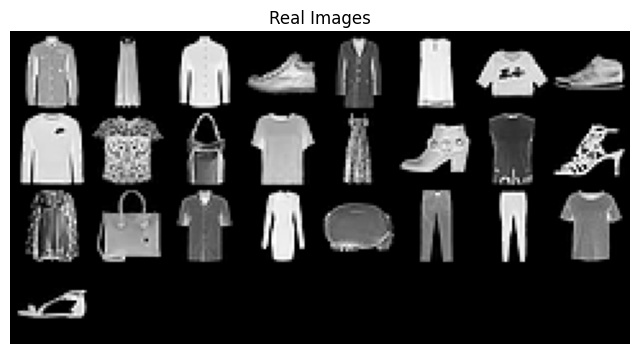

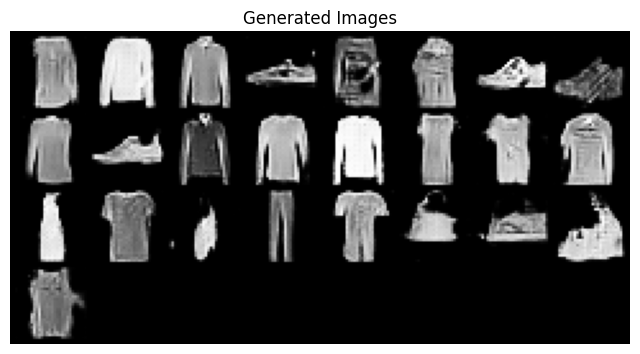

[Epoch 15/80] [Batch 0/469] [D loss: -2.381340265274048] [G loss: 13.081790924072266] [D Acc: 0.515625]
[Epoch 15/80] [Batch 100/469] [D loss: -3.783888578414917] [G loss: 10.01252555847168] [D Acc: 0.5859375]
[Epoch 15/80] [Batch 200/469] [D loss: -3.1794018745422363] [G loss: 19.296260833740234] [D Acc: 0.50390625]
[Epoch 15/80] [Batch 300/469] [D loss: -2.4512295722961426] [G loss: 7.431670665740967] [D Acc: 0.58203125]
[Epoch 15/80] [Batch 400/469] [D loss: -5.034564971923828] [G loss: 7.217962265014648] [D Acc: 0.58984375]


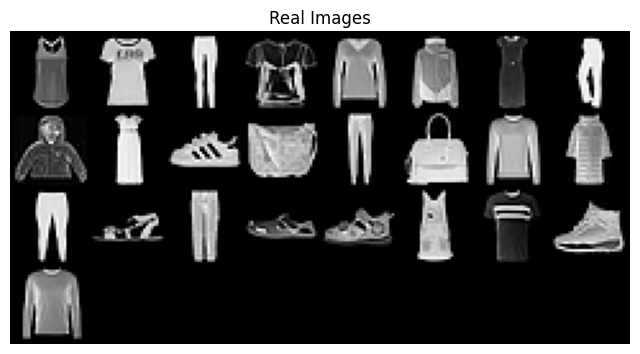

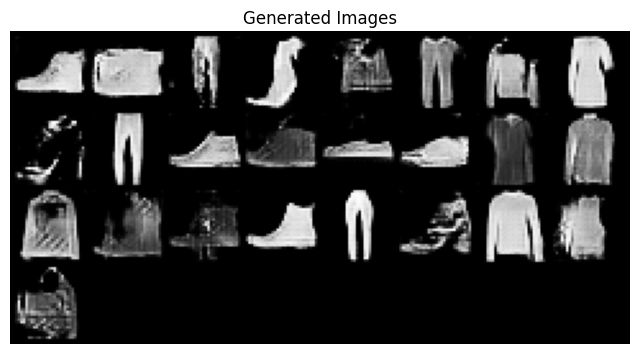

[Epoch 16/80] [Batch 0/469] [D loss: -3.9087202548980713] [G loss: 9.343118667602539] [D Acc: 0.5546875]
[Epoch 16/80] [Batch 100/469] [D loss: -5.789943218231201] [G loss: 8.064096450805664] [D Acc: 0.66796875]
[Epoch 16/80] [Batch 200/469] [D loss: -1.1776292324066162] [G loss: 11.399547576904297] [D Acc: 0.50390625]
[Epoch 16/80] [Batch 300/469] [D loss: -3.0137956142425537] [G loss: 10.67344856262207] [D Acc: 0.53515625]
[Epoch 16/80] [Batch 400/469] [D loss: -6.838943958282471] [G loss: 8.39034366607666] [D Acc: 0.58203125]


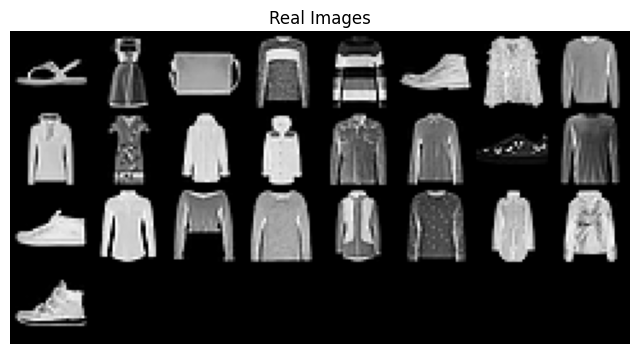

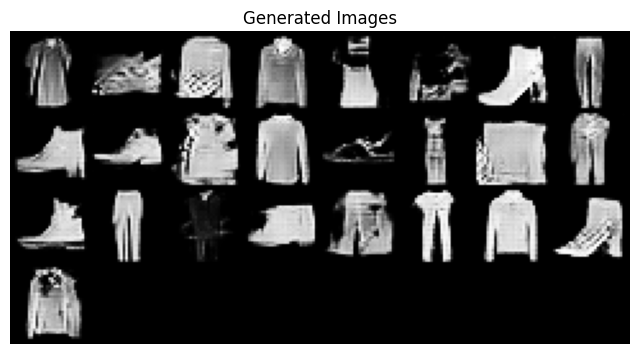

[Epoch 17/80] [Batch 0/469] [D loss: -4.89452600479126] [G loss: 19.63143539428711] [D Acc: 0.5]
[Epoch 17/80] [Batch 100/469] [D loss: -3.8826863765716553] [G loss: 20.056751251220703] [D Acc: 0.5]
[Epoch 17/80] [Batch 200/469] [D loss: -2.6470985412597656] [G loss: 9.605978012084961] [D Acc: 0.56640625]
[Epoch 17/80] [Batch 300/469] [D loss: -5.3905181884765625] [G loss: 10.155267715454102] [D Acc: 0.59765625]
[Epoch 17/80] [Batch 400/469] [D loss: -3.474773645401001] [G loss: 10.94051456451416] [D Acc: 0.51953125]


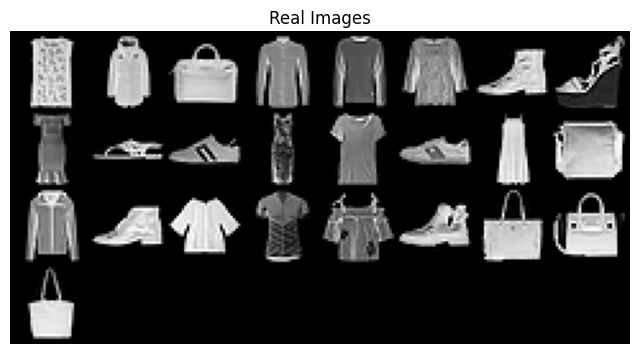

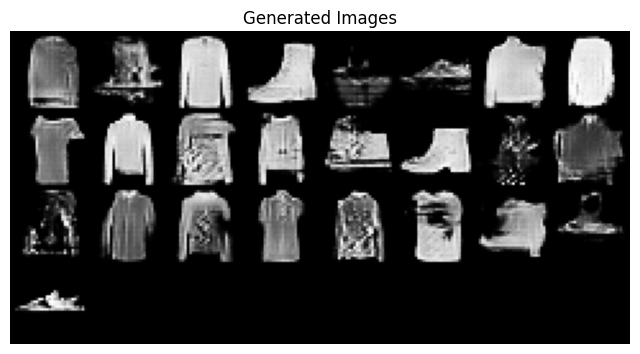

[Epoch 18/80] [Batch 0/469] [D loss: -2.135896682739258] [G loss: 16.372352600097656] [D Acc: 0.5]
[Epoch 18/80] [Batch 100/469] [D loss: 4.270542144775391] [G loss: 8.814546585083008] [D Acc: 0.48828125]
[Epoch 18/80] [Batch 200/469] [D loss: -3.909693479537964] [G loss: 10.976747512817383] [D Acc: 0.55859375]
[Epoch 18/80] [Batch 300/469] [D loss: -3.1039183139801025] [G loss: 11.580978393554688] [D Acc: 0.76171875]
[Epoch 18/80] [Batch 400/469] [D loss: -2.3969593048095703] [G loss: 11.836993217468262] [D Acc: 0.99609375]


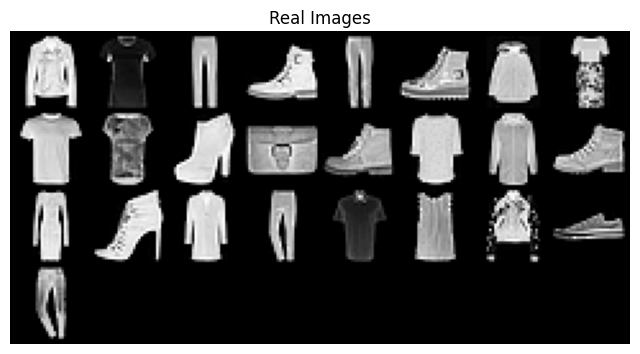

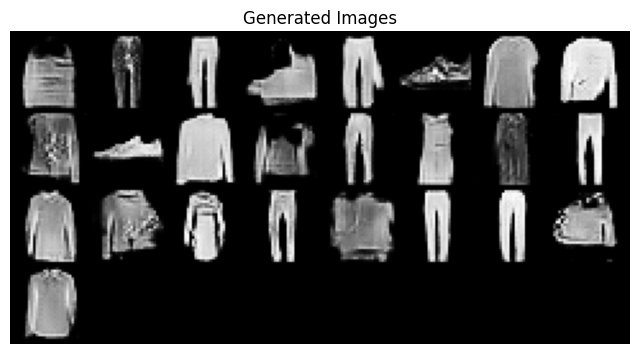

[Epoch 19/80] [Batch 0/469] [D loss: -2.634219169616699] [G loss: 7.953718185424805] [D Acc: 0.984375]
[Epoch 19/80] [Batch 100/469] [D loss: -2.5023508071899414] [G loss: 7.073007583618164] [D Acc: 0.49609375]
[Epoch 19/80] [Batch 200/469] [D loss: -7.7843732833862305] [G loss: 3.039431571960449] [D Acc: 0.671875]
[Epoch 19/80] [Batch 300/469] [D loss: -2.4163107872009277] [G loss: 11.226102828979492] [D Acc: 0.50390625]
[Epoch 19/80] [Batch 400/469] [D loss: -3.2118937969207764] [G loss: 14.456724166870117] [D Acc: 0.51171875]


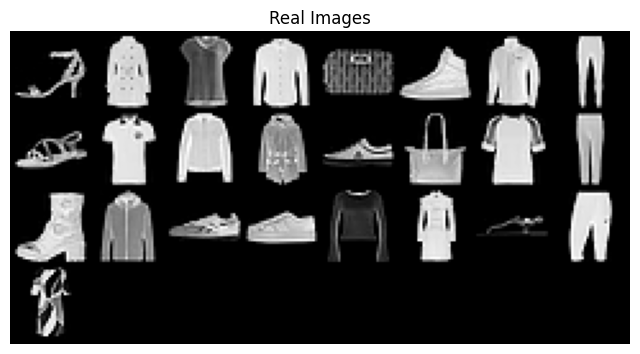

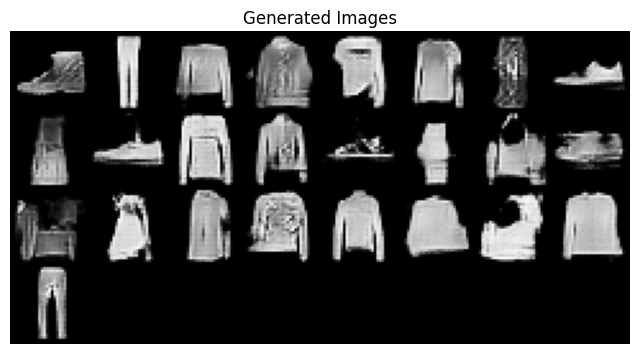

[Epoch 20/80] [Batch 0/469] [D loss: -2.625481367111206] [G loss: 12.016109466552734] [D Acc: 0.52734375]
[Epoch 20/80] [Batch 100/469] [D loss: -6.168318271636963] [G loss: 24.580638885498047] [D Acc: 0.5]
[Epoch 20/80] [Batch 200/469] [D loss: -2.6917824745178223] [G loss: 5.880393028259277] [D Acc: 0.64453125]
[Epoch 20/80] [Batch 300/469] [D loss: -6.339770317077637] [G loss: 5.602649688720703] [D Acc: 0.80859375]
[Epoch 20/80] [Batch 400/469] [D loss: -13.069417953491211] [G loss: 35.23713684082031] [D Acc: 0.5078125]


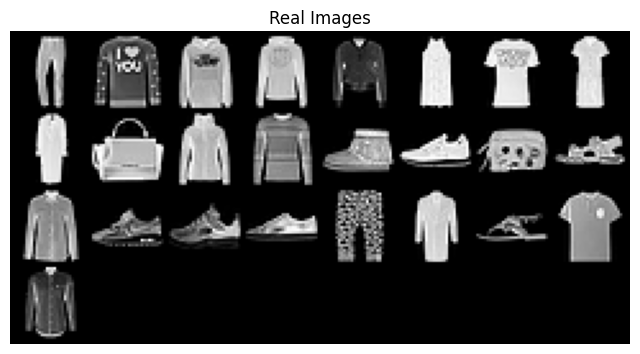

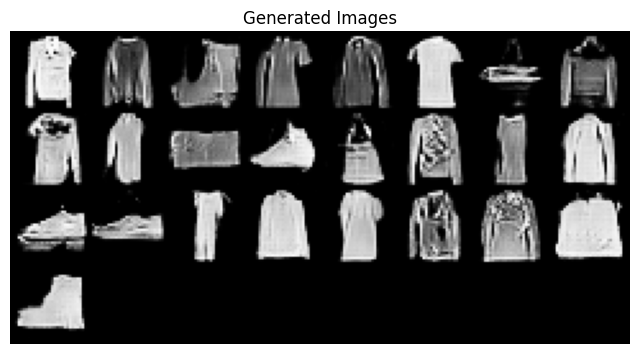

[Epoch 21/80] [Batch 0/469] [D loss: -5.0631022453308105] [G loss: 3.1951231956481934] [D Acc: 0.390625]
[Epoch 21/80] [Batch 100/469] [D loss: -5.6215739250183105] [G loss: 17.718978881835938] [D Acc: 0.53125]
[Epoch 21/80] [Batch 200/469] [D loss: -3.4078731536865234] [G loss: 8.302176475524902] [D Acc: 0.5546875]
[Epoch 21/80] [Batch 300/469] [D loss: -2.297847270965576] [G loss: 6.383425712585449] [D Acc: 0.484375]
[Epoch 21/80] [Batch 400/469] [D loss: -1.4211128950119019] [G loss: 8.087501525878906] [D Acc: 0.5703125]


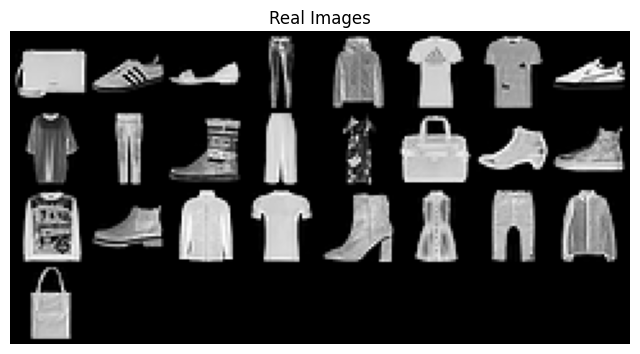

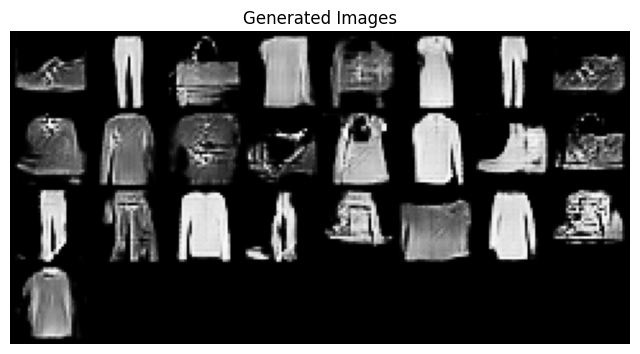

[Epoch 22/80] [Batch 0/469] [D loss: -1.945009708404541] [G loss: 6.239928245544434] [D Acc: 0.578125]
[Epoch 22/80] [Batch 100/469] [D loss: -3.9892044067382812] [G loss: 16.152620315551758] [D Acc: 0.5]
[Epoch 22/80] [Batch 200/469] [D loss: -11.014734268188477] [G loss: 25.625654220581055] [D Acc: 0.5]
[Epoch 22/80] [Batch 300/469] [D loss: -1.8484560251235962] [G loss: 6.713110446929932] [D Acc: 0.5546875]
[Epoch 22/80] [Batch 400/469] [D loss: -5.578888893127441] [G loss: 6.638859748840332] [D Acc: 0.671875]


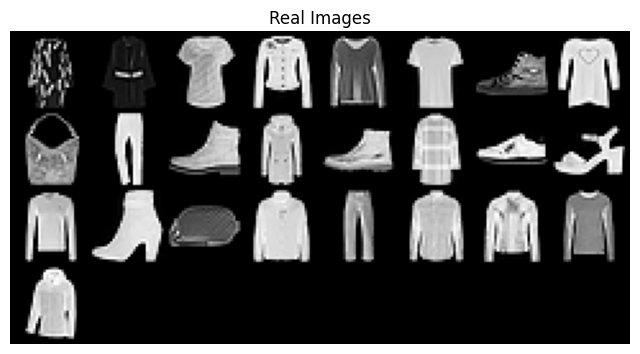

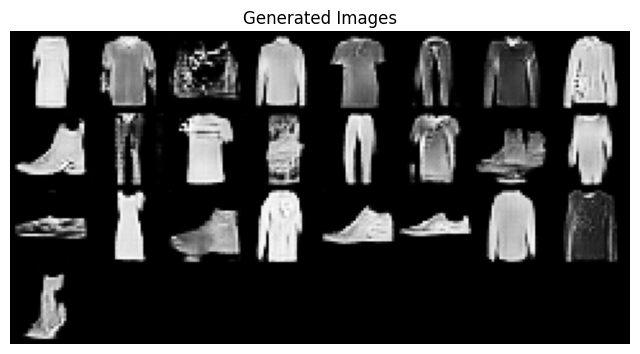

[Epoch 23/80] [Batch 0/469] [D loss: -0.87508225440979] [G loss: 5.467879295349121] [D Acc: 0.7421875]
[Epoch 23/80] [Batch 100/469] [D loss: -2.2598702907562256] [G loss: 8.713834762573242] [D Acc: 0.5234375]
[Epoch 23/80] [Batch 200/469] [D loss: -2.2415683269500732] [G loss: 7.905888557434082] [D Acc: 0.5078125]
[Epoch 23/80] [Batch 300/469] [D loss: -4.763585090637207] [G loss: 9.461216926574707] [D Acc: 0.51953125]
[Epoch 23/80] [Batch 400/469] [D loss: -1.306565284729004] [G loss: 12.623003005981445] [D Acc: 0.50390625]


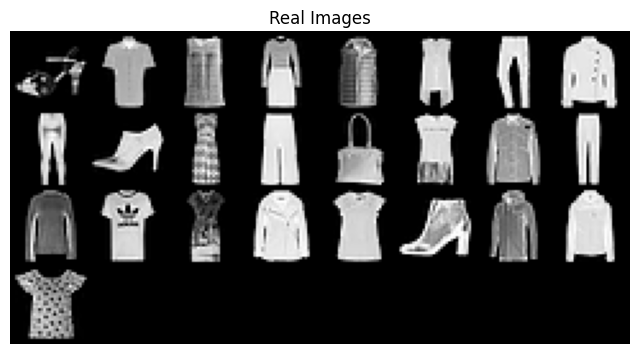

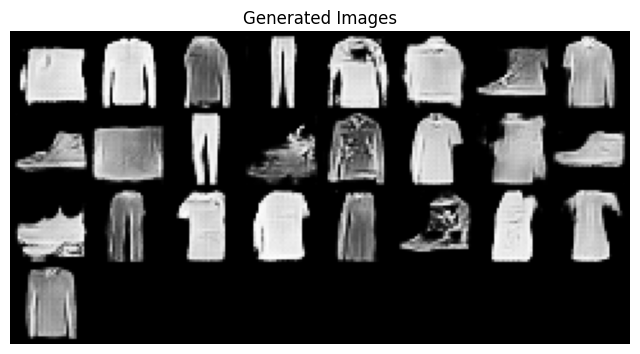

[Epoch 24/80] [Batch 0/469] [D loss: -4.662391662597656] [G loss: 15.271492004394531] [D Acc: 0.5]
[Epoch 24/80] [Batch 100/469] [D loss: -1.1771159172058105] [G loss: 12.386699676513672] [D Acc: 0.5]
[Epoch 24/80] [Batch 200/469] [D loss: -4.361182689666748] [G loss: 9.99299144744873] [D Acc: 0.64453125]
[Epoch 24/80] [Batch 300/469] [D loss: -18.569608688354492] [G loss: 33.68022537231445] [D Acc: 0.5]
[Epoch 24/80] [Batch 400/469] [D loss: -3.262835741043091] [G loss: 10.460046768188477] [D Acc: 0.51953125]


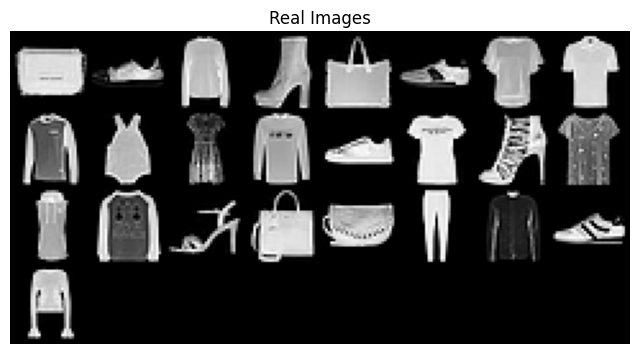

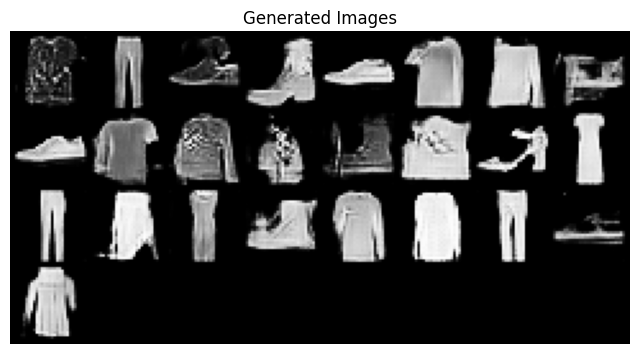

[Epoch 25/80] [Batch 0/469] [D loss: -3.0249171257019043] [G loss: 7.850484371185303] [D Acc: 0.5078125]
[Epoch 25/80] [Batch 100/469] [D loss: -2.7183022499084473] [G loss: 13.734495162963867] [D Acc: 0.5]
[Epoch 25/80] [Batch 200/469] [D loss: -3.514073610305786] [G loss: 11.672111511230469] [D Acc: 0.5234375]
[Epoch 25/80] [Batch 300/469] [D loss: -5.813063144683838] [G loss: 15.18427562713623] [D Acc: 0.69140625]
[Epoch 25/80] [Batch 400/469] [D loss: -3.2032370567321777] [G loss: 15.869231224060059] [D Acc: 0.51171875]


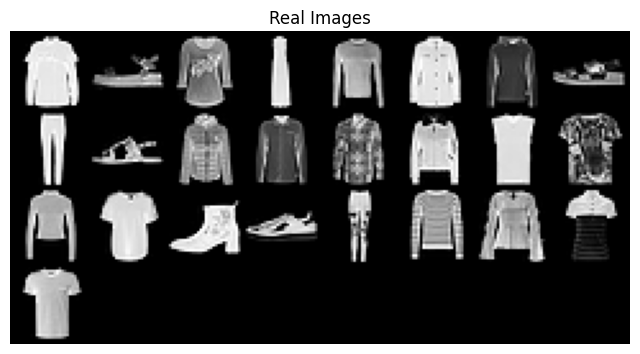

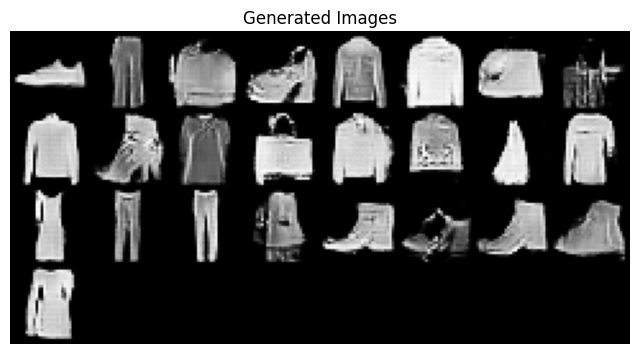

[Epoch 26/80] [Batch 0/469] [D loss: -4.1534576416015625] [G loss: 21.114364624023438] [D Acc: 0.5]
[Epoch 26/80] [Batch 100/469] [D loss: -2.768793821334839] [G loss: 9.727620124816895] [D Acc: 0.5]
[Epoch 26/80] [Batch 200/469] [D loss: -4.365758895874023] [G loss: 11.350418090820312] [D Acc: 0.5]
[Epoch 26/80] [Batch 300/469] [D loss: -6.565505027770996] [G loss: 19.779781341552734] [D Acc: 0.5]
[Epoch 26/80] [Batch 400/469] [D loss: -5.1143975257873535] [G loss: 2.0113720893859863] [D Acc: 0.5859375]


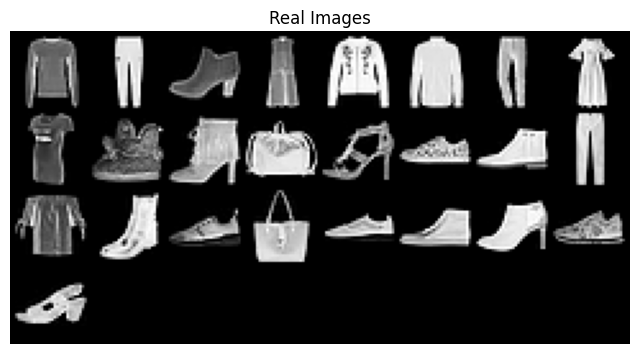

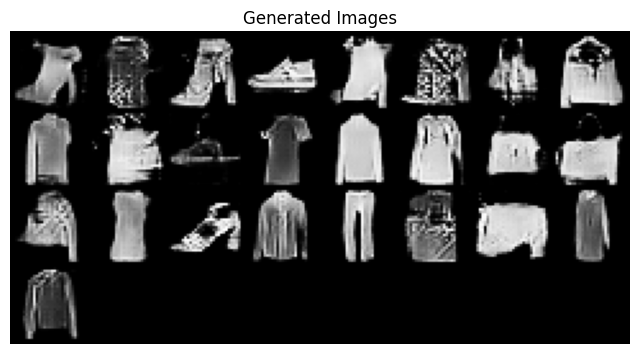

[Epoch 27/80] [Batch 0/469] [D loss: -3.874866008758545] [G loss: 8.863483428955078] [D Acc: 0.515625]
[Epoch 27/80] [Batch 100/469] [D loss: -4.956962585449219] [G loss: 8.802663803100586] [D Acc: 0.8046875]
[Epoch 27/80] [Batch 200/469] [D loss: -2.7918975353240967] [G loss: 12.773645401000977] [D Acc: 0.5]
[Epoch 27/80] [Batch 300/469] [D loss: -6.411209583282471] [G loss: 5.84122896194458] [D Acc: 0.64453125]
[Epoch 27/80] [Batch 400/469] [D loss: -4.514632701873779] [G loss: 15.367002487182617] [D Acc: 0.5]


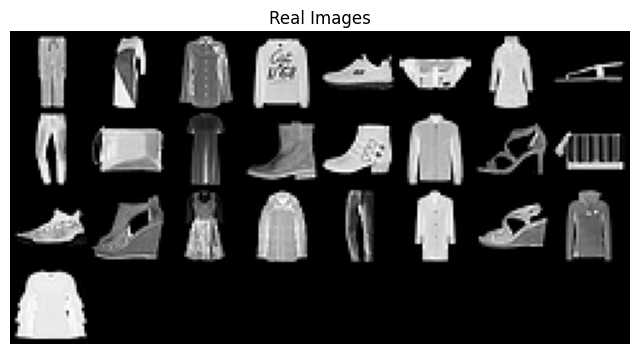

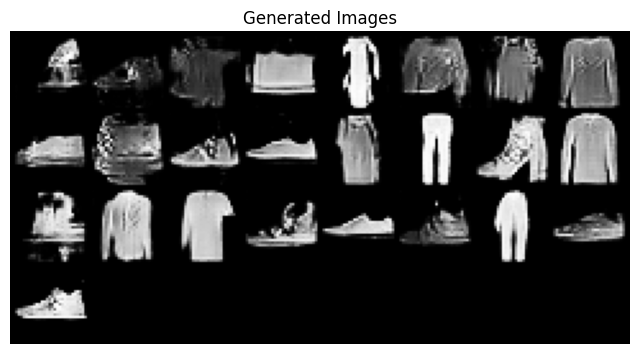

[Epoch 28/80] [Batch 0/469] [D loss: -2.868565559387207] [G loss: 7.659141540527344] [D Acc: 0.6953125]
[Epoch 28/80] [Batch 100/469] [D loss: -11.369355201721191] [G loss: 20.715612411499023] [D Acc: 0.5]
[Epoch 28/80] [Batch 200/469] [D loss: -4.2083024978637695] [G loss: 5.084348678588867] [D Acc: 0.89453125]
[Epoch 28/80] [Batch 300/469] [D loss: -2.8048813343048096] [G loss: 12.089628219604492] [D Acc: 0.515625]
[Epoch 28/80] [Batch 400/469] [D loss: -6.505921363830566] [G loss: 10.112727165222168] [D Acc: 0.5234375]


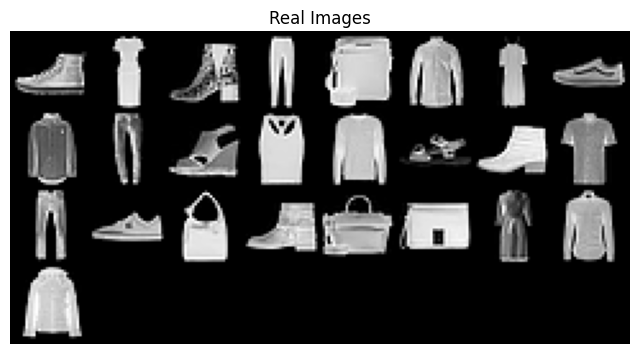

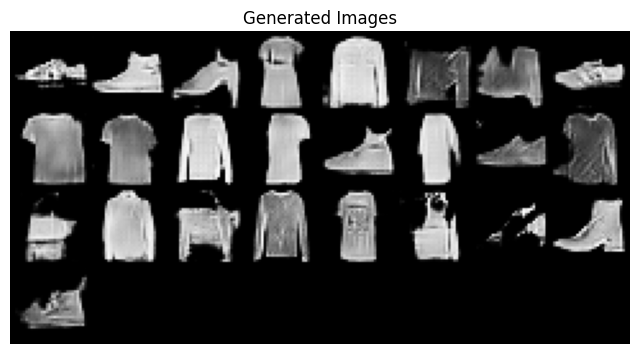

[Epoch 29/80] [Batch 0/469] [D loss: -5.365621089935303] [G loss: 3.378391742706299] [D Acc: 0.59375]
[Epoch 29/80] [Batch 100/469] [D loss: -15.297599792480469] [G loss: -0.9692065119743347] [D Acc: 0.67578125]
[Epoch 29/80] [Batch 200/469] [D loss: -7.706550598144531] [G loss: 22.438278198242188] [D Acc: 0.609375]
[Epoch 29/80] [Batch 300/469] [D loss: -3.6367764472961426] [G loss: 11.397285461425781] [D Acc: 0.63671875]
[Epoch 29/80] [Batch 400/469] [D loss: -2.175719738006592] [G loss: 11.402440071105957] [D Acc: 0.5]


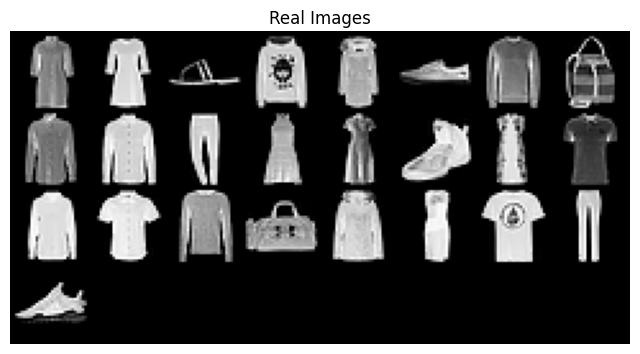

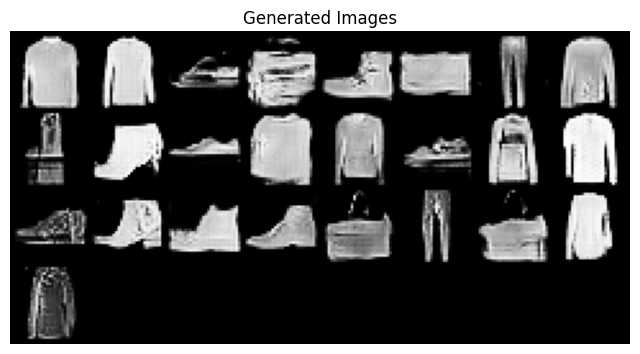

[Epoch 30/80] [Batch 0/469] [D loss: -2.8721699714660645] [G loss: 12.123758316040039] [D Acc: 0.5]
[Epoch 30/80] [Batch 100/469] [D loss: -4.760353088378906] [G loss: 11.574457168579102] [D Acc: 0.5]
[Epoch 30/80] [Batch 200/469] [D loss: -11.018196105957031] [G loss: 12.069822311401367] [D Acc: 1.0]
[Epoch 30/80] [Batch 300/469] [D loss: -3.0963425636291504] [G loss: 13.922839164733887] [D Acc: 0.50390625]
[Epoch 30/80] [Batch 400/469] [D loss: -5.5938005447387695] [G loss: 6.275196075439453] [D Acc: 0.69921875]


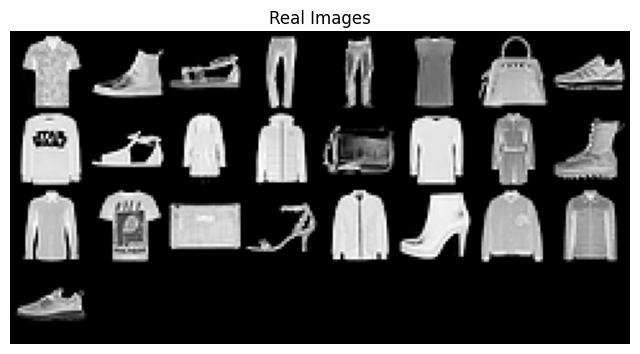

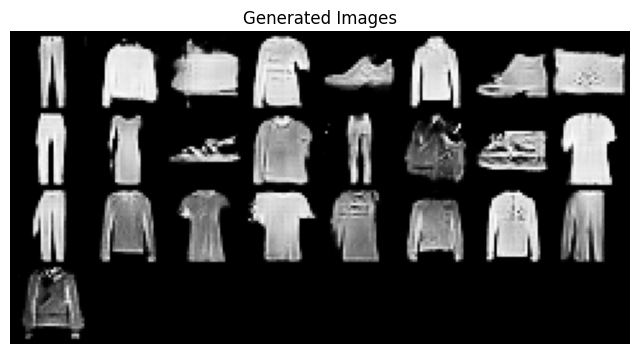

[Epoch 31/80] [Batch 0/469] [D loss: -1.8003251552581787] [G loss: 9.96704387664795] [D Acc: 0.5]
[Epoch 31/80] [Batch 100/469] [D loss: -3.633090019226074] [G loss: 4.338001728057861] [D Acc: 0.59765625]
[Epoch 31/80] [Batch 200/469] [D loss: -2.6190638542175293] [G loss: 8.217435836791992] [D Acc: 0.5625]
[Epoch 31/80] [Batch 300/469] [D loss: -4.266017436981201] [G loss: 3.1166272163391113] [D Acc: 0.80078125]
[Epoch 31/80] [Batch 400/469] [D loss: -2.2527565956115723] [G loss: 4.787868499755859] [D Acc: 0.58203125]


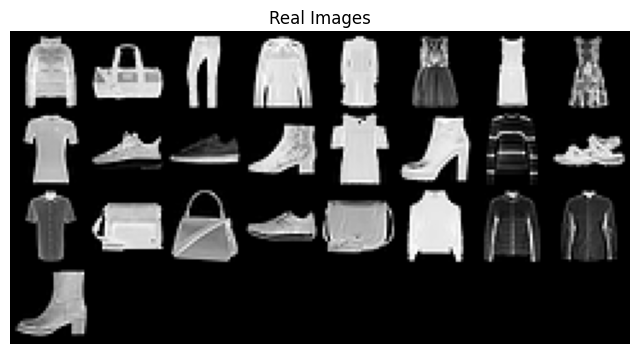

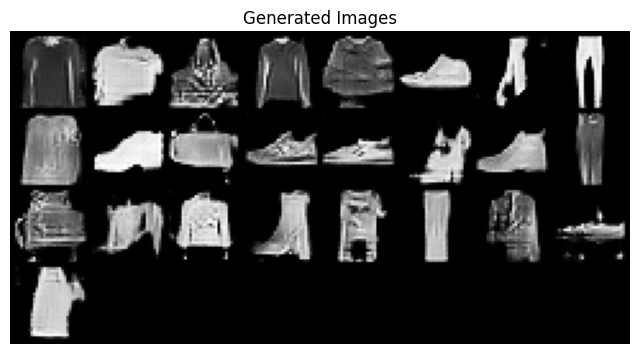

[Epoch 32/80] [Batch 0/469] [D loss: -5.1127190589904785] [G loss: 5.689220428466797] [D Acc: 0.58984375]
[Epoch 32/80] [Batch 100/469] [D loss: -3.7204625606536865] [G loss: 2.577669620513916] [D Acc: 0.68359375]
[Epoch 32/80] [Batch 200/469] [D loss: -5.382168769836426] [G loss: 12.897026062011719] [D Acc: 0.55078125]
[Epoch 32/80] [Batch 300/469] [D loss: -5.24095344543457] [G loss: 6.640143394470215] [D Acc: 0.9921875]
[Epoch 32/80] [Batch 400/469] [D loss: -1.2431228160858154] [G loss: 6.585026741027832] [D Acc: 0.52734375]


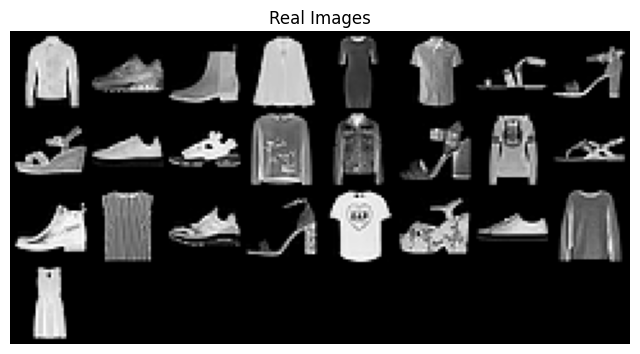

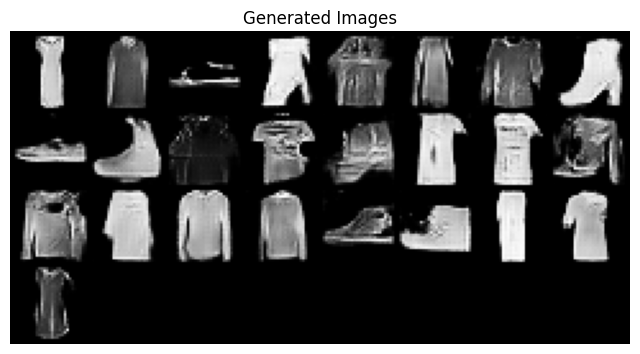

[Epoch 33/80] [Batch 0/469] [D loss: -2.574705123901367] [G loss: 10.81883430480957] [D Acc: 0.5]
[Epoch 33/80] [Batch 100/469] [D loss: -3.9306023120880127] [G loss: 3.3071889877319336] [D Acc: 0.765625]
[Epoch 33/80] [Batch 200/469] [D loss: -4.187799453735352] [G loss: 2.7471065521240234] [D Acc: 0.62890625]
[Epoch 33/80] [Batch 300/469] [D loss: -3.0436389446258545] [G loss: 10.93851089477539] [D Acc: 0.515625]
[Epoch 33/80] [Batch 400/469] [D loss: -1.2133413553237915] [G loss: 4.080802917480469] [D Acc: 0.55078125]


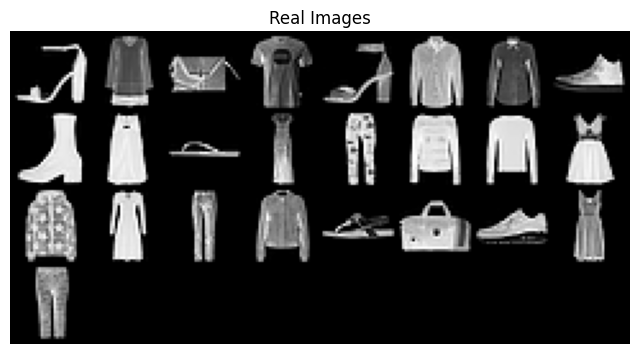

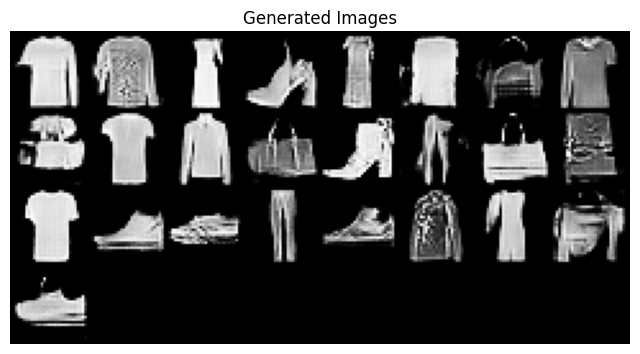

[Epoch 34/80] [Batch 0/469] [D loss: -3.148048162460327] [G loss: 8.698036193847656] [D Acc: 0.6171875]
[Epoch 34/80] [Batch 100/469] [D loss: -2.4549522399902344] [G loss: 8.913204193115234] [D Acc: 0.53125]
[Epoch 34/80] [Batch 200/469] [D loss: -2.109334707260132] [G loss: 10.677173614501953] [D Acc: 0.5078125]
[Epoch 34/80] [Batch 300/469] [D loss: -4.121901988983154] [G loss: -2.0640647411346436] [D Acc: 0.625]
[Epoch 34/80] [Batch 400/469] [D loss: -7.707604885101318] [G loss: 19.96910285949707] [D Acc: 0.57421875]


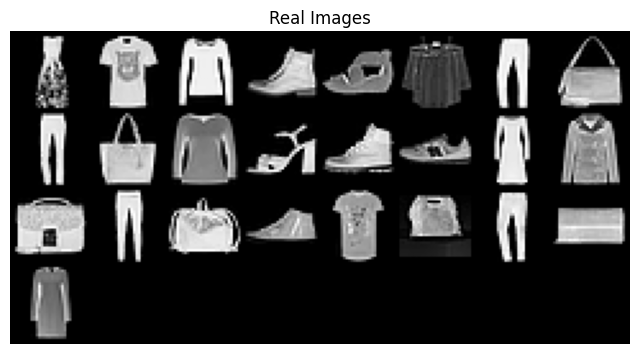

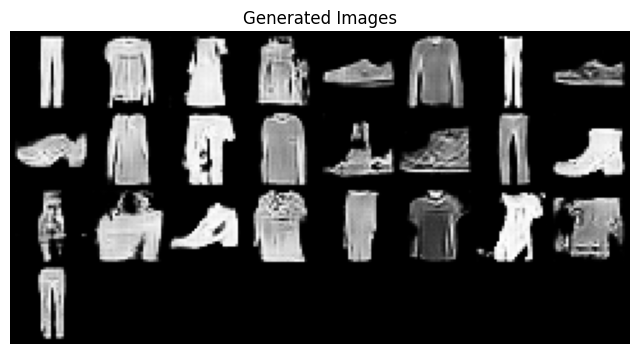

[Epoch 35/80] [Batch 0/469] [D loss: -1.1071100234985352] [G loss: 10.556753158569336] [D Acc: 0.5]
[Epoch 35/80] [Batch 100/469] [D loss: -7.09720516204834] [G loss: 14.776243209838867] [D Acc: 0.56640625]
[Epoch 35/80] [Batch 200/469] [D loss: -17.646713256835938] [G loss: 0.4671081006526947] [D Acc: 0.73046875]
[Epoch 35/80] [Batch 300/469] [D loss: -1.28450345993042] [G loss: 5.540748119354248] [D Acc: 0.5390625]
[Epoch 35/80] [Batch 400/469] [D loss: -11.68336296081543] [G loss: 34.600093841552734] [D Acc: 0.5]


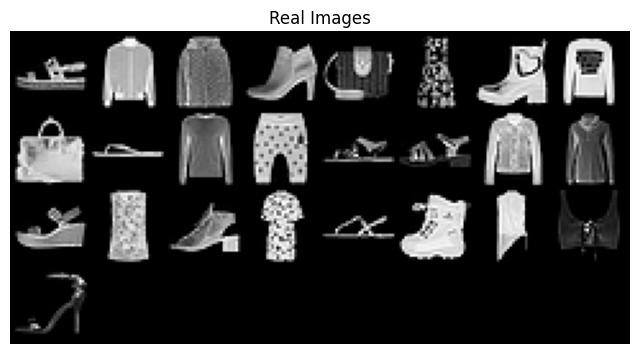

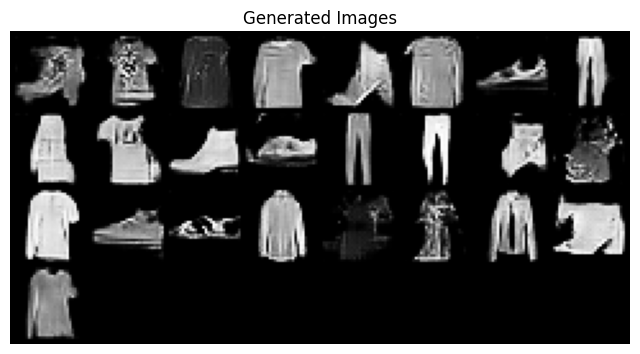

[Epoch 36/80] [Batch 0/469] [D loss: -12.021445274353027] [G loss: 2.477498769760132] [D Acc: 0.8046875]
[Epoch 36/80] [Batch 100/469] [D loss: -10.763067245483398] [G loss: 2.0248916149139404] [D Acc: 0.796875]
[Epoch 36/80] [Batch 200/469] [D loss: -2.081700563430786] [G loss: 8.897154808044434] [D Acc: 0.53125]
[Epoch 36/80] [Batch 300/469] [D loss: -3.7134647369384766] [G loss: 9.482975006103516] [D Acc: 0.62109375]
[Epoch 36/80] [Batch 400/469] [D loss: -6.315613746643066] [G loss: 1.479616403579712] [D Acc: 0.66015625]


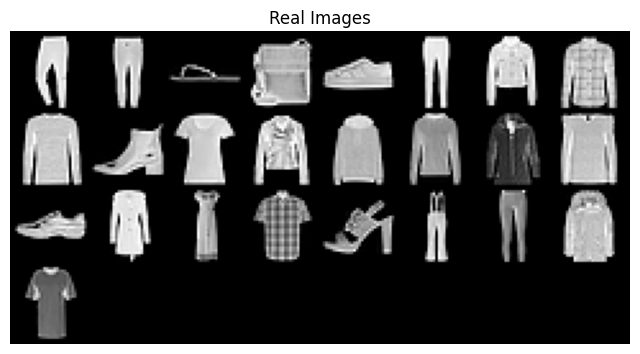

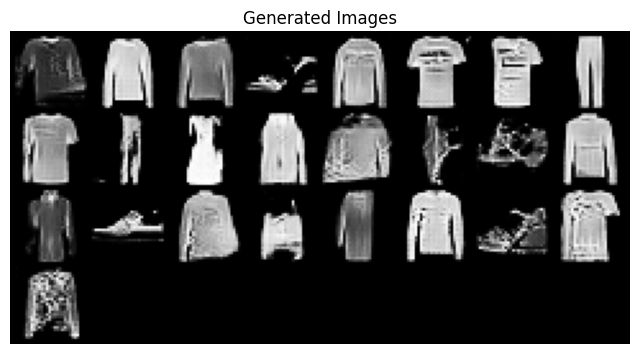

[Epoch 37/80] [Batch 0/469] [D loss: -2.3023669719696045] [G loss: 4.747415065765381] [D Acc: 0.55078125]
[Epoch 37/80] [Batch 100/469] [D loss: 21.77326011657715] [G loss: 4.689844131469727] [D Acc: 0.48046875]
[Epoch 37/80] [Batch 200/469] [D loss: -7.1683478355407715] [G loss: 13.901296615600586] [D Acc: 0.59765625]
[Epoch 37/80] [Batch 300/469] [D loss: -2.63431453704834] [G loss: 14.099649429321289] [D Acc: 0.5]
[Epoch 37/80] [Batch 400/469] [D loss: -21.37734603881836] [G loss: -3.6688103675842285] [D Acc: 0.66015625]


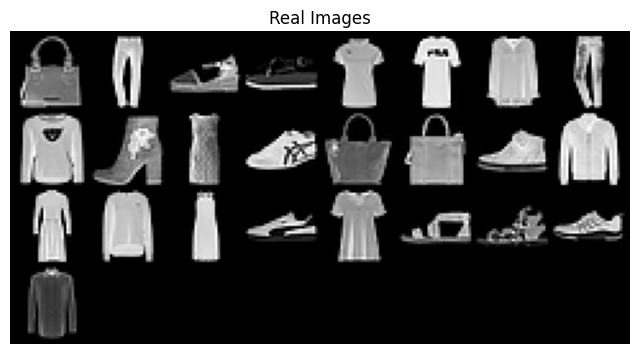

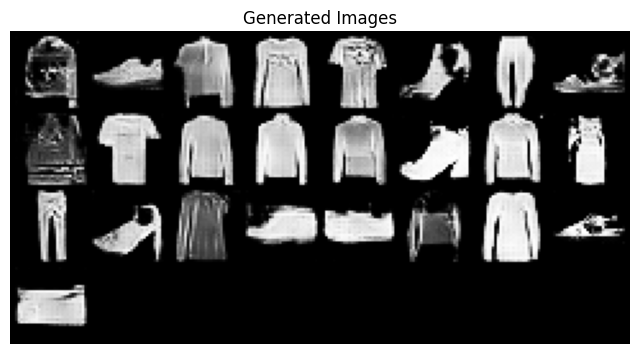

[Epoch 38/80] [Batch 0/469] [D loss: -13.396446228027344] [G loss: 26.7991943359375] [D Acc: 0.50390625]
[Epoch 38/80] [Batch 100/469] [D loss: -1.464200496673584] [G loss: 13.728139877319336] [D Acc: 0.5]
[Epoch 38/80] [Batch 200/469] [D loss: -1.6709017753601074] [G loss: -1.6991651058197021] [D Acc: 0.5390625]
[Epoch 38/80] [Batch 300/469] [D loss: -3.8094921112060547] [G loss: 3.3015708923339844] [D Acc: 0.64453125]
[Epoch 38/80] [Batch 400/469] [D loss: -12.14988899230957] [G loss: -2.900722026824951] [D Acc: 0.640625]


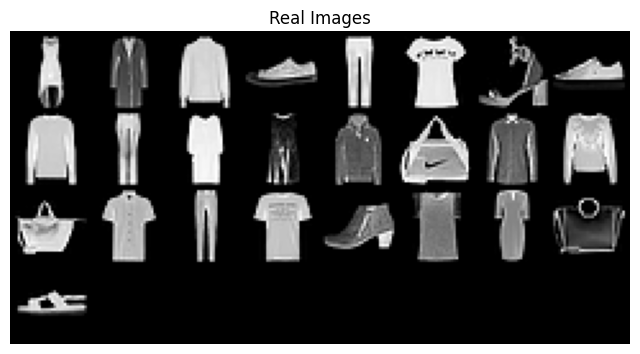

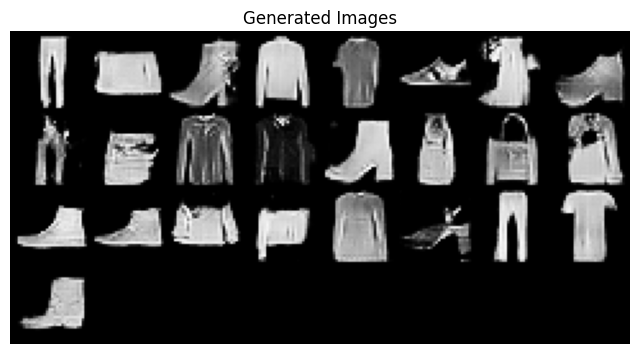

[Epoch 39/80] [Batch 0/469] [D loss: -3.9265406131744385] [G loss: 10.262578964233398] [D Acc: 0.50390625]
[Epoch 39/80] [Batch 100/469] [D loss: -8.129023551940918] [G loss: 18.22894287109375] [D Acc: 0.5]
[Epoch 39/80] [Batch 200/469] [D loss: -3.6837267875671387] [G loss: 2.7948904037475586] [D Acc: 0.765625]
[Epoch 39/80] [Batch 300/469] [D loss: -12.217523574829102] [G loss: 37.390594482421875] [D Acc: 0.5]
[Epoch 39/80] [Batch 400/469] [D loss: -5.45864725112915] [G loss: -14.926233291625977] [D Acc: 0.515625]


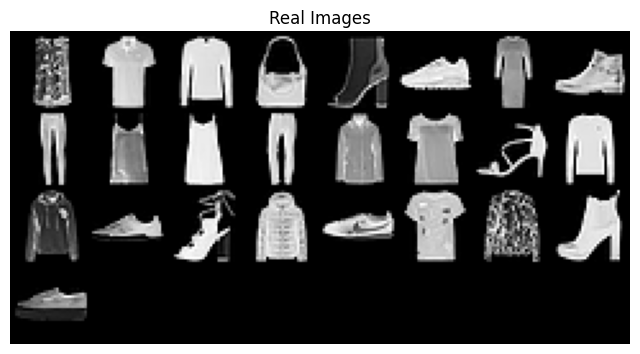

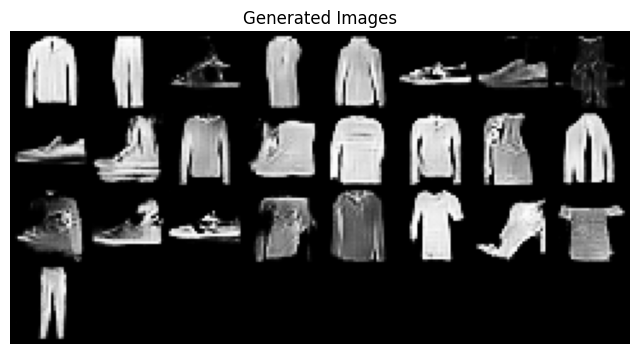

[Epoch 40/80] [Batch 0/469] [D loss: -0.14483070373535156] [G loss: 10.072410583496094] [D Acc: 0.5]
[Epoch 40/80] [Batch 100/469] [D loss: -18.53679847717285] [G loss: 0.566214919090271] [D Acc: 0.7734375]
[Epoch 40/80] [Batch 200/469] [D loss: -5.832303047180176] [G loss: 6.38126277923584] [D Acc: 0.859375]
[Epoch 40/80] [Batch 300/469] [D loss: -9.059586524963379] [G loss: -1.96011483669281] [D Acc: 0.62890625]
[Epoch 40/80] [Batch 400/469] [D loss: -8.546280860900879] [G loss: 24.273990631103516] [D Acc: 0.57421875]


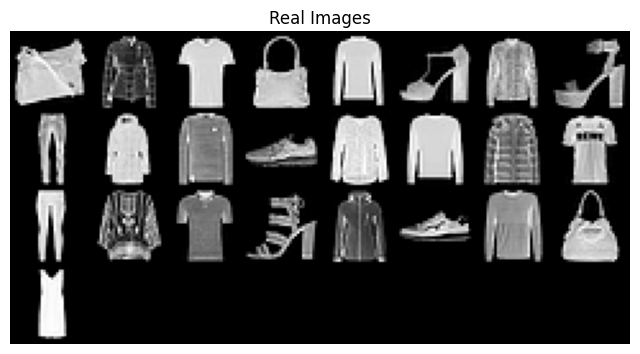

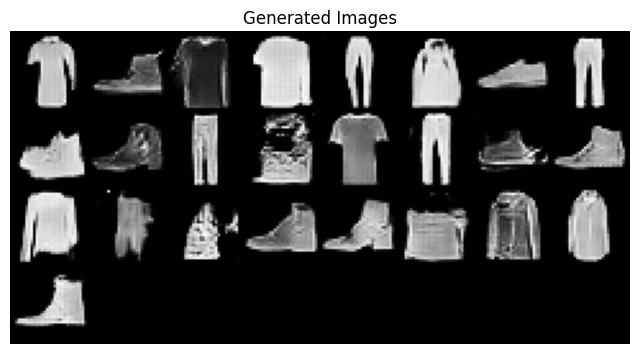

[Epoch 41/80] [Batch 0/469] [D loss: -1.5411860942840576] [G loss: 7.405464172363281] [D Acc: 0.54296875]
[Epoch 41/80] [Batch 100/469] [D loss: -8.70822525024414] [G loss: 2.6734187602996826] [D Acc: 0.734375]
[Epoch 41/80] [Batch 200/469] [D loss: -3.2790112495422363] [G loss: 16.453502655029297] [D Acc: 0.5]
[Epoch 41/80] [Batch 300/469] [D loss: -23.655960083007812] [G loss: -3.1136059761047363] [D Acc: 0.640625]
[Epoch 41/80] [Batch 400/469] [D loss: -10.150894165039062] [G loss: 15.86320686340332] [D Acc: 0.765625]


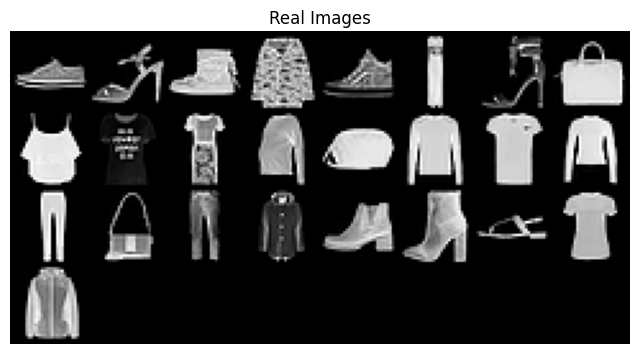

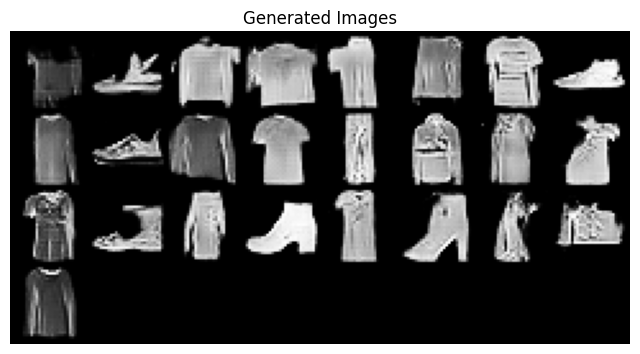

[Epoch 42/80] [Batch 0/469] [D loss: -2.7696704864501953] [G loss: 4.503823280334473] [D Acc: 0.5234375]
[Epoch 42/80] [Batch 100/469] [D loss: -8.848938941955566] [G loss: 21.390666961669922] [D Acc: 0.7109375]
[Epoch 42/80] [Batch 200/469] [D loss: -4.5738019943237305] [G loss: -6.1667094230651855] [D Acc: 0.53515625]
[Epoch 42/80] [Batch 300/469] [D loss: -1.4058560132980347] [G loss: 7.93311882019043] [D Acc: 0.5]
[Epoch 42/80] [Batch 400/469] [D loss: -5.951507568359375] [G loss: 5.645883560180664] [D Acc: 0.69140625]


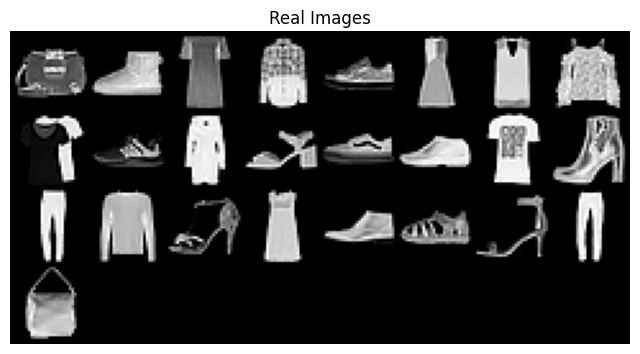

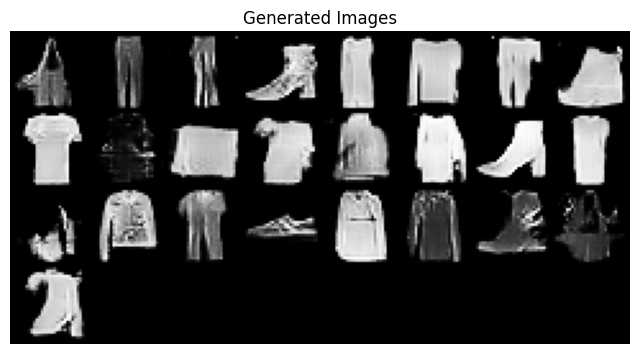

[Epoch 43/80] [Batch 0/469] [D loss: -3.341737747192383] [G loss: 3.192145586013794] [D Acc: 0.84375]
[Epoch 43/80] [Batch 100/469] [D loss: -5.208138942718506] [G loss: 6.949760437011719] [D Acc: 0.515625]
[Epoch 43/80] [Batch 200/469] [D loss: -4.333203315734863] [G loss: -0.4207877218723297] [D Acc: 0.53125]
[Epoch 43/80] [Batch 300/469] [D loss: 5.913341999053955] [G loss: -6.617480278015137] [D Acc: 0.4921875]
[Epoch 43/80] [Batch 400/469] [D loss: -2.7313103675842285] [G loss: 5.151664733886719] [D Acc: 0.83203125]


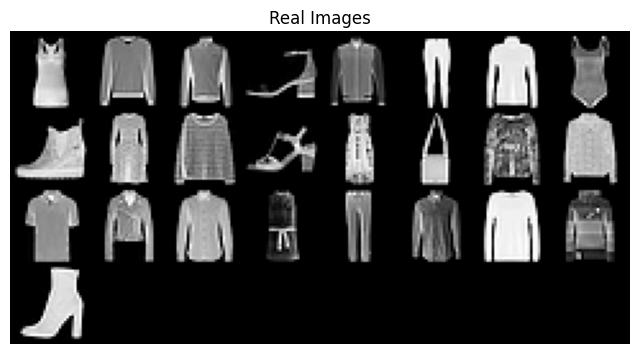

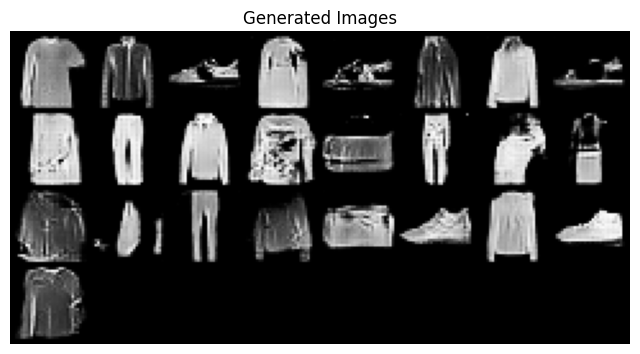

[Epoch 44/80] [Batch 0/469] [D loss: -16.934236526489258] [G loss: 8.806764602661133] [D Acc: 0.984375]
[Epoch 44/80] [Batch 100/469] [D loss: -8.780345916748047] [G loss: -0.5239017009735107] [D Acc: 0.65234375]
[Epoch 44/80] [Batch 200/469] [D loss: -1.443596363067627] [G loss: -0.07806804776191711] [D Acc: 0.6171875]
[Epoch 44/80] [Batch 300/469] [D loss: -13.100724220275879] [G loss: -7.5578932762146] [D Acc: 0.55859375]
[Epoch 44/80] [Batch 400/469] [D loss: -11.66983699798584] [G loss: 15.441181182861328] [D Acc: 0.50390625]


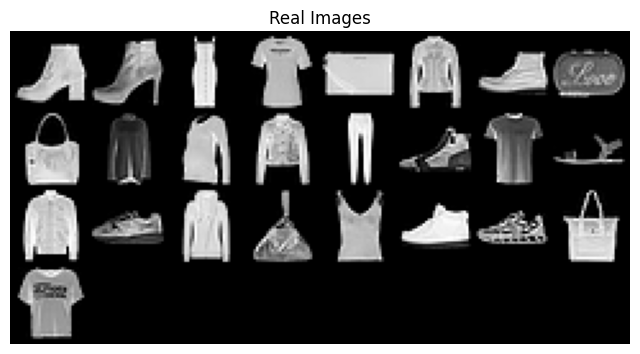

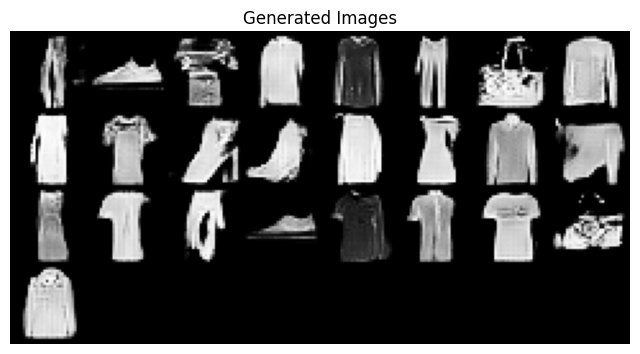

[Epoch 45/80] [Batch 0/469] [D loss: -0.1389908790588379] [G loss: -9.593913078308105] [D Acc: 0.49609375]
[Epoch 45/80] [Batch 100/469] [D loss: -7.423279762268066] [G loss: 2.0892627239227295] [D Acc: 0.81640625]
[Epoch 45/80] [Batch 200/469] [D loss: -8.276399612426758] [G loss: 0.22160661220550537] [D Acc: 0.69140625]
[Epoch 45/80] [Batch 300/469] [D loss: -4.355906963348389] [G loss: 14.501691818237305] [D Acc: 0.5]
[Epoch 45/80] [Batch 400/469] [D loss: -1.961532473564148] [G loss: 2.3529341220855713] [D Acc: 0.5859375]


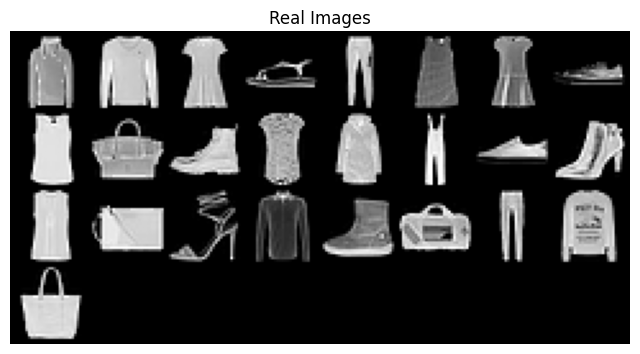

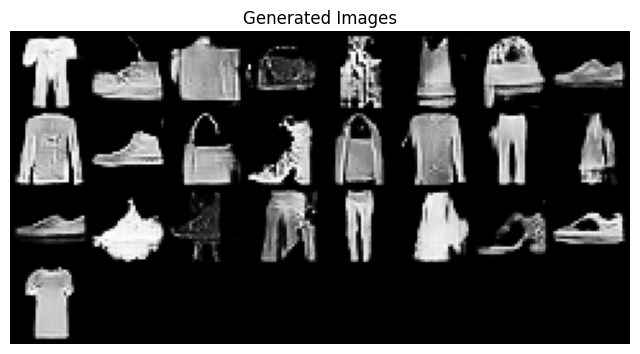

[Epoch 46/80] [Batch 0/469] [D loss: -3.611443519592285] [G loss: 10.739980697631836] [D Acc: 0.546875]
[Epoch 46/80] [Batch 100/469] [D loss: -9.711069107055664] [G loss: 12.370376586914062] [D Acc: 0.89453125]
[Epoch 46/80] [Batch 200/469] [D loss: -9.66956615447998] [G loss: 26.480152130126953] [D Acc: 0.55078125]
[Epoch 46/80] [Batch 300/469] [D loss: -8.570378303527832] [G loss: 4.49515438079834] [D Acc: 0.69140625]
[Epoch 46/80] [Batch 400/469] [D loss: -8.429572105407715] [G loss: 15.316463470458984] [D Acc: 0.671875]


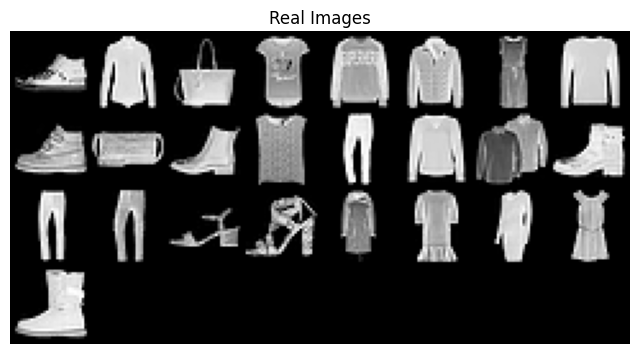

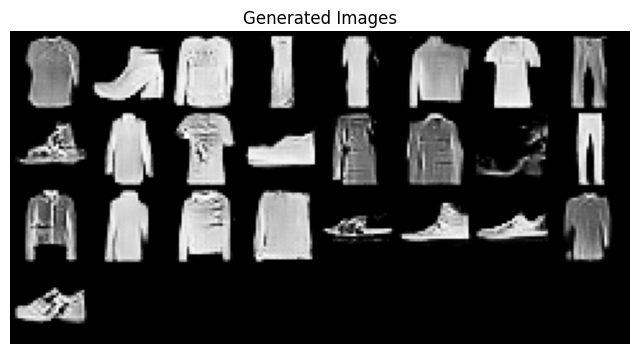

[Epoch 47/80] [Batch 0/469] [D loss: -7.457372665405273] [G loss: -3.665412425994873] [D Acc: 0.6484375]
[Epoch 47/80] [Batch 100/469] [D loss: -13.212258338928223] [G loss: -1.9324252605438232] [D Acc: 0.6875]
[Epoch 47/80] [Batch 200/469] [D loss: -3.716402530670166] [G loss: 16.18614387512207] [D Acc: 0.5]
[Epoch 47/80] [Batch 300/469] [D loss: -6.614205837249756] [G loss: 10.244331359863281] [D Acc: 0.63671875]
[Epoch 47/80] [Batch 400/469] [D loss: -9.662096977233887] [G loss: 17.117414474487305] [D Acc: 0.515625]


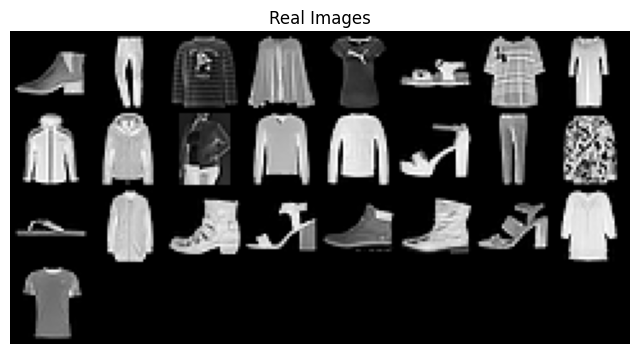

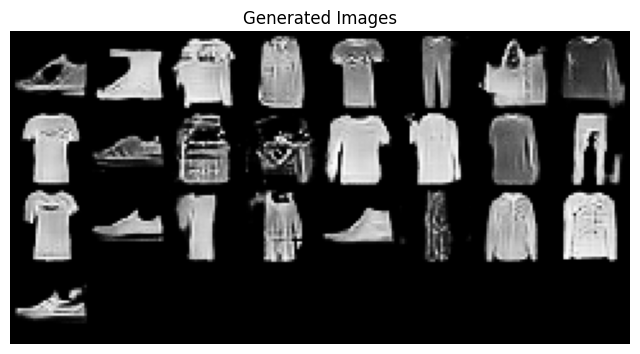

[Epoch 48/80] [Batch 0/469] [D loss: -2.540102005004883] [G loss: 8.590181350708008] [D Acc: 0.51171875]
[Epoch 48/80] [Batch 100/469] [D loss: -10.277667045593262] [G loss: 27.71528434753418] [D Acc: 0.5]
[Epoch 48/80] [Batch 200/469] [D loss: -10.537322044372559] [G loss: -3.483474016189575] [D Acc: 0.640625]
[Epoch 48/80] [Batch 300/469] [D loss: -3.8981146812438965] [G loss: 15.615386009216309] [D Acc: 0.5]
[Epoch 48/80] [Batch 400/469] [D loss: -5.7019524574279785] [G loss: 1.4394679069519043] [D Acc: 0.765625]


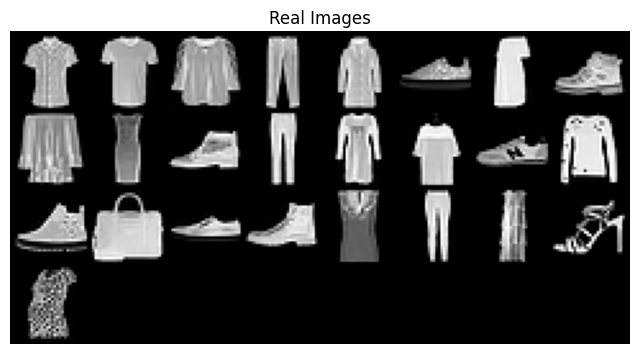

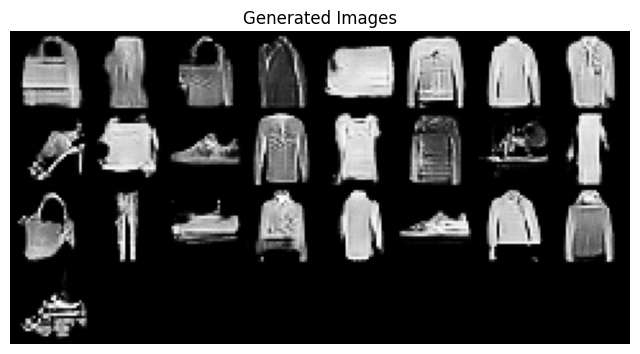

[Epoch 49/80] [Batch 0/469] [D loss: -16.875396728515625] [G loss: -0.7439095377922058] [D Acc: 0.68359375]
[Epoch 49/80] [Batch 100/469] [D loss: -2.855292797088623] [G loss: 11.941852569580078] [D Acc: 0.51171875]
[Epoch 49/80] [Batch 200/469] [D loss: -5.7858381271362305] [G loss: -0.6415639519691467] [D Acc: 0.5546875]
[Epoch 49/80] [Batch 300/469] [D loss: -4.50597620010376] [G loss: 5.8932671546936035] [D Acc: 0.7265625]
[Epoch 49/80] [Batch 400/469] [D loss: -7.819931507110596] [G loss: 3.532902717590332] [D Acc: 0.72265625]


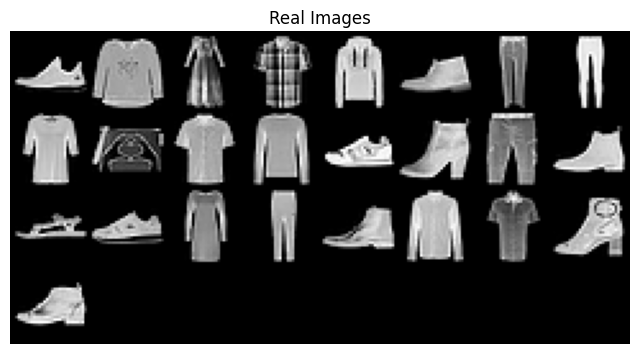

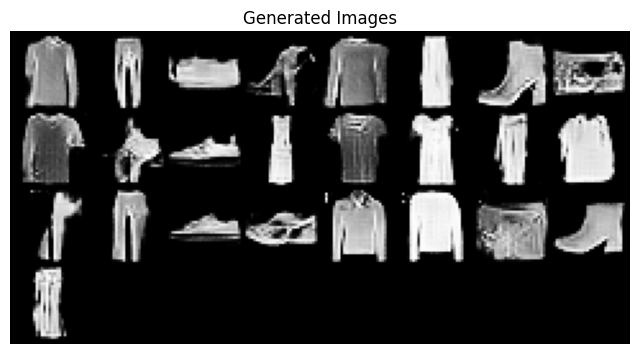

[Epoch 50/80] [Batch 0/469] [D loss: -7.582685947418213] [G loss: 23.71632194519043] [D Acc: 0.5]
[Epoch 50/80] [Batch 100/469] [D loss: -7.1132025718688965] [G loss: 7.719714164733887] [D Acc: 0.92578125]
[Epoch 50/80] [Batch 200/469] [D loss: -6.573934078216553] [G loss: -1.6239937543869019] [D Acc: 0.59765625]
[Epoch 50/80] [Batch 300/469] [D loss: -6.793276309967041] [G loss: 12.684562683105469] [D Acc: 0.57421875]
[Epoch 50/80] [Batch 400/469] [D loss: -10.398150444030762] [G loss: -2.539313316345215] [D Acc: 0.66015625]


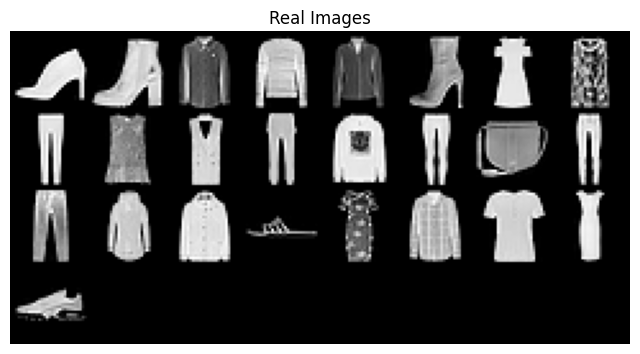

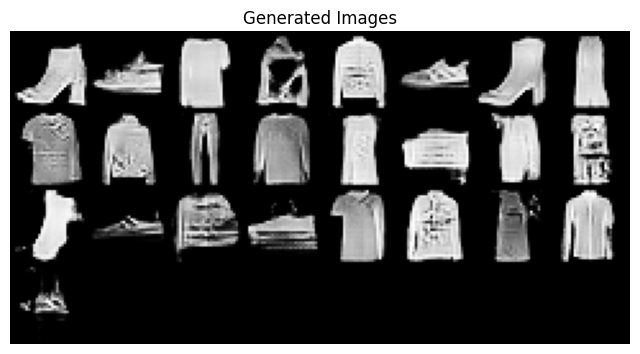

[Epoch 51/80] [Batch 0/469] [D loss: -16.907581329345703] [G loss: 28.417972564697266] [D Acc: 0.5]
[Epoch 51/80] [Batch 100/469] [D loss: -13.326638221740723] [G loss: 2.7953896522521973] [D Acc: 0.875]
[Epoch 51/80] [Batch 200/469] [D loss: -6.185906410217285] [G loss: 5.24977445602417] [D Acc: 0.80859375]
[Epoch 51/80] [Batch 300/469] [D loss: 1.0667996406555176] [G loss: 2.938614845275879] [D Acc: 0.87109375]
[Epoch 51/80] [Batch 400/469] [D loss: 0.3244261145591736] [G loss: -2.2260665893554688] [D Acc: 0.4921875]


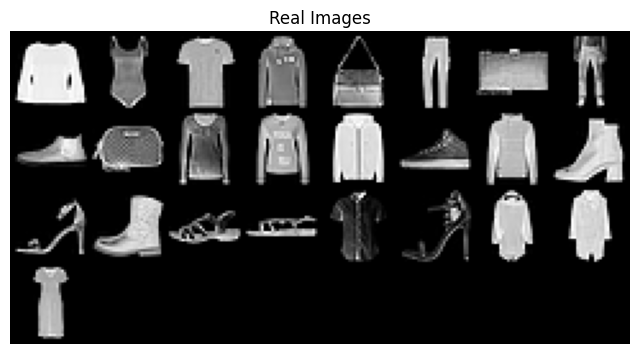

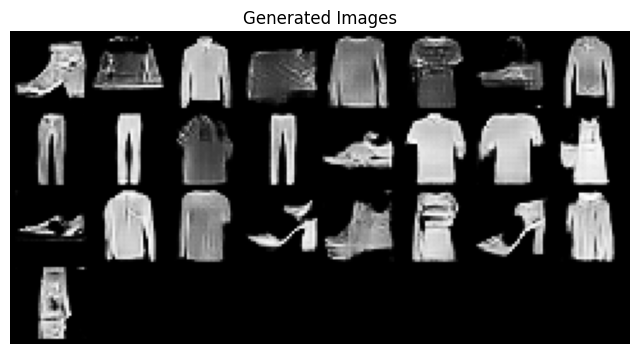

[Epoch 52/80] [Batch 0/469] [D loss: -0.32155466079711914] [G loss: 13.997313499450684] [D Acc: 0.5]
[Epoch 52/80] [Batch 100/469] [D loss: -3.9065933227539062] [G loss: 10.995416641235352] [D Acc: 0.77734375]
[Epoch 52/80] [Batch 200/469] [D loss: -17.696523666381836] [G loss: -15.193516731262207] [D Acc: 0.53125]
[Epoch 52/80] [Batch 300/469] [D loss: 56.66067886352539] [G loss: 3.788849353790283] [D Acc: 0.92578125]
[Epoch 52/80] [Batch 400/469] [D loss: -4.338257312774658] [G loss: 14.815020561218262] [D Acc: 0.50390625]


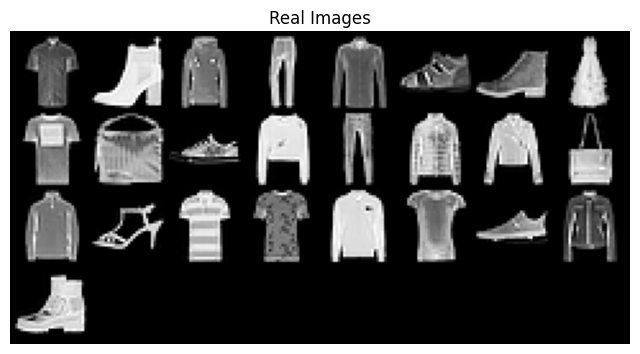

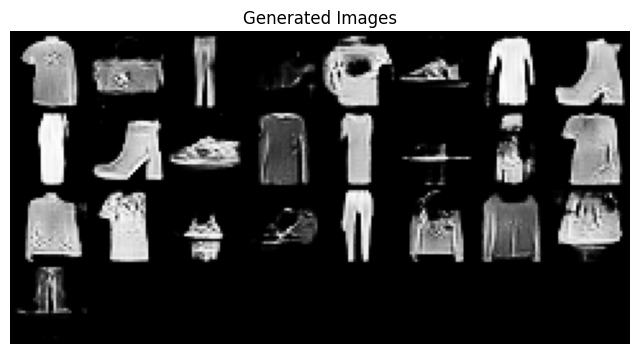

[Epoch 53/80] [Batch 0/469] [D loss: -22.6870059967041] [G loss: 47.0672607421875] [D Acc: 0.5]
[Epoch 53/80] [Batch 100/469] [D loss: -16.760835647583008] [G loss: -3.1120712757110596] [D Acc: 0.6171875]
[Epoch 53/80] [Batch 200/469] [D loss: 1.0648679733276367] [G loss: 13.126574516296387] [D Acc: 0.5]
[Epoch 53/80] [Batch 300/469] [D loss: -22.29341697692871] [G loss: -3.639753818511963] [D Acc: 0.63671875]
[Epoch 53/80] [Batch 400/469] [D loss: -1.2500413656234741] [G loss: -10.046445846557617] [D Acc: 0.546875]


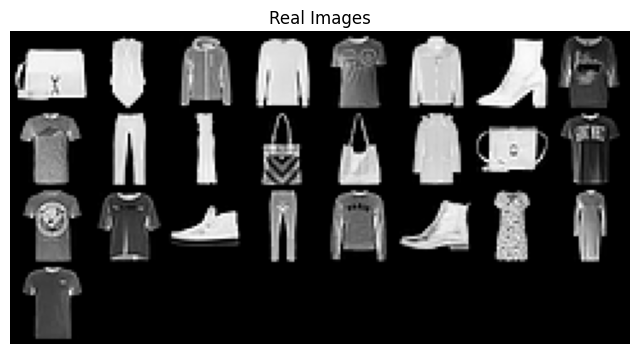

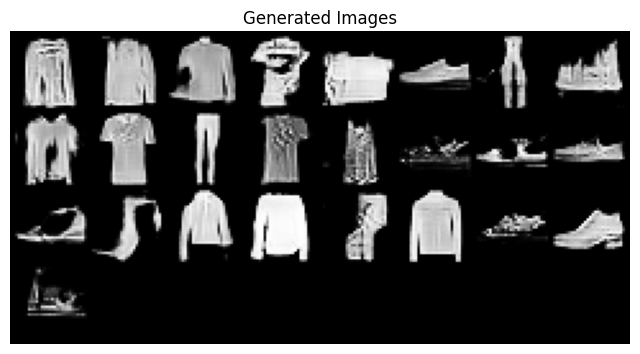

[Epoch 54/80] [Batch 0/469] [D loss: -10.630916595458984] [G loss: 32.28220748901367] [D Acc: 0.51171875]
[Epoch 54/80] [Batch 100/469] [D loss: 1.1034002304077148] [G loss: 10.285116195678711] [D Acc: 0.5]
[Epoch 54/80] [Batch 200/469] [D loss: -6.126491069793701] [G loss: 14.344796180725098] [D Acc: 0.6953125]
[Epoch 54/80] [Batch 300/469] [D loss: -9.077056884765625] [G loss: 4.05539608001709] [D Acc: 0.85546875]
[Epoch 54/80] [Batch 400/469] [D loss: -2.501725912094116] [G loss: 9.589752197265625] [D Acc: 0.5625]


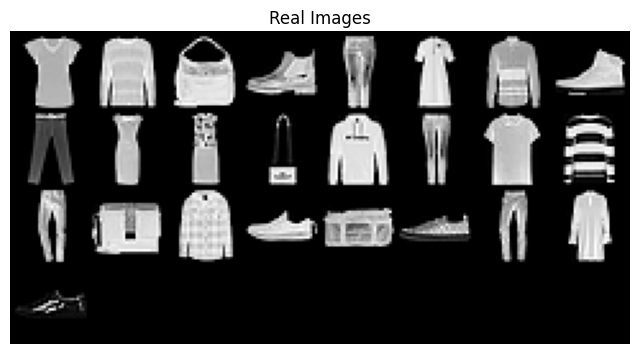

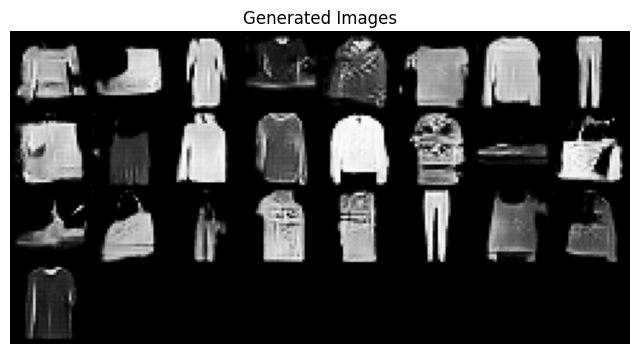

[Epoch 55/80] [Batch 0/469] [D loss: 7.277862548828125] [G loss: 11.881970405578613] [D Acc: 0.99609375]
[Epoch 55/80] [Batch 100/469] [D loss: -10.711007118225098] [G loss: 25.167016983032227] [D Acc: 0.5234375]
[Epoch 55/80] [Batch 200/469] [D loss: -13.733797073364258] [G loss: 16.22191047668457] [D Acc: 0.62890625]
[Epoch 55/80] [Batch 300/469] [D loss: -13.26701545715332] [G loss: 28.062213897705078] [D Acc: 0.5]
[Epoch 55/80] [Batch 400/469] [D loss: -5.779443740844727] [G loss: -3.438971757888794] [D Acc: 0.62890625]


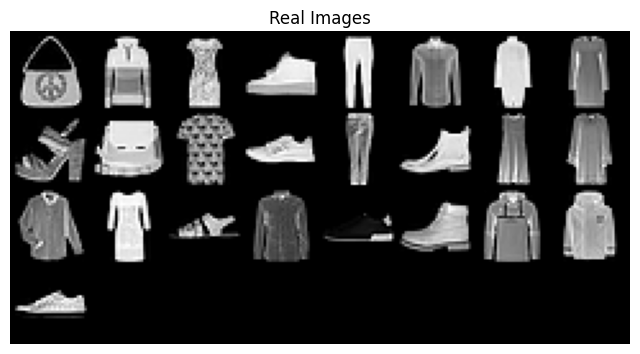

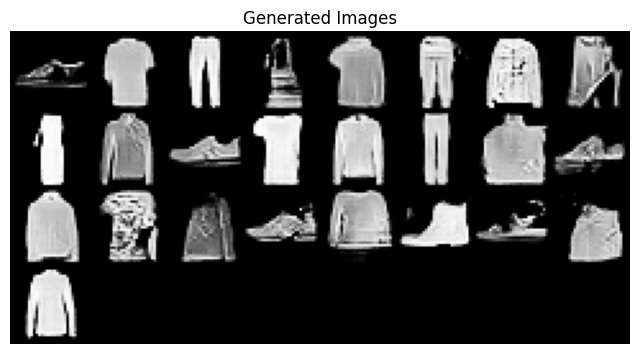

[Epoch 56/80] [Batch 0/469] [D loss: -6.819589614868164] [G loss: 10.934246063232422] [D Acc: 0.671875]
[Epoch 56/80] [Batch 100/469] [D loss: -23.597436904907227] [G loss: -6.235308647155762] [D Acc: 0.57421875]
[Epoch 56/80] [Batch 200/469] [D loss: -16.16057586669922] [G loss: 34.21344757080078] [D Acc: 0.6171875]
[Epoch 56/80] [Batch 300/469] [D loss: 11.774856567382812] [G loss: 15.964098930358887] [D Acc: 0.51171875]
[Epoch 56/80] [Batch 400/469] [D loss: 175.65530395507812] [G loss: 1.6625677347183228] [D Acc: 0.31640625]


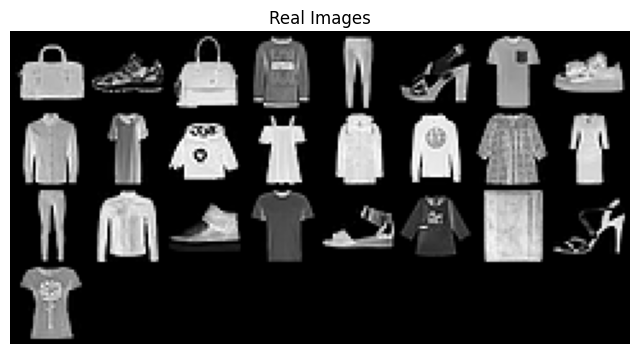

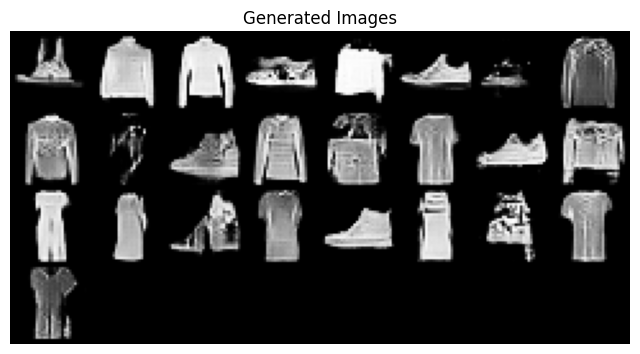

[Epoch 57/80] [Batch 0/469] [D loss: -4.546840667724609] [G loss: 11.239208221435547] [D Acc: 0.62890625]
[Epoch 57/80] [Batch 100/469] [D loss: -0.8908435106277466] [G loss: 8.982160568237305] [D Acc: 0.5]
[Epoch 57/80] [Batch 200/469] [D loss: -2.9782514572143555] [G loss: -4.0984320640563965] [D Acc: 0.6171875]
[Epoch 57/80] [Batch 300/469] [D loss: -11.015366554260254] [G loss: 21.923419952392578] [D Acc: 0.58984375]
[Epoch 57/80] [Batch 400/469] [D loss: -8.229524612426758] [G loss: 23.2891845703125] [D Acc: 0.52734375]


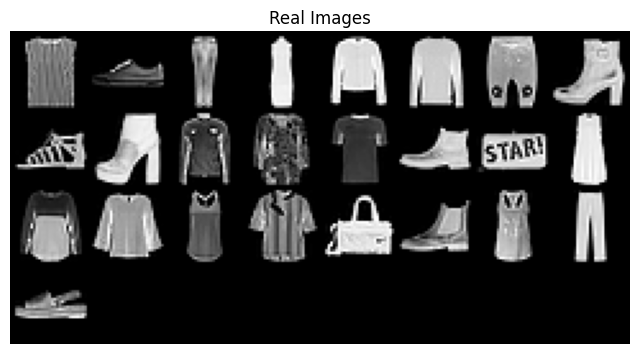

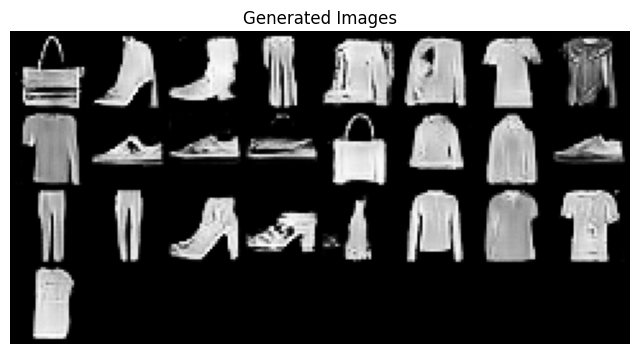

[Epoch 58/80] [Batch 0/469] [D loss: 2.269969940185547] [G loss: 11.477998733520508] [D Acc: 1.0]
[Epoch 58/80] [Batch 100/469] [D loss: -19.004533767700195] [G loss: 42.00244903564453] [D Acc: 0.5]
[Epoch 58/80] [Batch 200/469] [D loss: -6.401586055755615] [G loss: 13.660858154296875] [D Acc: 0.53125]
[Epoch 58/80] [Batch 300/469] [D loss: -12.641968727111816] [G loss: 24.82128143310547] [D Acc: 0.78515625]
[Epoch 58/80] [Batch 400/469] [D loss: -11.286767959594727] [G loss: 38.422935485839844] [D Acc: 0.5]


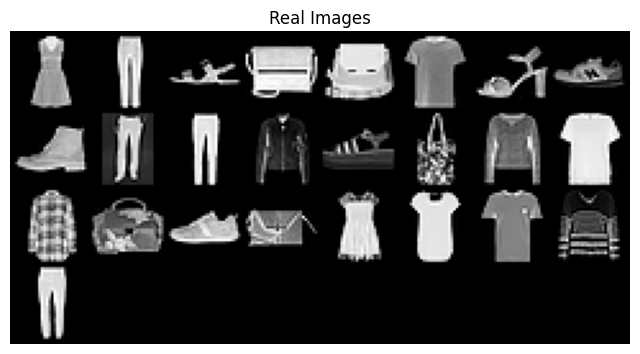

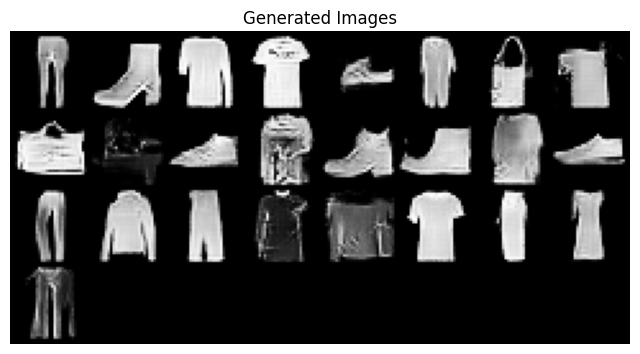

[Epoch 59/80] [Batch 0/469] [D loss: -0.5232113599777222] [G loss: 1.8942766189575195] [D Acc: 0.6875]
[Epoch 59/80] [Batch 100/469] [D loss: -5.223313808441162] [G loss: 12.058009147644043] [D Acc: 0.5234375]
[Epoch 59/80] [Batch 200/469] [D loss: -12.36937141418457] [G loss: 23.326091766357422] [D Acc: 0.91796875]
[Epoch 59/80] [Batch 300/469] [D loss: -3.621351480484009] [G loss: 9.23564338684082] [D Acc: 0.515625]
[Epoch 59/80] [Batch 400/469] [D loss: -9.608719825744629] [G loss: 5.753446578979492] [D Acc: 0.734375]


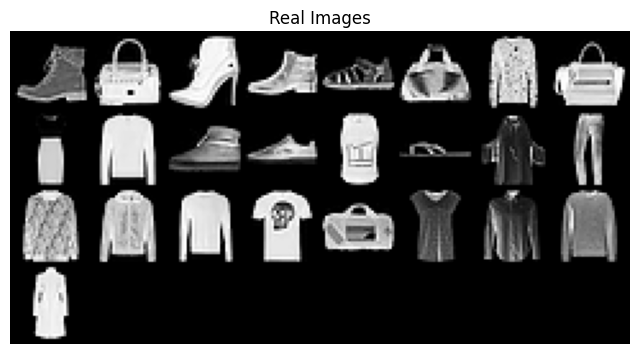

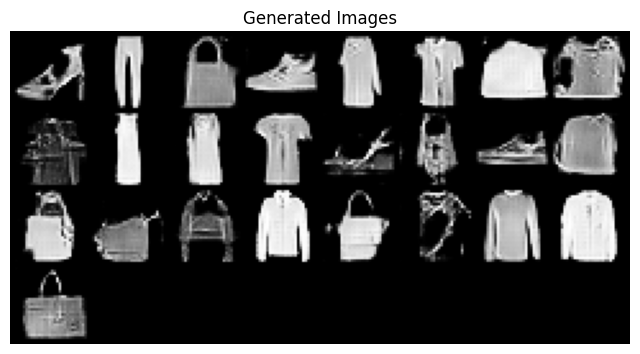

[Epoch 60/80] [Batch 0/469] [D loss: -5.056090831756592] [G loss: 7.266647815704346] [D Acc: 0.73828125]
[Epoch 60/80] [Batch 100/469] [D loss: -9.375496864318848] [G loss: -4.666469573974609] [D Acc: 0.5234375]
[Epoch 60/80] [Batch 200/469] [D loss: -20.474424362182617] [G loss: -28.788188934326172] [D Acc: 0.5]
[Epoch 60/80] [Batch 300/469] [D loss: -32.62226104736328] [G loss: -26.258148193359375] [D Acc: 0.5]
[Epoch 60/80] [Batch 400/469] [D loss: -4.288152694702148] [G loss: 14.791247367858887] [D Acc: 0.5]


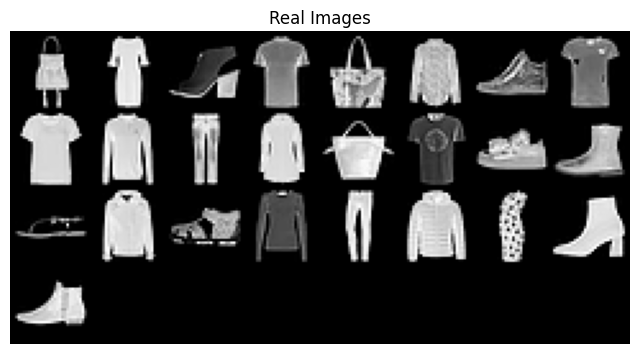

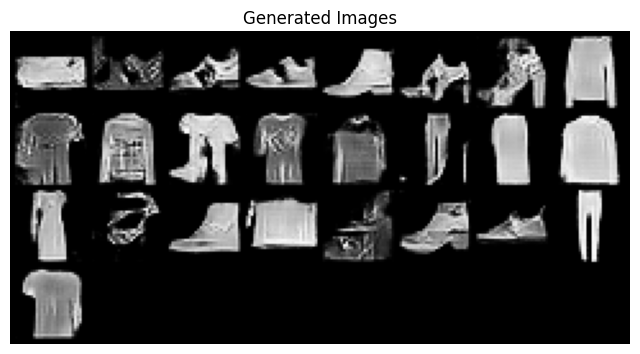

[Epoch 61/80] [Batch 0/469] [D loss: 3.41560697555542] [G loss: 17.677215576171875] [D Acc: 0.5]
[Epoch 61/80] [Batch 100/469] [D loss: -11.183575630187988] [G loss: 28.53748321533203] [D Acc: 0.6015625]
[Epoch 61/80] [Batch 200/469] [D loss: -3.785597801208496] [G loss: 7.989059925079346] [D Acc: 0.5546875]
[Epoch 61/80] [Batch 300/469] [D loss: -6.804420471191406] [G loss: 12.523655891418457] [D Acc: 0.640625]
[Epoch 61/80] [Batch 400/469] [D loss: -38.995723724365234] [G loss: -23.41632843017578] [D Acc: 0.5]


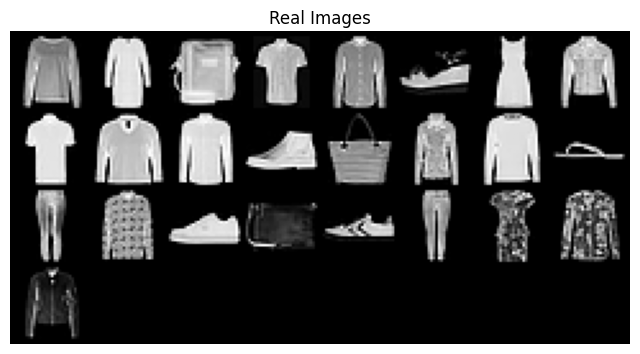

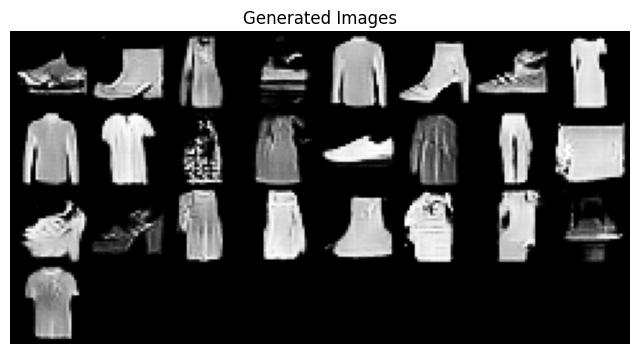

[Epoch 62/80] [Batch 0/469] [D loss: -2.4205965995788574] [G loss: 13.006370544433594] [D Acc: 0.50390625]
[Epoch 62/80] [Batch 100/469] [D loss: -16.688148498535156] [G loss: -11.834798812866211] [D Acc: 0.5]
[Epoch 62/80] [Batch 200/469] [D loss: -2.0321977138519287] [G loss: 11.635356903076172] [D Acc: 0.5]
[Epoch 62/80] [Batch 300/469] [D loss: -6.683241844177246] [G loss: 15.306375503540039] [D Acc: 0.5859375]
[Epoch 62/80] [Batch 400/469] [D loss: -10.298164367675781] [G loss: 21.139644622802734] [D Acc: 0.55859375]


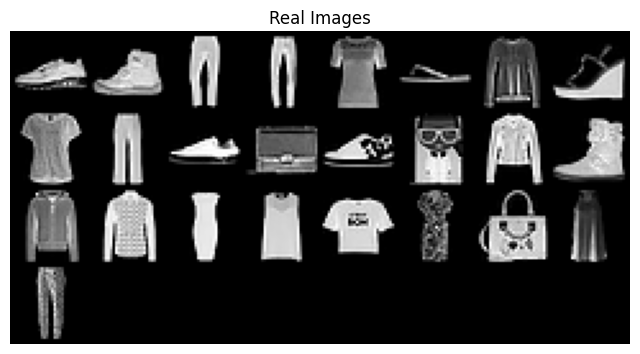

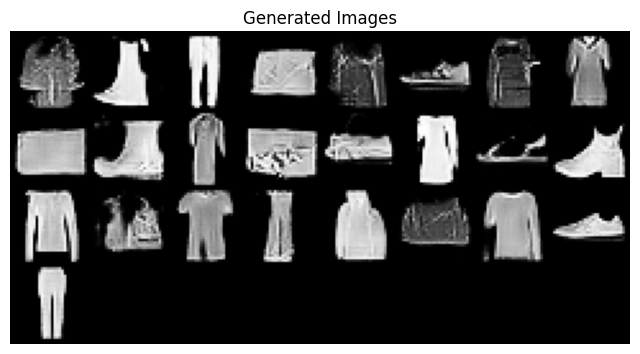

[Epoch 63/80] [Batch 0/469] [D loss: -3.770482063293457] [G loss: 0.25821390748023987] [D Acc: 0.59375]
[Epoch 63/80] [Batch 100/469] [D loss: -3.0076446533203125] [G loss: -0.6626473665237427] [D Acc: 0.6796875]
[Epoch 63/80] [Batch 200/469] [D loss: -18.61072540283203] [G loss: -5.264077186584473] [D Acc: 0.56640625]
[Epoch 63/80] [Batch 300/469] [D loss: -10.659072875976562] [G loss: 26.11124038696289] [D Acc: 0.5]
[Epoch 63/80] [Batch 400/469] [D loss: -8.221625328063965] [G loss: -0.6461776494979858] [D Acc: 0.66015625]


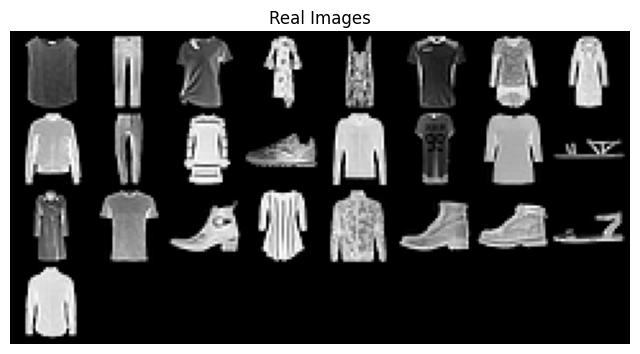

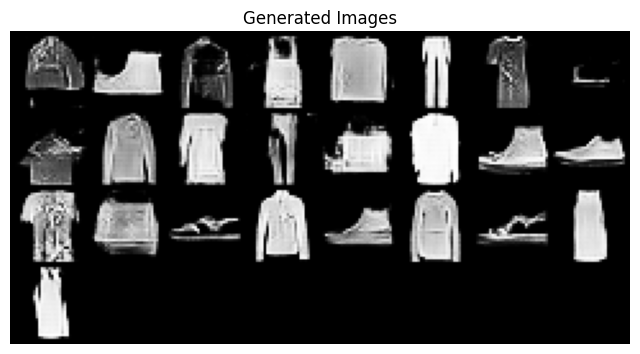

[Epoch 64/80] [Batch 0/469] [D loss: -3.014266014099121] [G loss: 8.443882942199707] [D Acc: 0.50390625]
[Epoch 64/80] [Batch 100/469] [D loss: -11.524900436401367] [G loss: 15.452215194702148] [D Acc: 0.76171875]
[Epoch 64/80] [Batch 200/469] [D loss: -2.5693042278289795] [G loss: 11.884052276611328] [D Acc: 0.5]
[Epoch 64/80] [Batch 300/469] [D loss: -6.963184356689453] [G loss: 9.72745132446289] [D Acc: 0.46875]
[Epoch 64/80] [Batch 400/469] [D loss: -3.692143678665161] [G loss: 2.7181479930877686] [D Acc: 0.578125]


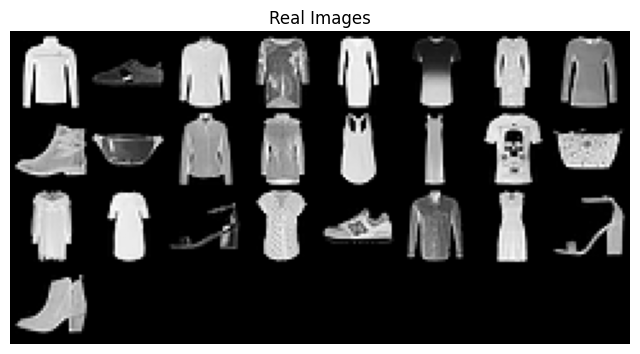

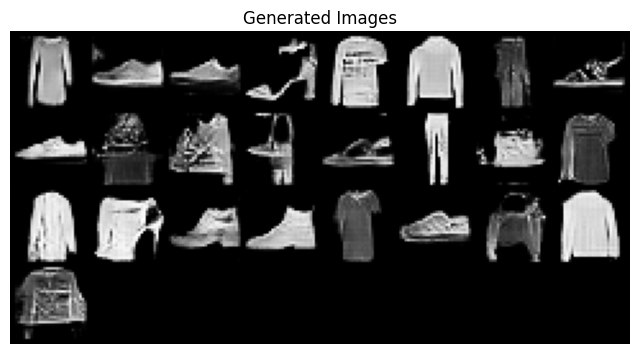

[Epoch 65/80] [Batch 0/469] [D loss: -1.3645296096801758] [G loss: 12.705565452575684] [D Acc: 0.5]
[Epoch 65/80] [Batch 100/469] [D loss: -15.180940628051758] [G loss: 34.28349304199219] [D Acc: 0.6015625]
[Epoch 65/80] [Batch 200/469] [D loss: -5.457331657409668] [G loss: 1.778257131576538] [D Acc: 0.640625]
[Epoch 65/80] [Batch 300/469] [D loss: -3.4483304023742676] [G loss: 0.4281768798828125] [D Acc: 0.63671875]
[Epoch 65/80] [Batch 400/469] [D loss: -16.700891494750977] [G loss: -15.114201545715332] [D Acc: 0.52734375]


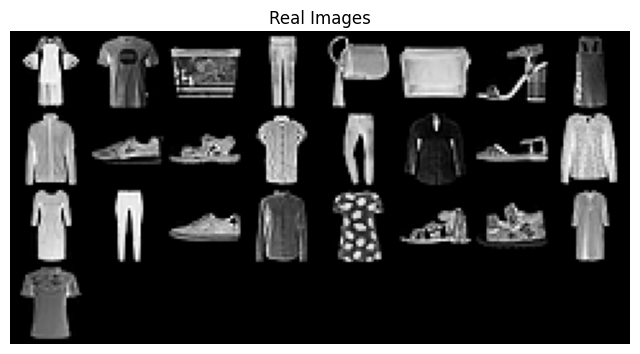

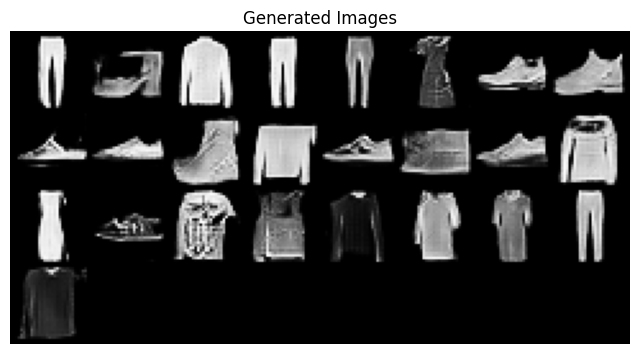

[Epoch 66/80] [Batch 0/469] [D loss: 5.344130516052246] [G loss: 43.0589599609375] [D Acc: 0.5]
[Epoch 66/80] [Batch 100/469] [D loss: -16.035438537597656] [G loss: 3.061326026916504] [D Acc: 0.66796875]
[Epoch 66/80] [Batch 200/469] [D loss: -6.113712787628174] [G loss: 2.109286069869995] [D Acc: 0.68359375]
[Epoch 66/80] [Batch 300/469] [D loss: -6.202500343322754] [G loss: 36.8453369140625] [D Acc: 0.5]
[Epoch 66/80] [Batch 400/469] [D loss: -6.110296726226807] [G loss: 4.296992778778076] [D Acc: 0.7890625]


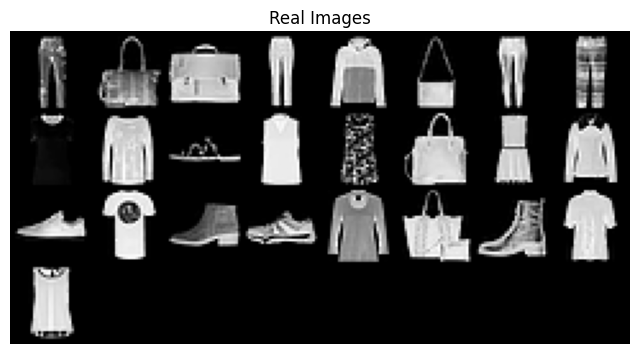

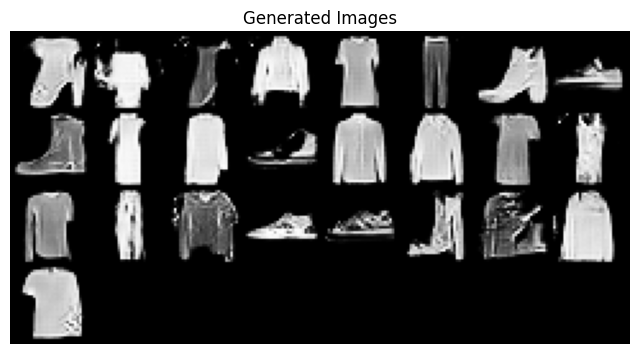

[Epoch 67/80] [Batch 0/469] [D loss: -28.426790237426758] [G loss: 33.50053024291992] [D Acc: 0.7578125]
[Epoch 67/80] [Batch 100/469] [D loss: -16.774181365966797] [G loss: -11.553871154785156] [D Acc: 0.53125]
[Epoch 67/80] [Batch 200/469] [D loss: -11.012508392333984] [G loss: -10.301331520080566] [D Acc: 0.515625]
[Epoch 67/80] [Batch 300/469] [D loss: -11.5264253616333] [G loss: -9.934976577758789] [D Acc: 0.52734375]
[Epoch 67/80] [Batch 400/469] [D loss: 2.5456438064575195] [G loss: -6.6982831954956055] [D Acc: 0.51953125]


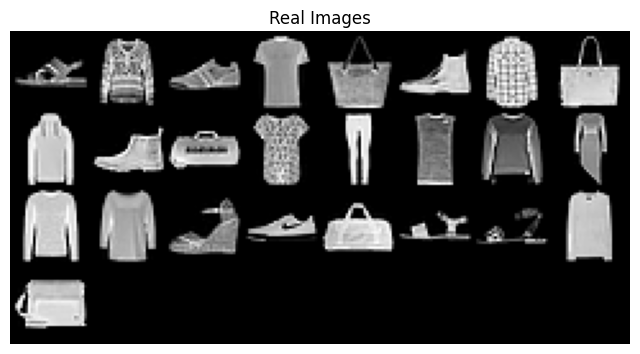

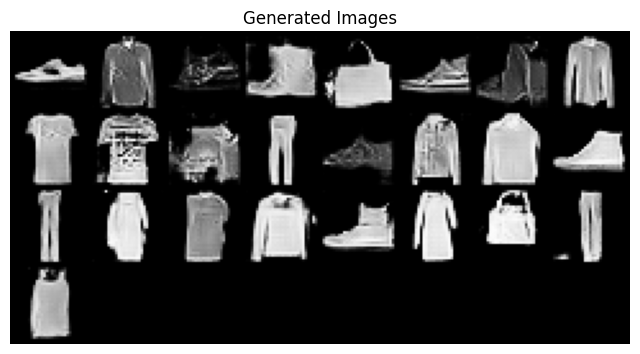

[Epoch 68/80] [Batch 0/469] [D loss: -14.36892032623291] [G loss: -3.1289594173431396] [D Acc: 0.671875]
[Epoch 68/80] [Batch 100/469] [D loss: -8.918889045715332] [G loss: 9.885523796081543] [D Acc: 0.95703125]
[Epoch 68/80] [Batch 200/469] [D loss: -3.8419172763824463] [G loss: -7.60629940032959] [D Acc: 0.5]
[Epoch 68/80] [Batch 300/469] [D loss: -7.310229301452637] [G loss: 11.649916648864746] [D Acc: 0.80078125]
[Epoch 68/80] [Batch 400/469] [D loss: -6.7997965812683105] [G loss: 9.446988105773926] [D Acc: 0.58203125]


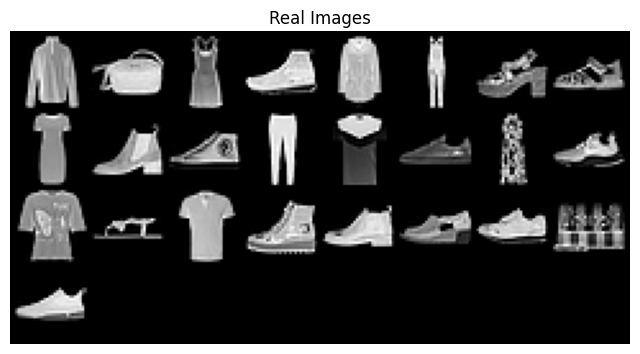

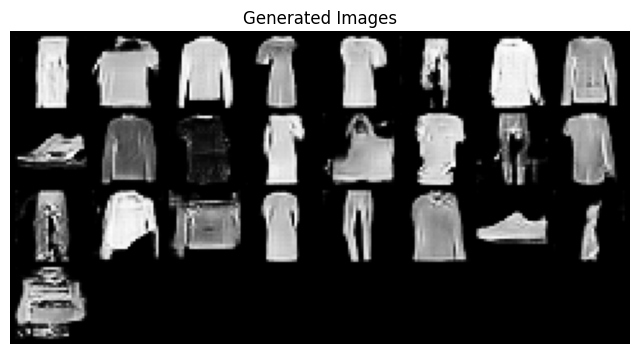

[Epoch 69/80] [Batch 0/469] [D loss: 18.584861755371094] [G loss: -22.966815948486328] [D Acc: 0.5]
[Epoch 69/80] [Batch 100/469] [D loss: -13.626055717468262] [G loss: 5.018662452697754] [D Acc: 0.93359375]
[Epoch 69/80] [Batch 200/469] [D loss: -3.875382423400879] [G loss: 1.0981271266937256] [D Acc: 0.7578125]
[Epoch 69/80] [Batch 300/469] [D loss: -6.5435285568237305] [G loss: -4.504639148712158] [D Acc: 0.5546875]
[Epoch 69/80] [Batch 400/469] [D loss: -18.73089599609375] [G loss: 32.843143463134766] [D Acc: 0.93359375]


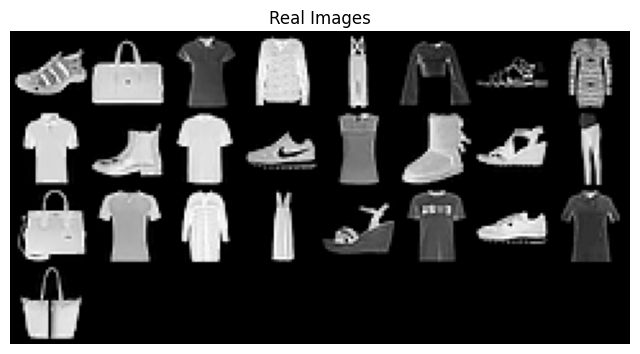

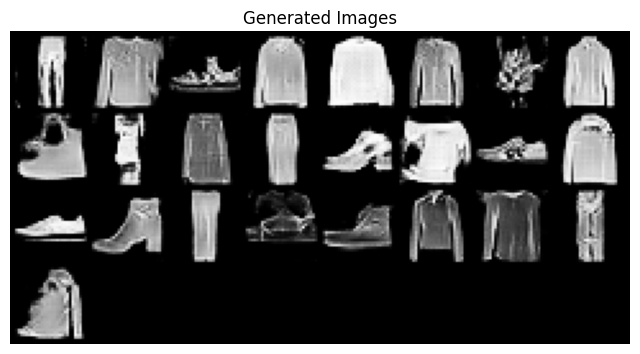

[Epoch 70/80] [Batch 0/469] [D loss: -7.596768379211426] [G loss: -6.202065944671631] [D Acc: 0.546875]
[Epoch 70/80] [Batch 100/469] [D loss: -16.497438430786133] [G loss: 19.306621551513672] [D Acc: 0.734375]
[Epoch 70/80] [Batch 200/469] [D loss: -24.0387020111084] [G loss: 42.20934295654297] [D Acc: 0.52734375]
[Epoch 70/80] [Batch 300/469] [D loss: -7.9143476486206055] [G loss: 12.313467025756836] [D Acc: 0.765625]
[Epoch 70/80] [Batch 400/469] [D loss: -8.530887603759766] [G loss: -14.595508575439453] [D Acc: 0.51171875]


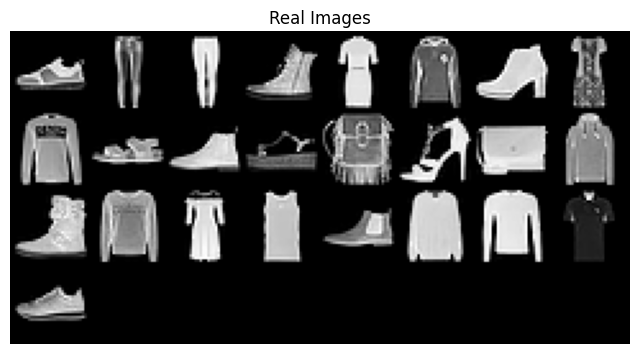

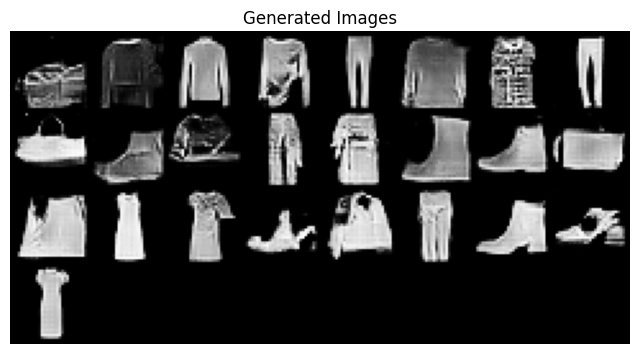

[Epoch 71/80] [Batch 0/469] [D loss: -5.333792209625244] [G loss: 2.372396945953369] [D Acc: 0.75]
[Epoch 71/80] [Batch 100/469] [D loss: -19.06915283203125] [G loss: -29.067005157470703] [D Acc: 0.5]
[Epoch 71/80] [Batch 200/469] [D loss: -25.330909729003906] [G loss: 58.56205368041992] [D Acc: 0.5]
[Epoch 71/80] [Batch 300/469] [D loss: -3.518428325653076] [G loss: 5.808323860168457] [D Acc: 0.71875]
[Epoch 71/80] [Batch 400/469] [D loss: -7.18316650390625] [G loss: -14.233933448791504] [D Acc: 0.49609375]


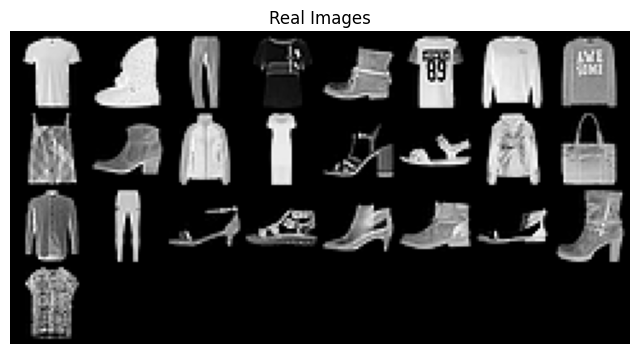

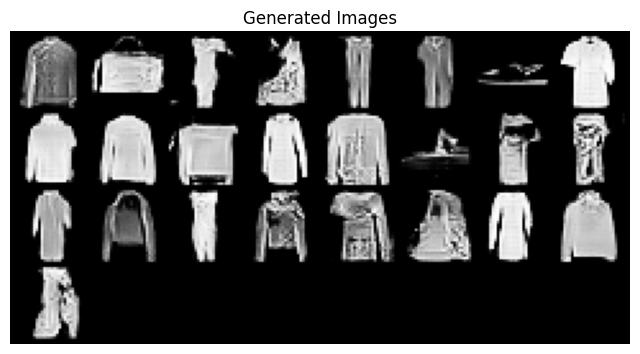

[Epoch 72/80] [Batch 0/469] [D loss: -4.478532314300537] [G loss: 13.379079818725586] [D Acc: 0.65234375]
[Epoch 72/80] [Batch 100/469] [D loss: -5.689812660217285] [G loss: -1.182692050933838] [D Acc: 0.6796875]
[Epoch 72/80] [Batch 200/469] [D loss: -9.280854225158691] [G loss: 17.524341583251953] [D Acc: 0.75]
[Epoch 72/80] [Batch 300/469] [D loss: -18.815855026245117] [G loss: -8.3342924118042] [D Acc: 0.51953125]
[Epoch 72/80] [Batch 400/469] [D loss: -11.677562713623047] [G loss: 21.360124588012695] [D Acc: 0.70703125]


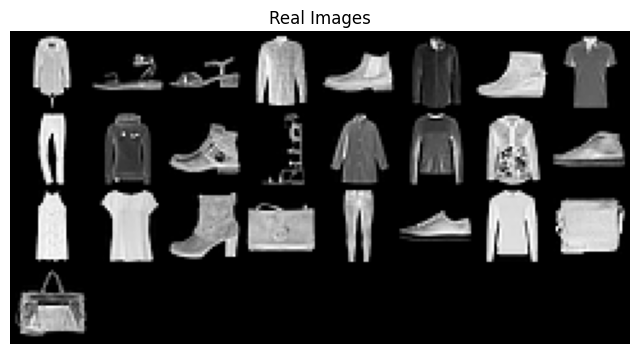

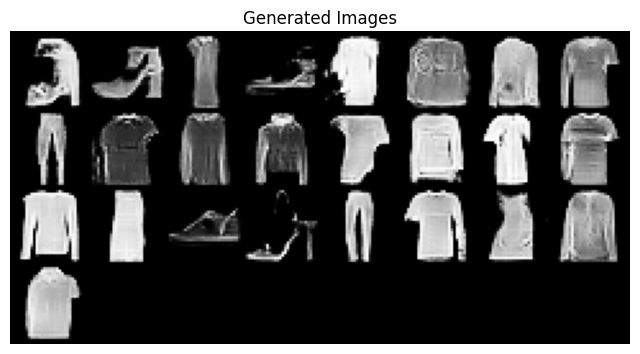

[Epoch 73/80] [Batch 0/469] [D loss: -14.123456001281738] [G loss: 28.713531494140625] [D Acc: 0.54296875]
[Epoch 73/80] [Batch 100/469] [D loss: -30.218379974365234] [G loss: -32.24552917480469] [D Acc: 0.50390625]
[Epoch 73/80] [Batch 200/469] [D loss: 26.6810359954834] [G loss: 22.27703857421875] [D Acc: 0.5]
[Epoch 73/80] [Batch 300/469] [D loss: -6.650686264038086] [G loss: 3.1459522247314453] [D Acc: 0.86328125]
[Epoch 73/80] [Batch 400/469] [D loss: -10.11740779876709] [G loss: 23.927658081054688] [D Acc: 0.5]


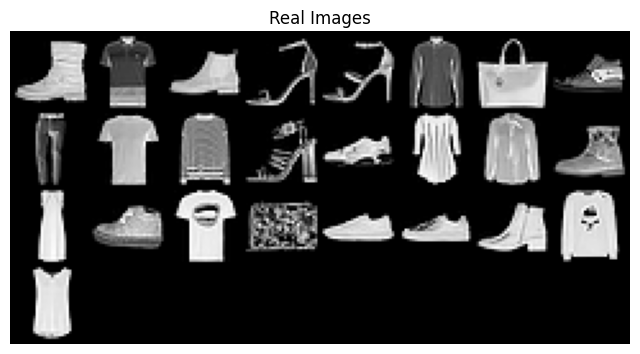

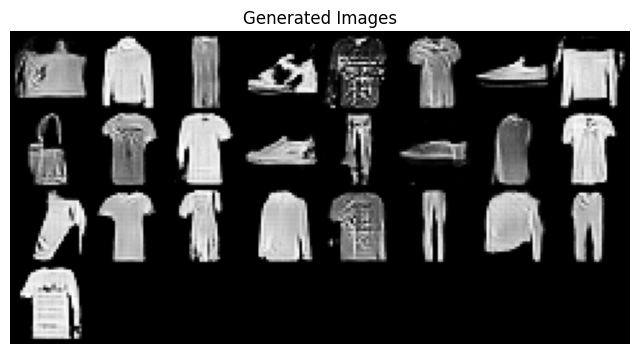

[Epoch 74/80] [Batch 0/469] [D loss: -12.182908058166504] [G loss: -1.7686423063278198] [D Acc: 0.609375]
[Epoch 74/80] [Batch 100/469] [D loss: -3.977954626083374] [G loss: -1.432384967803955] [D Acc: 0.65234375]
[Epoch 74/80] [Batch 200/469] [D loss: -15.526191711425781] [G loss: 1.8194901943206787] [D Acc: 0.81640625]
[Epoch 74/80] [Batch 300/469] [D loss: -8.038935661315918] [G loss: 6.313538074493408] [D Acc: 0.9609375]
[Epoch 74/80] [Batch 400/469] [D loss: -5.729866981506348] [G loss: 8.725580215454102] [D Acc: 0.75390625]


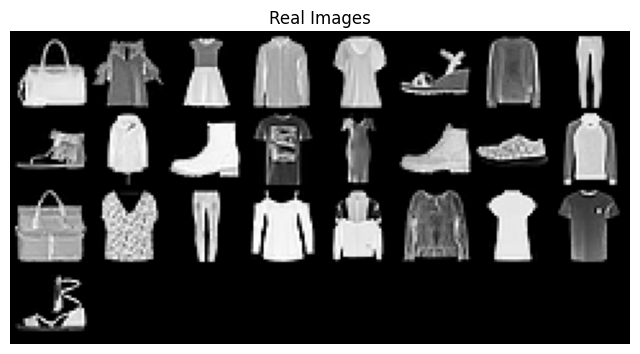

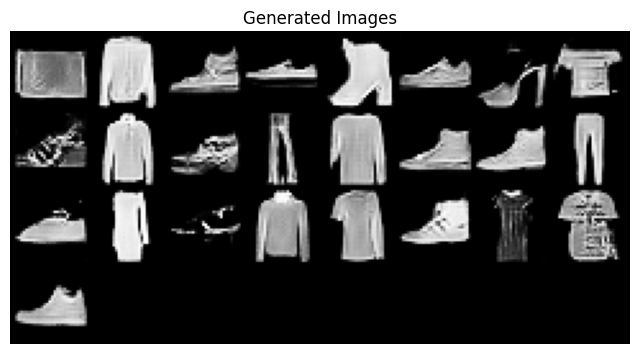

[Epoch 75/80] [Batch 0/469] [D loss: -16.932472229003906] [G loss: 14.40087890625] [D Acc: 0.81640625]
[Epoch 75/80] [Batch 100/469] [D loss: -14.667047500610352] [G loss: 16.888885498046875] [D Acc: 0.734375]
[Epoch 75/80] [Batch 200/469] [D loss: -8.411836624145508] [G loss: -18.609577178955078] [D Acc: 0.5]
[Epoch 75/80] [Batch 300/469] [D loss: -3.045442581176758] [G loss: 11.365018844604492] [D Acc: 0.5]
[Epoch 75/80] [Batch 400/469] [D loss: -9.716468811035156] [G loss: -27.211265563964844] [D Acc: 0.50390625]


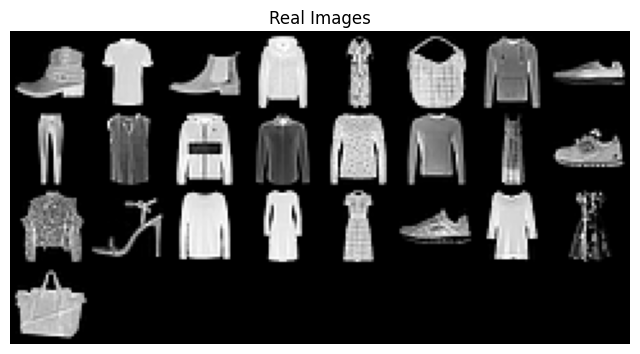

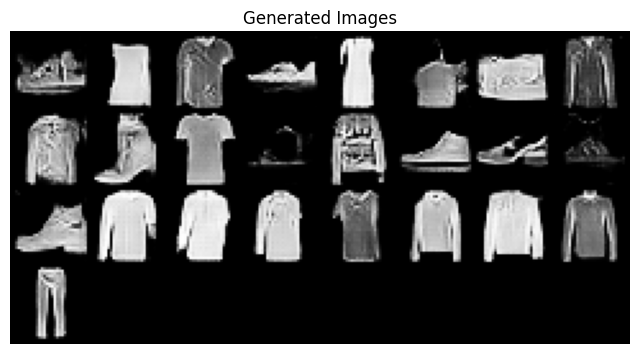

[Epoch 76/80] [Batch 0/469] [D loss: 0.3594226837158203] [G loss: 9.709734916687012] [D Acc: 0.99609375]
[Epoch 76/80] [Batch 100/469] [D loss: -13.510998725891113] [G loss: 16.494104385375977] [D Acc: 0.609375]
[Epoch 76/80] [Batch 200/469] [D loss: -5.7207794189453125] [G loss: 16.71985626220703] [D Acc: 0.5078125]
[Epoch 76/80] [Batch 300/469] [D loss: -4.753320217132568] [G loss: 2.9588379859924316] [D Acc: 0.671875]
[Epoch 76/80] [Batch 400/469] [D loss: -10.02311897277832] [G loss: 13.60076904296875] [D Acc: 0.89453125]


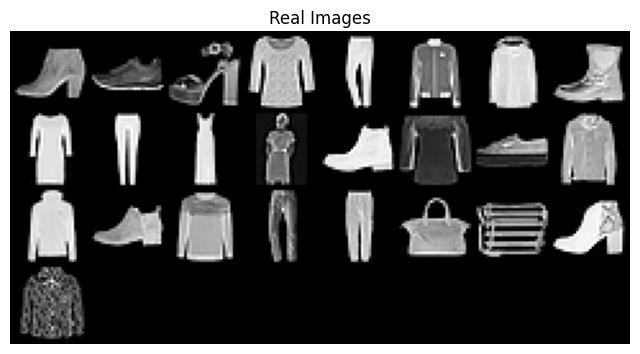

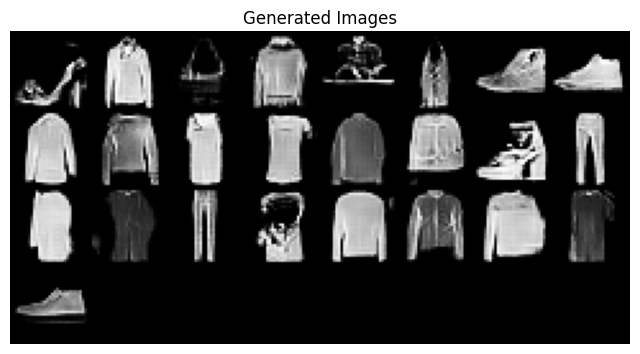

[Epoch 77/80] [Batch 0/469] [D loss: -3.166874885559082] [G loss: -0.5624893307685852] [D Acc: 0.5859375]
[Epoch 77/80] [Batch 100/469] [D loss: -22.02630043029785] [G loss: 1.0603324174880981] [D Acc: 0.7890625]
[Epoch 77/80] [Batch 200/469] [D loss: -3.255030632019043] [G loss: 8.570428848266602] [D Acc: 0.55078125]
[Epoch 77/80] [Batch 300/469] [D loss: 4.209228992462158] [G loss: -5.211077690124512] [D Acc: 0.484375]
[Epoch 77/80] [Batch 400/469] [D loss: -45.651187896728516] [G loss: -21.709819793701172] [D Acc: 0.5078125]


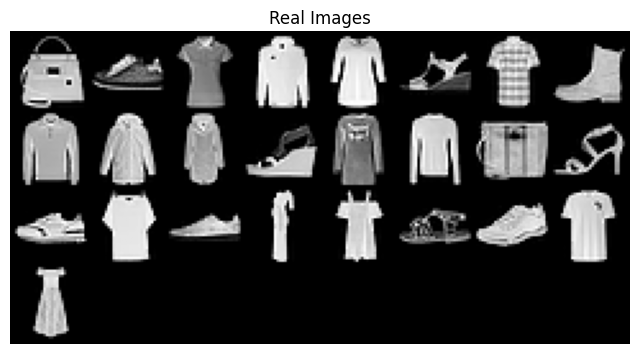

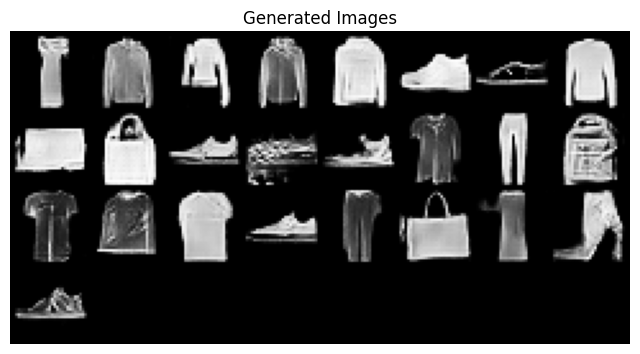

[Epoch 78/80] [Batch 0/469] [D loss: -5.406274795532227] [G loss: 11.203758239746094] [D Acc: 0.51953125]
[Epoch 78/80] [Batch 100/469] [D loss: -21.544422149658203] [G loss: -21.18575668334961] [D Acc: 0.52734375]
[Epoch 78/80] [Batch 200/469] [D loss: -2.2022855281829834] [G loss: 0.6506937742233276] [D Acc: 0.5390625]
[Epoch 78/80] [Batch 300/469] [D loss: -12.86731243133545] [G loss: -3.8511593341827393] [D Acc: 0.57421875]
[Epoch 78/80] [Batch 400/469] [D loss: -55.96721649169922] [G loss: 4.317145824432373] [D Acc: 0.8359375]


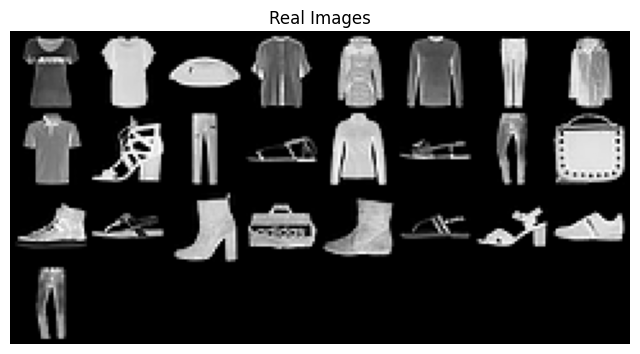

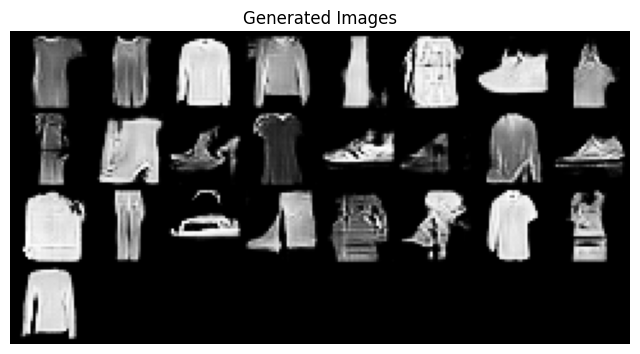

[Epoch 79/80] [Batch 0/469] [D loss: -9.387585639953613] [G loss: 17.709794998168945] [D Acc: 0.5234375]
[Epoch 79/80] [Batch 100/469] [D loss: -13.729873657226562] [G loss: 20.584163665771484] [D Acc: 0.546875]
[Epoch 79/80] [Batch 200/469] [D loss: -22.030532836914062] [G loss: 49.523841857910156] [D Acc: 0.5]
[Epoch 79/80] [Batch 300/469] [D loss: -9.921721458435059] [G loss: -10.408463478088379] [D Acc: 0.5]
[Epoch 79/80] [Batch 400/469] [D loss: -2.251206159591675] [G loss: 4.702335357666016] [D Acc: 0.66796875]


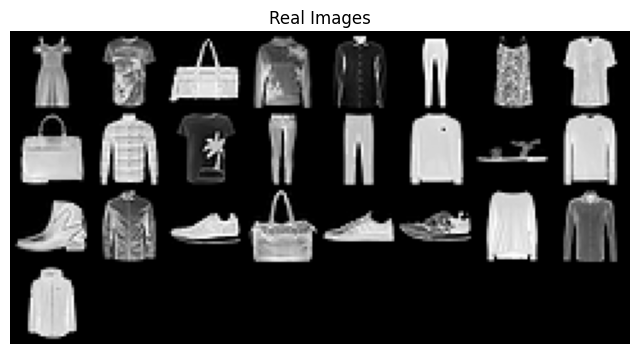

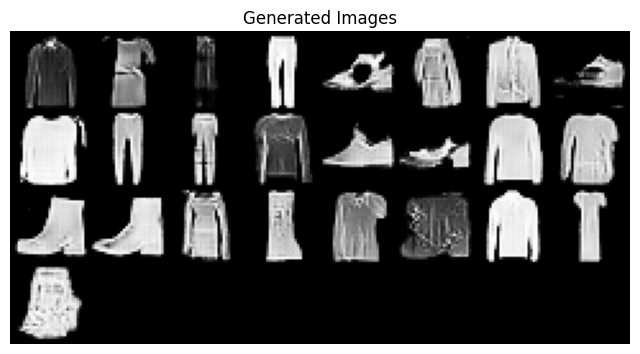

In [14]:
train_wgan_gp(device, train_loader, wgan_generator, wgan_discriminator, epochs=80, lr=0.001, lambda_gp=10)

Load Trained Models

In [15]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")
dcgan_generator = DCGAN_Generator().to(device)
dcgan_discriminator = DCGAN_Discriminator().to(device)
wgan_generator = WGAN_Generator().to(device)
wgan_discriminator = WGAN_Discriminator().to(device)


# Load weights
wgan_generator.load_state_dict(torch.load('wgan_generator_model_weights.pth', map_location=device))
wgan_discriminator.load_state_dict(torch.load('wgan_discriminator_model_weights.pth', map_location=device))
dcgan_generator.load_state_dict(torch.load('dcgan_generator_model_weights.pth', map_location=device))
dcgan_discriminator.load_state_dict(torch.load('dcgan_discriminator_model_weights.pth', map_location=device))

dcgan_generator.eval()
wgan_generator.eval()

Using device: cuda


WGAN_Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(7, 7), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)

Generate Images

In [49]:
with torch.no_grad():
    noise = torch.randn(2, 100, 1, 1, device=device)  # Generate 2 images
    dcgan_imgs = dcgan_generator(noise)
    wgan_imgs = wgan_generator(noise)

Select Real Images for Comparison

Generated by DCGAN:


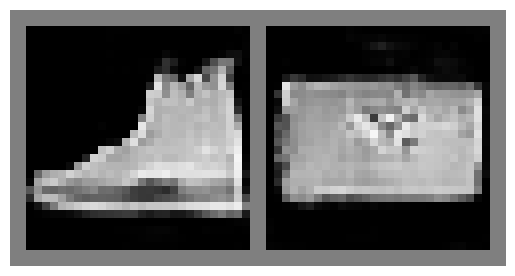

Generated by WGAN:


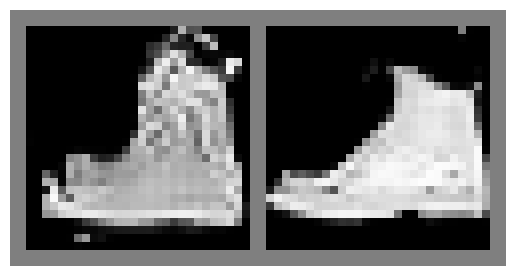

Real Images, Label: 0


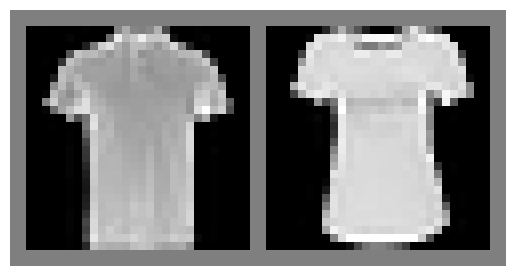

Real Images, Label: 1


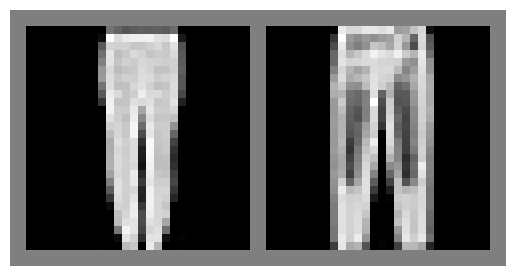

Real Images, Label: 2


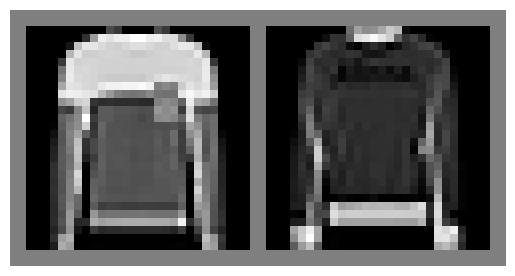

Real Images, Label: 3


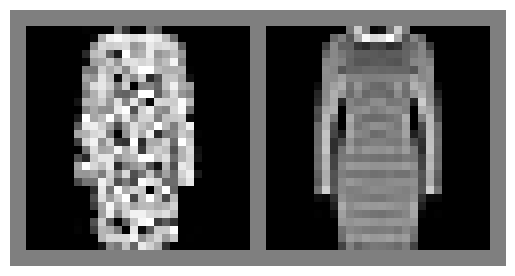

Real Images, Label: 4


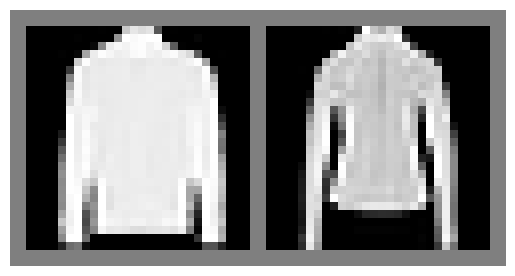

Real Images, Label: 5


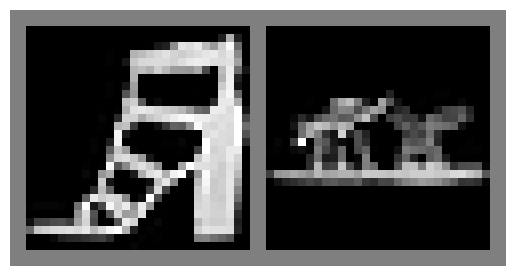

Real Images, Label: 6


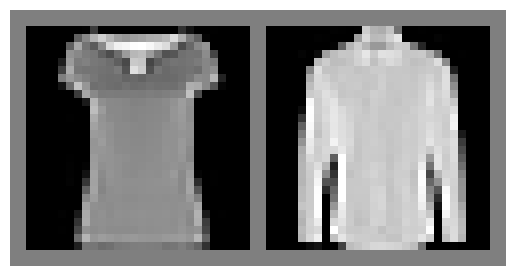

Real Images, Label: 7


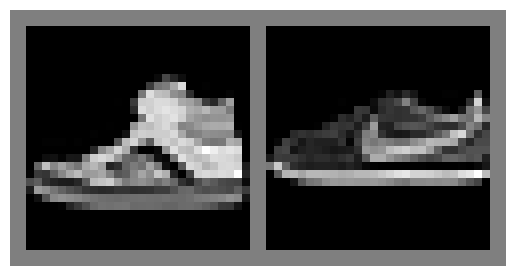

Real Images, Label: 8


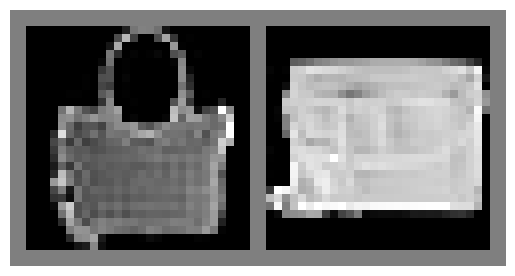

Real Images, Label: 9


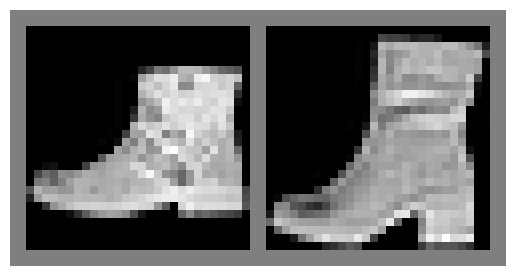

In [50]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])
# Loading the dataset
dataset = FashionMNIST(root='./data', train=False, download=True, transform=transform)

# DataLoader with batch_size=1 to iterate images one by one
loader = DataLoader(dataset, batch_size=1, shuffle=True)

# Initialize a dictionary to store images for each label
label_images = {i: [] for i in range(10)}  # 10 labels in FashionMNIST

# Number of images to collect for each label
images_per_label = 2

for image, label in loader:
    label = label.item()  # Convert label tensor to int
    if len(label_images[label]) < images_per_label:
        label_images[label].append(image)

    # Check if we have collected enough images for each label
    if all(len(images) == images_per_label for images in label_images.values()):
        break

with torch.no_grad():
    noise = torch.randn(2, 100, 1, 1, device=device)  # Generate 2 images each
    dcgan_imgs = dcgan_generator(noise)
    wgan_imgs = wgan_generator(noise)

# Display function
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()

# Display Generated Images by DCGAN and WGAN
print("Generated by DCGAN:")
imshow(torchvision.utils.make_grid(dcgan_imgs.cpu(), nrow=2))
print("Generated by WGAN:")
imshow(torchvision.utils.make_grid(wgan_imgs.cpu(), nrow=2))


for label, images in label_images.items():
    print(f"Real Images, Label: {label}")
    imshow(torchvision.utils.make_grid(torch.cat(images, dim=0), nrow=images_per_label))